In [8]:
library(ggplot2)
library(dplyr)
library(paletteer)
library(ggpubr)

library(RColorBrewer)
library(scales)
library(pals)

In [9]:
source("~/public/SiyuanLuo/projects/benchmark/scripts/evaluation/lib_metrics.R")
source("~/public/SiyuanLuo/projects/benchmark/scripts/clustering/lib_clustering.R")

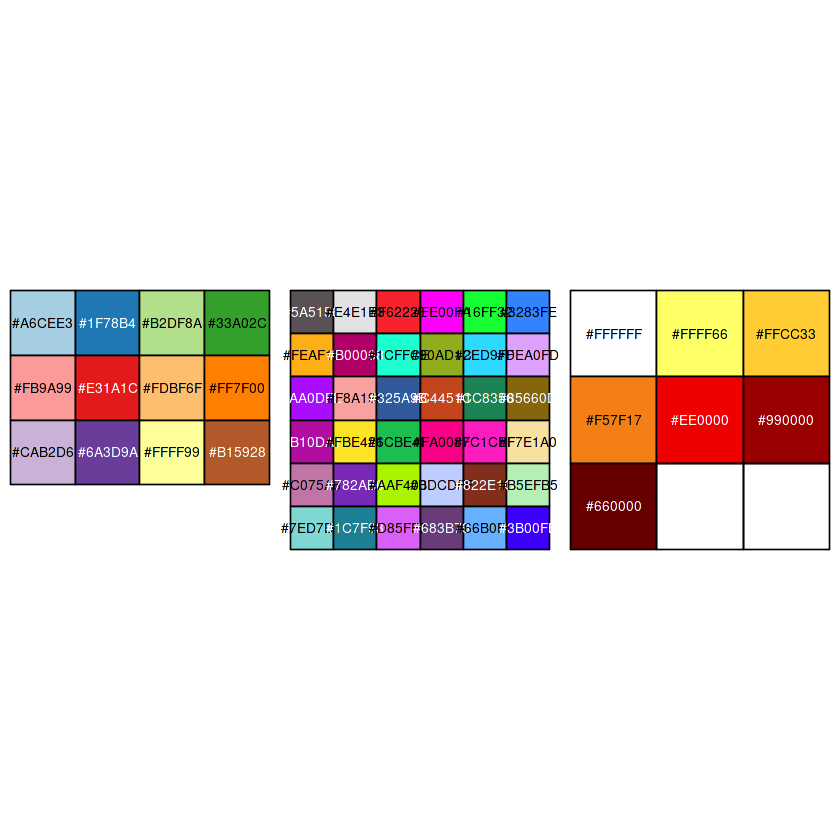

In [10]:
par(mfrow=c(1,3))
# method color
my_col_m <- brewer.pal(12, "Paired")
show_col(my_col_m)
# cell type color
my_col_c <- unlist(polychrome())
show_col(my_col_c)

my_color <- c("#FFFFFF","#FFFF66","#FFCC33","#F57F17","#EE0000","#990000","#660000")
show_col(my_color)

In [11]:
dataset_ls <- c("Buenrostro_2018", "candidate1", "Cell_line_mixing", "Chen_2019",  "PBMC_multiomics", "candidate2") #"Ma_2019",
k_ls <- c(9, 13, 10, 13, 15, 10)

In [12]:
cross_table_plot <- function(ground_truth, clusterings, a=1.3, b=5.7, c=2){
    x <- unique(ground_truth)
    y <- as.factor(unique(clusterings))
    data <- expand.grid(X=x, Y=y)
    cross_count <- table(ground_truth, clusterings) 

    # cell count in the cross_count table
    data$Z1 <- apply(data, 1, function(x){cross_count[x[["X"]],as.numeric(x[["Y"]])]})
    # log transform Z1
    data$Z2 <- apply(data, 1, function(x){log(cross_count[x[["X"]],as.numeric(x[["Y"]])]+1)})
    # row normalize of Z1
    data <- data %>% group_by(X) %>% mutate(Z3 = 100*Z1/sum(Z1))

    top_cluster <- data %>% group_by(X) %>% top_n(1, Z1)

    unselected_Y <- setdiff(unique(data$Y), unique(top_cluster$Y))
    top_cluster <- top_cluster[order(top_cluster$X),]
    new_levels <- as.numeric(c(as.character(unique(top_cluster$Y)),unselected_Y))
    data$Y <- factor(data$Y, levels=new_levels)

    res <- adjusted_wallance_indices(ground_truth, clusterings)

    df_awi <- do.call(rbind, Map(data.frame, "awi"=res$Awi))
    df_awi$cell_type <- levels(ground_truth)

    df_avj <- do.call(rbind, Map(data.frame, "avj"=res$Avj))
    df_avj$cell_type <- levels(clusterings)
    df_avj$cell_type <- factor(df_avj$cell_type, levels=new_levels)


    main <- ggplot(data, aes(Y, X, fill= Z3)) + 
    geom_tile(colour="black", size=0.1) + 
    scale_fill_gradientn(colours = my_color, breaks=seq(0,100,10), guide = guide_colourbar()) +
    labs(x="ATAC cluster", y="RNA cluster", fill = "Cells per RNA cluster %") + 
    theme(legend.direction = "horizontal", 
        legend.position = "bottom", 
        legend.key.width= unit(a, 'cm'),
        legend.text=element_text(size=12)) + 
    theme(plot.margin = unit(c(0, 0, 0, 1), "cm"),
        panel.background = element_blank(),
        axis.title.x = element_text(size = 15, margin = margin(5,0,0,0)), 
        axis.text.x = element_text(size = 12),
        axis.title.y = element_text(size = 15, margin = margin(0,0,0,0)), 
        axis.text.y = element_text(size = 12),)

    bp.x <- ggplot(data = df_avj, aes(x = cell_type, y = avj)) + 
    geom_bar(stat = "identity") + 
    theme(
        axis.title.x = element_blank(), 
        axis.text.x = element_blank(), 
        axis.ticks.x = element_blank(), 
        axis.text.y = element_text(size=12), 
        axis.title.y = element_text(size = 15, margin = margin(10,5,0,0)),
        legend.position = "none",
        panel.background = element_blank()) + 
    labs(y = "Homogeneity")+ theme(plot.margin = unit(c(0, 0, 0, b), "cm"))

    bp.y <- ggplot(data = df_awi, aes(x = cell_type, y = awi)) + 
    geom_bar(stat = "identity") + coord_flip() + # theme_ipsum() + #theme_gray() +
    theme(axis.title.x = element_text(size = 15, margin = margin(5,5,0,0)), 
          axis.text.x = element_text(size = 12),
          axis.text.y = element_blank(), 
          axis.title.y = element_blank(), 
          axis.ticks.y = element_blank(), 
          legend.position="none",
          panel.background = element_blank()) + 
    labs(y="Completemess")+ theme(plot.margin = unit(c(0, 0, c, 0), "cm"))

    df_hm <- data.frame(cols = numeric(0), value = numeric(0))

    gg_empty <- df_hm %>% 
    ggplot(aes(x = cols, y = value)) +
    geom_blank() +
    theme(axis.text = element_blank(),
            axis.title = element_blank(),
            line = element_blank(),
            panel.background = element_blank()) + 
            geom_text(aes(label = paste0("ARI = ", round(res$ARI,3), "\n", "ARI2 = ", round(res$ARI2,3))), x = 0.5, y = 0.5)

    plot <- ggarrange(
    bp.x, gg_empty, main, bp.y,
    nrow = 2, ncol = 2, widths = c(3, 1), heights = c(1, 3)
    )

    return(plot)
}

# candidate2

In [13]:
j <- 6
n <- 15

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)
df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [14]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]
df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)



## Signac

In [15]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.990 Signac Signac_b… by_clu…       0 default    15   0.225
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


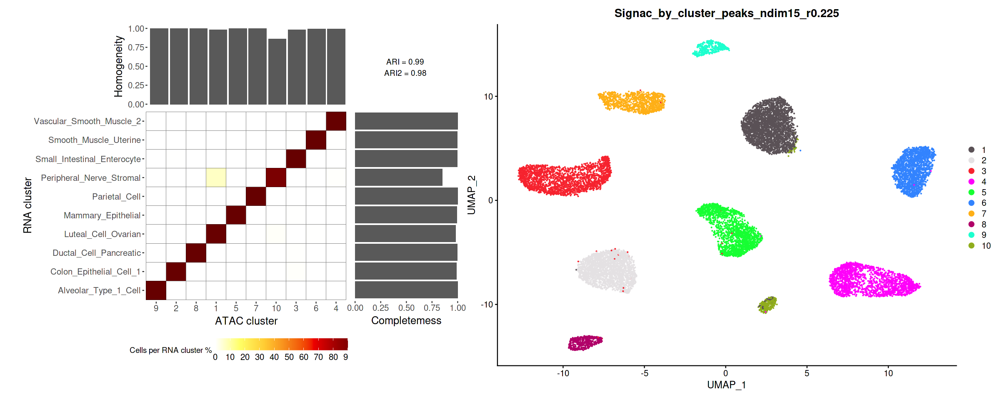

In [16]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## ArchR

In [17]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          9 ARI    0.940 ArchR  ArchR_pe… peaks       500 default    15     0.1
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


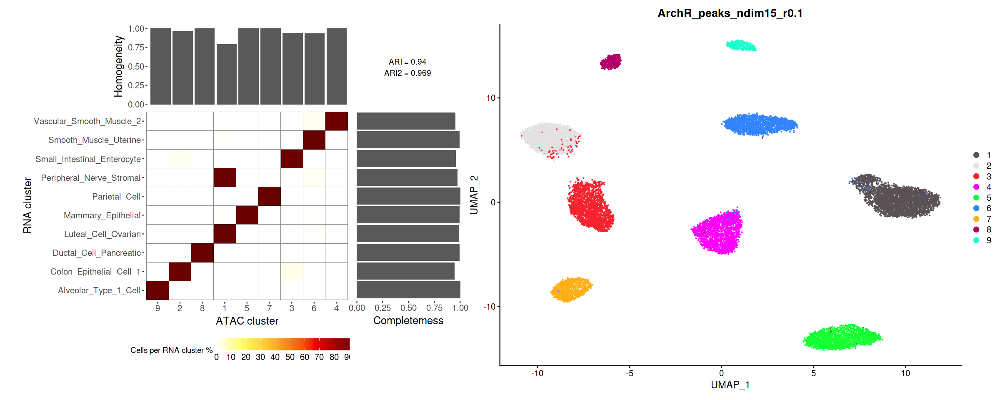

In [18]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [19]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
8,ARI,0.8026046,ArchR,ArchR_peaks,peaks,500,default,15,0.050,candidate2/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.05.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
8,ARI,0.8026046,ArchR,ArchR_peaks,peaks,500,default,15,0.075,candidate2/evaluation/ArchR/peaks/500/default/15/r0.075_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.075.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
9,ARI,0.9403042,ArchR,ArchR_peaks,peaks,500,default,15,0.100,candidate2/evaluation/ArchR/peaks/500/default/15/r0.1_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.1.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,1
10,ARI,0.8785946,ArchR,ArchR_peaks,peaks,500,default,15,0.200,candidate2/evaluation/ArchR/peaks/500/default/15/r0.2_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.2.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,0
10,ARI,0.8785946,ArchR,ArchR_peaks,peaks,500,default,15,0.225,candidate2/evaluation/ArchR/peaks/500/default/15/r0.225_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.225.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,0
11,ARI,0.8020248,ArchR,ArchR_peaks,peaks,500,default,15,0.250,candidate2/evaluation/ArchR/peaks/500/default/15/r0.25_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.25.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,1
13,ARI,0.7587127,ArchR,ArchR_peaks,peaks,500,default,15,0.300,candidate2/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.3.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,3
14,ARI,0.7226085,ArchR,ArchR_peaks,peaks,500,default,15,0.325,candidate2/evaluation/ArchR/peaks/500/default/15/r0.325_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.325.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,4
15,ARI,0.6709310,ArchR,ArchR_peaks,peaks,500,default,15,0.350,candidate2/evaluation/ArchR/peaks/500/default/15/r0.35_evaluation.RDS,candidate2/clustering/ArchR/peaks/500/default/15/r0.35.tsv,candidate2/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,5


In [20]:
i <- 6
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.802 ArchR  ArchR_pe… peaks       500 default    15    0.25
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


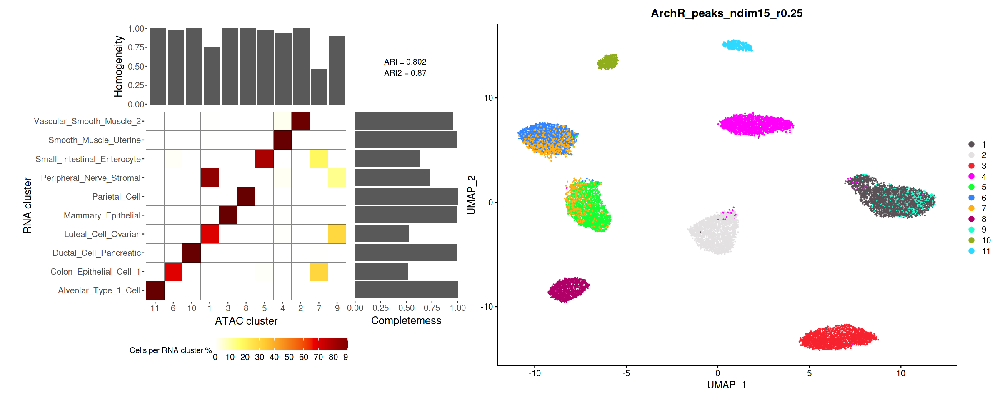

In [21]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

# candidate1

In [6]:
j <- 2
n <- 15

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

In [7]:
df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [54]:
df_tmp <- df_metrics_selected
df_tmp$dataset <- dataset
df_metrics_all <- df_tmp

In [55]:
dim(df)
dim(df_metrics)
dim(df_metrics_external)

[1] 480  15

[1] 6240   13

[1] 1080   13

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


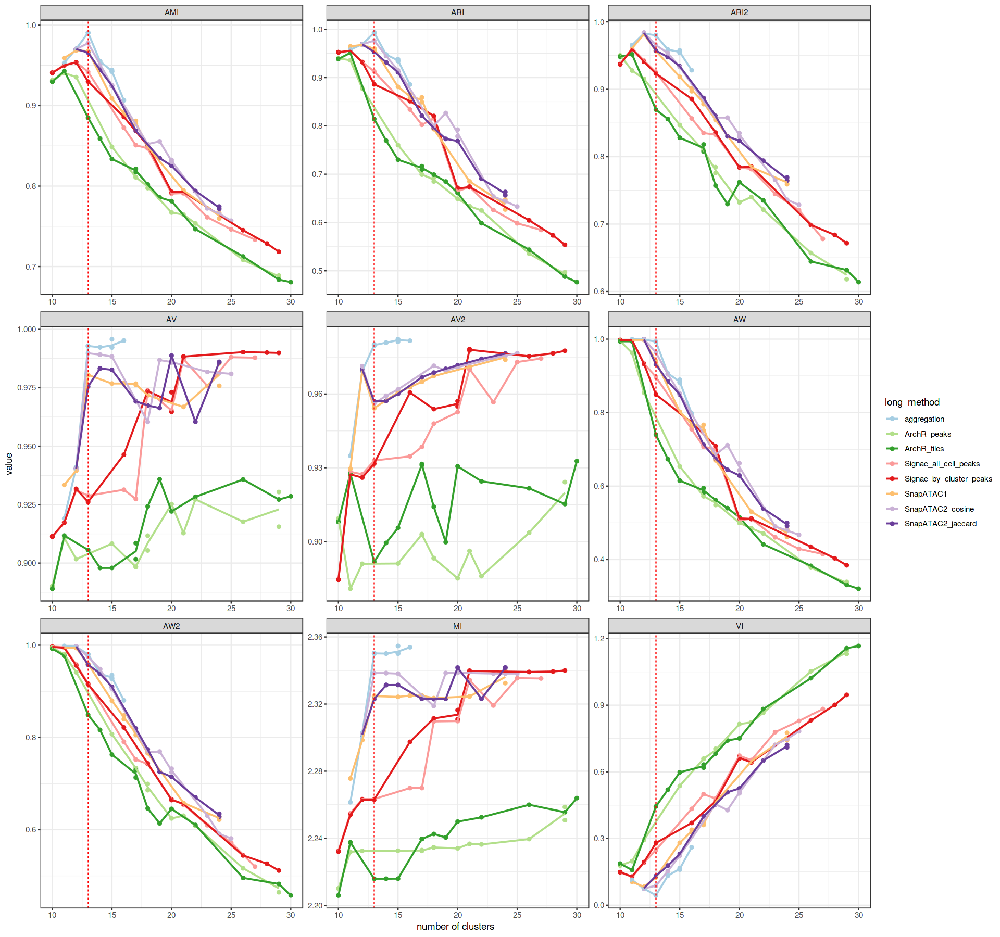

In [8]:
options(repr.plot.width=16, repr.plot.height=15)

# line plot (fix ndim=50)
p2 <-
df_metrics_external %>% #filter(n_clusters <= 30) %>% #filter(grepl(n,ndim)) %>%
  group_by(long_method, metric, n_clusters) %>%
  mutate(mean_value = mean(value)) %>%
  ggplot(aes(x=n_clusters, y=value, color=long_method)) + 
  geom_point(size=1.5) +
  geom_line(size=0.8, aes(x=n_clusters, y=mean_value, color=long_method)) + 
  facet_wrap(~metric, scales = "free") + 
  xlab("number of clusters") +
  ylab("value") +
  geom_vline(xintercept=k_optimal, color = "red", linetype = "dashed") +
  theme_bw() +
  # geom_errorbar(aes(ymin = min_value, ymax = max_value), width = 0.2, linetype = "dashed") +
  scale_colour_manual(values = brewer.pal(10, "Paired")[c(1,3:6,7,9:10)])
p2

## Cross table

**For each method, look into the best performing situations and the n_cluster=k_optimal situations**

In [8]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]

In [9]:
df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)

In [10]:
df_optimal_k <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(n_clusters_d == min(n_clusters_d)) %>% filter(value == max(value)) %>%
  ungroup()


In [11]:
df_method <- df_best
df_method

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9556933,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.15,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.15_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.15.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9555852,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.20,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.2_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.2.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
10,ARI,0.9397695,ArchR,ArchR_peaks,peaks,500,default,15,0.05,candidate1/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.05.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
11,ARI,0.9510676,ArchR,ArchR_tiles,tiles,500,default,15,0.15,candidate1/evaluation/ArchR/tiles/500/default/15/r0.15_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.15.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
12,ARI,0.9678846,SnapATAC1,SnapATAC1,default,5000,default,15,0.10,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.1_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.1.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS
13,ARI,0.9930640,aggregation,aggregation,default,0,default,15,0.35,candidate1/evaluation/aggregation/default/0/default/15/r0.35_evaluation.RDS,candidate1/clustering/aggregation/default/0/default/15/r0.35.tsv,candidate1/clustering/aggregation/default/0/default/15/sobj_SNN.RDS
12,ARI,0.9687631,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.05,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.05_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.05.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS
13,ARI,0.9765607,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.25,candidate1/evaluation/SnapATAC2/default/500/cosine/15/r0.25_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/cosine/15/r0.25.tsv,candidate1/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS


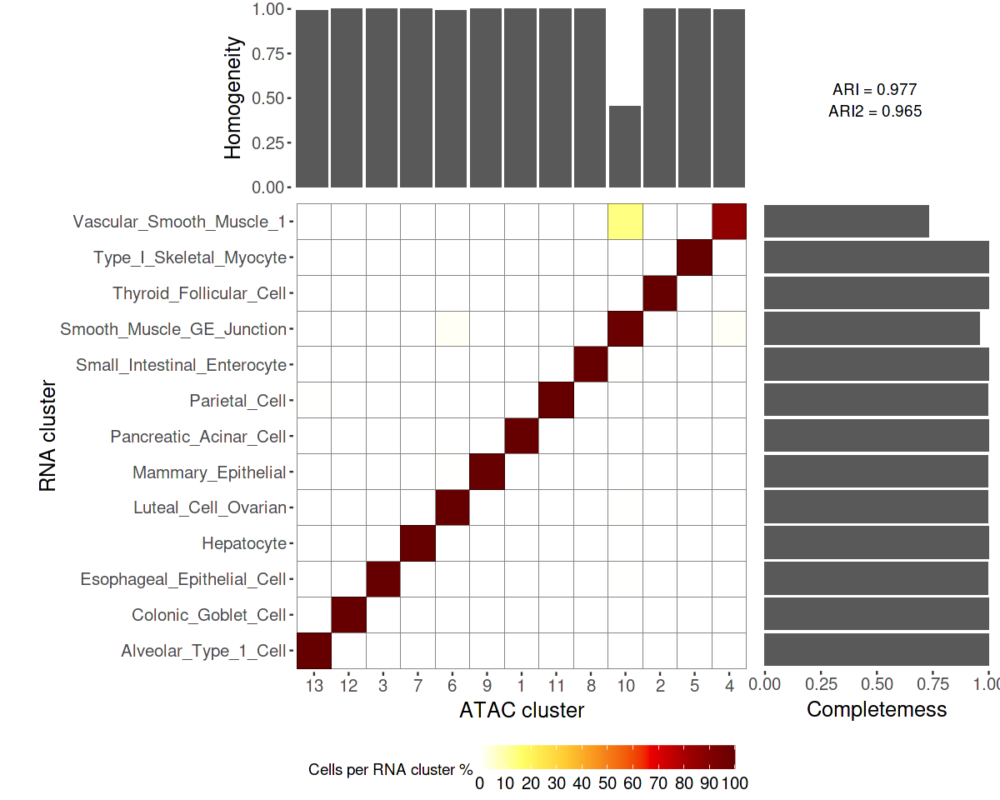

In [61]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=10, repr.plot.height=8)

i <- 8
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

cross_table_plot(ground_truth, clusterings, a=1.3, b=5.7, c=2)

In [12]:
df_best

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9556933,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.15,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.15_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.15.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9555852,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.20,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.2_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.2.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
10,ARI,0.9397695,ArchR,ArchR_peaks,peaks,500,default,15,0.05,candidate1/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.05.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
11,ARI,0.9510676,ArchR,ArchR_tiles,tiles,500,default,15,0.15,candidate1/evaluation/ArchR/tiles/500/default/15/r0.15_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.15.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
12,ARI,0.9678846,SnapATAC1,SnapATAC1,default,5000,default,15,0.10,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.1_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.1.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS
13,ARI,0.9930640,aggregation,aggregation,default,0,default,15,0.35,candidate1/evaluation/aggregation/default/0/default/15/r0.35_evaluation.RDS,candidate1/clustering/aggregation/default/0/default/15/r0.35.tsv,candidate1/clustering/aggregation/default/0/default/15/sobj_SNN.RDS
12,ARI,0.9687631,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.05,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.05_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.05.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS
13,ARI,0.9765607,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.25,candidate1/evaluation/SnapATAC2/default/500/cosine/15/r0.25_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/cosine/15/r0.25.tsv,candidate1/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS


ndim = 15, because for this dataset, the performance across ndim is quite stable.

## Signac

In [11]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_method     feature_type tile_size distance
       <int> <chr>  <dbl> <chr>  <chr>           <chr>            <int> <chr>   
1         11 ARI    0.956 Signac Signac_all_cel… all_cell_pe…         0 default 
# ℹ 5 more variables: ndim <int>, resolution <dbl>, rds_file <chr>,
#   clustering_file <chr>, snn_file <chr>


Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


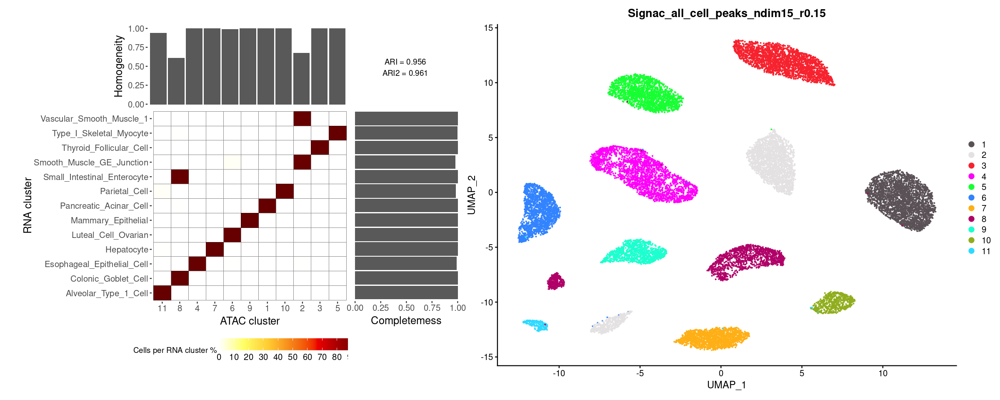

In [12]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [32]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "Signac_all_cell_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9525231,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.05,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.05_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.05.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,3
10,ARI,0.9525231,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.10,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.1_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.1.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,3
11,ARI,0.9556933,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.15,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.15_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.15.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,2
11,ARI,0.9556933,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.20,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.2_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.2.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,2
12,ARI,0.9324966,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.25,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.25_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.25.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,1
13,ARI,0.9125995,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.30,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.3_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.3.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,0
16,ARI,0.8338542,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.35,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.35_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.35.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,3
18,ARI,0.8153938,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.45,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.45_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.45.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,5
20,ARI,0.6647035,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.50,candidate1/evaluation/Signac/all_cell_peaks/0/default/15/r0.5_evaluation.RDS,candidate1/clustering/Signac/all_cell_peaks/0/default/15/r0.5.tsv,candidate1/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,7


In [33]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         12 ARI    0.932 Signac Signac_a… all_ce…       0 default    15    0.25
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


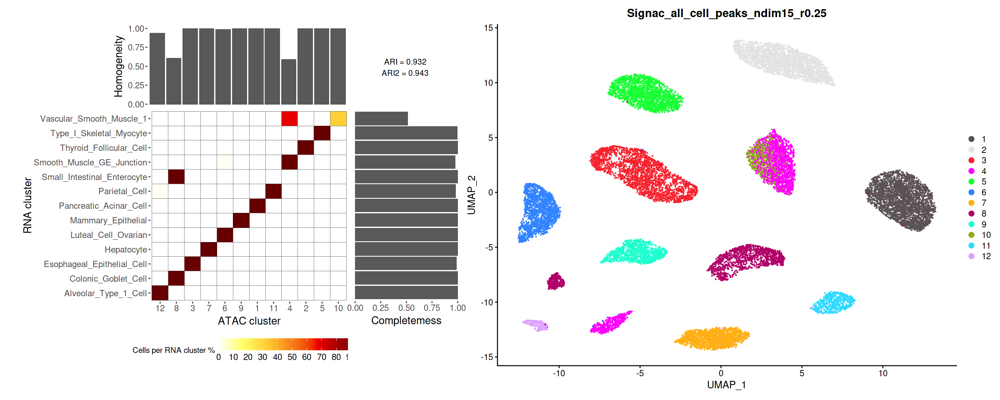

In [35]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [36]:
i <- 9
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         20 ARI    0.665 Signac Signac_a… all_ce…       0 default    15     0.5
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


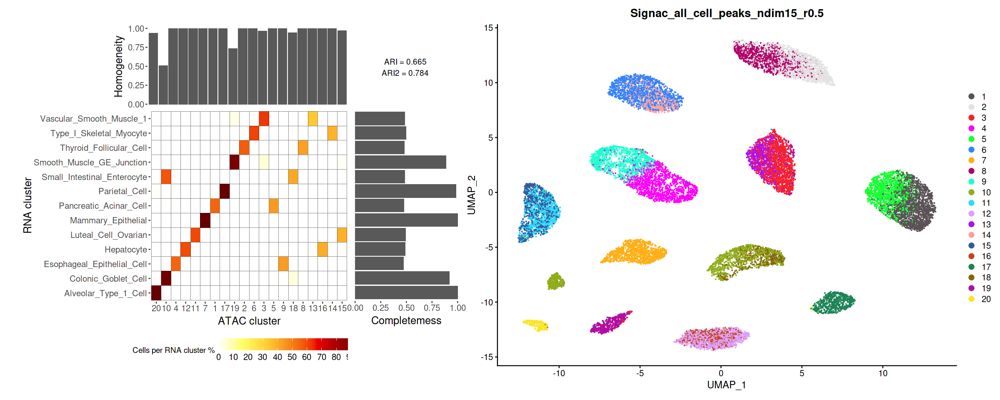

In [37]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

While the UMAP correctly seperate the 13 classes, the clustering doesn't. When increasing the n_cluster, it doesn't always help. It tends to randomly over-cluster major classes instead of seperate colonic+intestinal/two types of smooth muscle.

Signac_by_cluster_peaks

In [13]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "Signac_by_cluster_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9524732,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.05,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.05_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.05.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,3
10,ARI,0.9524732,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.10,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.1_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.1.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,3
10,ARI,0.9524732,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.15,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.15_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.15.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,3
11,ARI,0.9555852,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.20,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.2_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.2.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,2
12,ARI,0.9320496,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.25,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.25_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.25.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,1
13,ARI,0.8860260,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.30,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.3_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.3.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,0
16,ARI,0.8512176,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.35,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.35_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.35.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,3
20,ARI,0.6716671,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.55,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.55_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.55.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,7
28,ARI,0.5733243,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.90,candidate1/evaluation/Signac/by_cluster_peaks/0/default/15/r0.9_evaluation.RDS,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/r0.9.tsv,candidate1/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,15


In [14]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_method     feature_type tile_size distance
       <int> <chr>  <dbl> <chr>  <chr>           <chr>            <int> <chr>   
1         11 ARI    0.956 Signac Signac_by_clus… by_cluster_…         0 default 
# ℹ 6 more variables: ndim <int>, resolution <dbl>, rds_file <chr>,
#   clustering_file <chr>, snn_file <chr>, n_clusters_d <dbl>


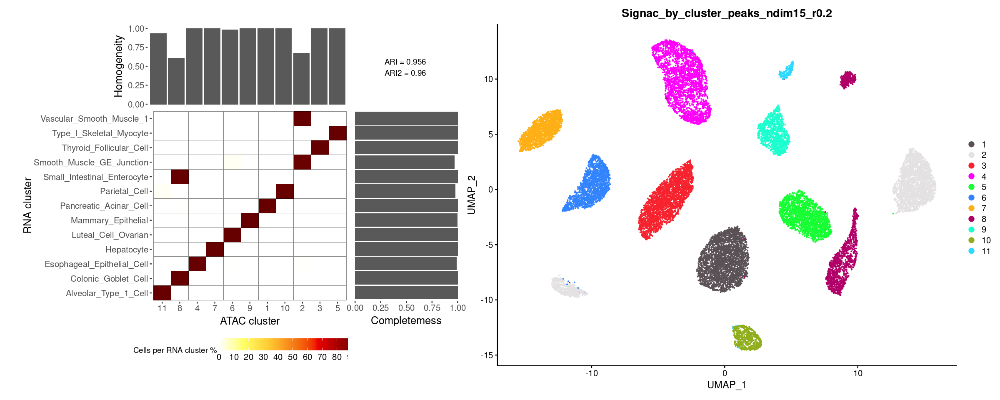

In [15]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

Similar for Signac_by_cluster_peaks

## ArchR

In [38]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.940 ArchR  ArchR_pe… peaks       500 default    15    0.05
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


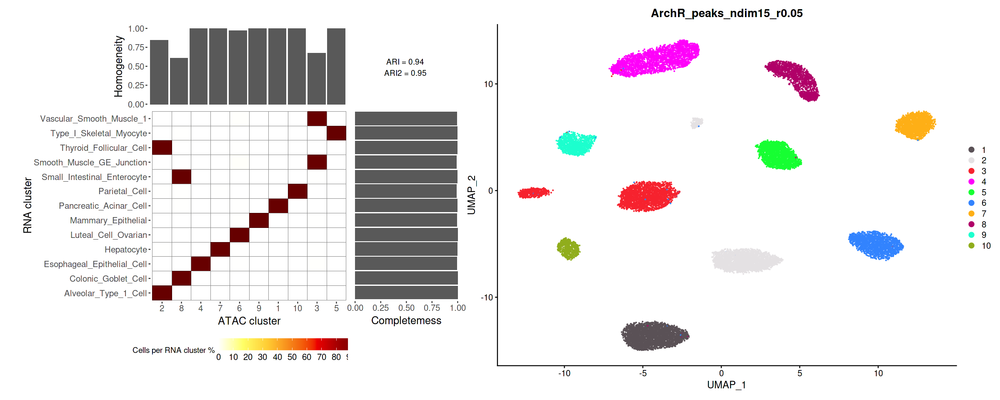

In [39]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [40]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9397695,ArchR,ArchR_peaks,peaks,500,default,15,0.05,candidate1/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.05.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,3
10,ARI,0.9397695,ArchR,ArchR_peaks,peaks,500,default,15,0.10,candidate1/evaluation/ArchR/peaks/500/default/15/r0.1_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.1.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,3
11,ARI,0.9359269,ArchR,ArchR_peaks,peaks,500,default,15,0.15,candidate1/evaluation/ArchR/peaks/500/default/15/r0.15_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.15.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
12,ARI,0.8774016,ArchR,ArchR_peaks,peaks,500,default,15,0.20,candidate1/evaluation/ArchR/peaks/500/default/15/r0.2_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.2.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,1
15,ARI,0.7602852,ArchR,ArchR_peaks,peaks,500,default,15,0.25,candidate1/evaluation/ArchR/peaks/500/default/15/r0.25_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.25.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
17,ARI,0.6994751,ArchR,ArchR_peaks,peaks,500,default,15,0.30,candidate1/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.3.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,4
20,ARI,0.6491359,ArchR,ArchR_peaks,peaks,500,default,15,0.45,candidate1/evaluation/ArchR/peaks/500/default/15/r0.45_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.45.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,7
21,ARI,0.6336403,ArchR,ArchR_peaks,peaks,500,default,15,0.55,candidate1/evaluation/ArchR/peaks/500/default/15/r0.55_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.55.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,8
29,ARI,0.4971516,ArchR,ArchR_peaks,peaks,500,default,15,0.90,candidate1/evaluation/ArchR/peaks/500/default/15/r0.9_evaluation.RDS,candidate1/clustering/ArchR/peaks/500/default/15/r0.9.tsv,candidate1/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,16


In [41]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         15 ARI    0.760 ArchR  ArchR_pe… peaks       500 default    15    0.25
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


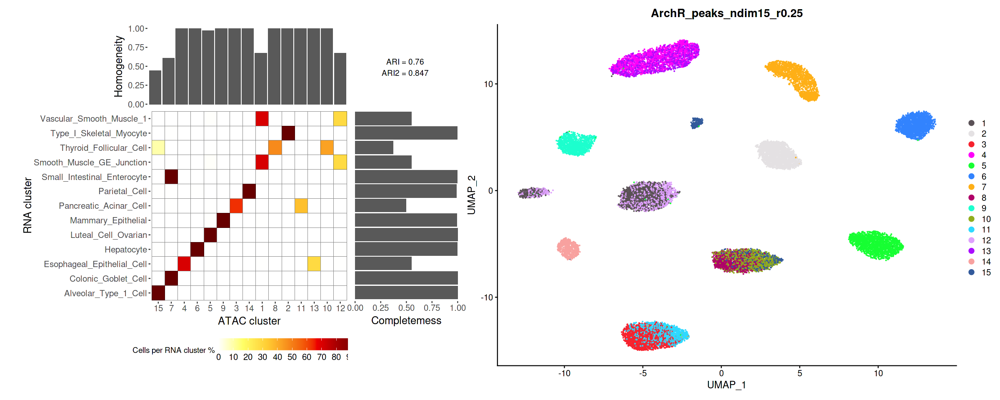

In [42]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [16]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_tiles") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9386315,ArchR,ArchR_tiles,tiles,500,default,15,0.05,candidate1/evaluation/ArchR/tiles/500/default/15/r0.05_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.05.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,3
10,ARI,0.9386315,ArchR,ArchR_tiles,tiles,500,default,15,0.10,candidate1/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.1.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,3
11,ARI,0.9510676,ArchR,ArchR_tiles,tiles,500,default,15,0.15,candidate1/evaluation/ArchR/tiles/500/default/15/r0.15_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.15.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
13,ARI,0.8143376,ArchR,ArchR_tiles,tiles,500,default,15,0.20,candidate1/evaluation/ArchR/tiles/500/default/15/r0.2_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.2.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,0
14,ARI,0.7696539,ArchR,ArchR_tiles,tiles,500,default,15,0.25,candidate1/evaluation/ArchR/tiles/500/default/15/r0.25_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.25.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,1
15,ARI,0.7299782,ArchR,ArchR_tiles,tiles,500,default,15,0.30,candidate1/evaluation/ArchR/tiles/500/default/15/r0.3_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.3.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
19,ARI,0.6848250,ArchR,ArchR_tiles,tiles,500,default,15,0.45,candidate1/evaluation/ArchR/tiles/500/default/15/r0.45_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.45.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,6
18,ARI,0.6990774,ArchR,ArchR_tiles,tiles,500,default,15,0.50,candidate1/evaluation/ArchR/tiles/500/default/15/r0.5_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.5.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,5
20,ARI,0.6610747,ArchR,ArchR_tiles,tiles,500,default,15,0.55,candidate1/evaluation/ArchR/tiles/500/default/15/r0.55_evaluation.RDS,candidate1/clustering/ArchR/tiles/500/default/15/r0.55.tsv,candidate1/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,7


In [17]:
i <- 3
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 14
  n_clusters metric value method long_method feature_type tile_size distance
       <int> <chr>  <dbl> <chr>  <chr>       <chr>            <int> <chr>   
1         11 ARI    0.951 ArchR  ArchR_tiles tiles              500 default 
# ℹ 6 more variables: ndim <int>, resolution <dbl>, rds_file <chr>,
#   clustering_file <chr>, snn_file <chr>, n_clusters_d <dbl>


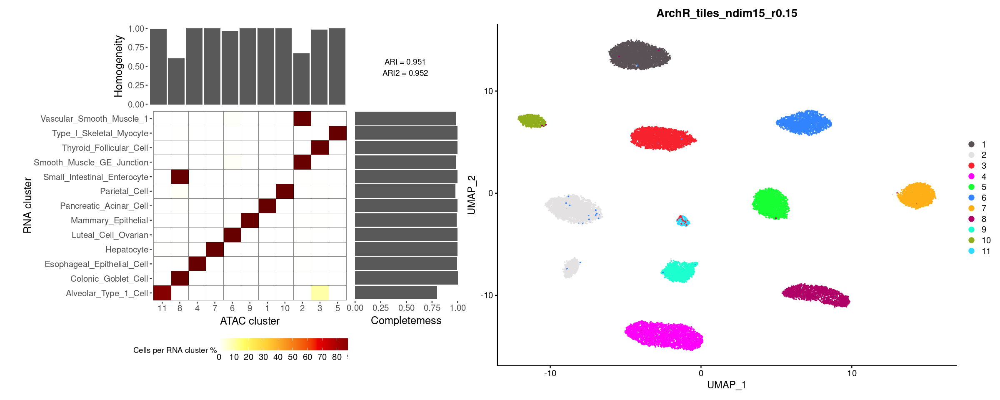

In [18]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

For ArchR: Alveolar+Thyroid cells, colonic+intestinal cells and two types of smooth muscle cells are not seperated in clustering, and colonic+intestinal are not seperated even in the UMAP. Increasing n_clusters doesn't help.

Does this have something to do with the small fraction of colonic, alveolar and smooth muscle GE cells? How to check this?

## Aggregation

In [14]:
i <- 6
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.993 aggrega… aggreg… default       0 default    15    0.35
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


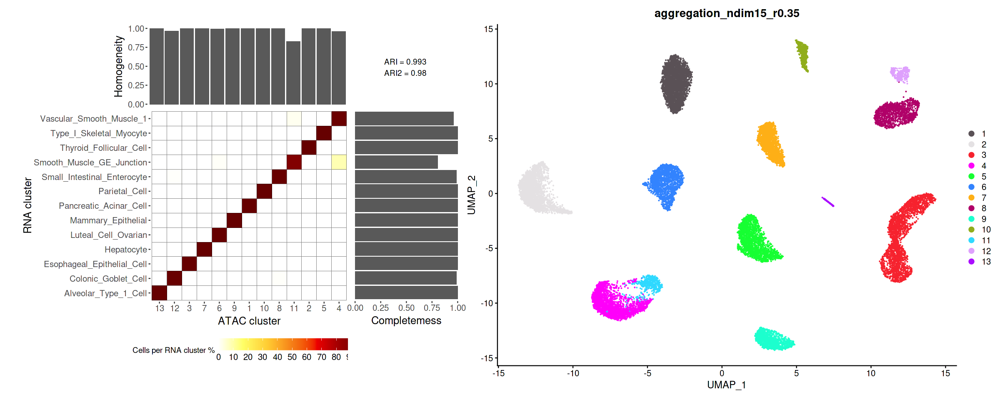

In [15]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

The aggregation method performs nearly perfect for this dataset.

## SnapATAC1

In [43]:
i <- 5
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         12 ARI    0.968 SnapATA… SnapAT… default    5000 default    15     0.1
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


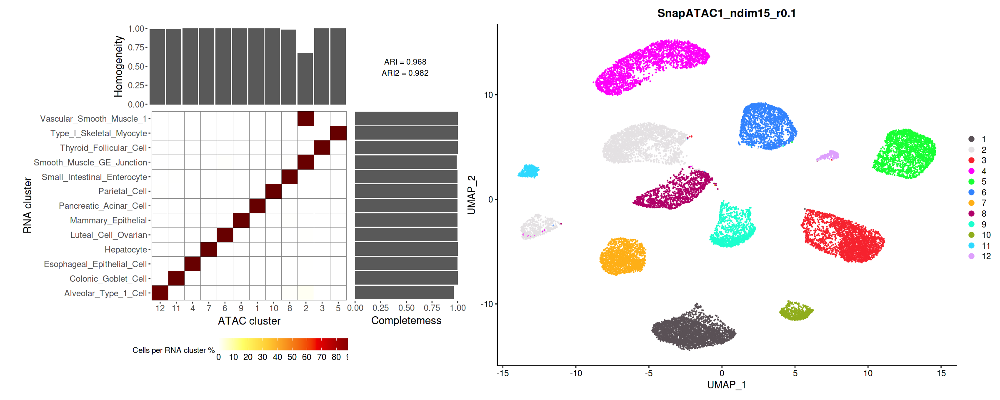

In [44]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [45]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC1") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
11,ARI,0.9646416,SnapATAC1,SnapATAC1,default,5000,default,15,0.05,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.05_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.05.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,2
12,ARI,0.9678846,SnapATAC1,SnapATAC1,default,5000,default,15,0.10,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.1_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.1.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,1
12,ARI,0.9678846,SnapATAC1,SnapATAC1,default,5000,default,15,0.15,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,1
13,ARI,0.9596295,SnapATAC1,SnapATAC1,default,5000,default,15,0.30,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.3_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.3.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,0
15,ARI,0.8808412,SnapATAC1,SnapATAC1,default,5000,default,15,0.35,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.35_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.35.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,2
17,ARI,0.8590008,SnapATAC1,SnapATAC1,default,5000,default,15,0.50,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.5_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.5.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,4
24,ARI,0.6474603,SnapATAC1,SnapATAC1,default,5000,default,15,0.90,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.9_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.9.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,11
16,ARI,0.8650663,SnapATAC1,SnapATAC1,default,5000,default,15,0.40,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.4_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.4.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,3
18,ARI,0.7932277,SnapATAC1,SnapATAC1,default,5000,default,15,0.60,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.6_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.6.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,5


In [48]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.960 SnapATA… SnapAT… default    5000 default    15     0.3
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


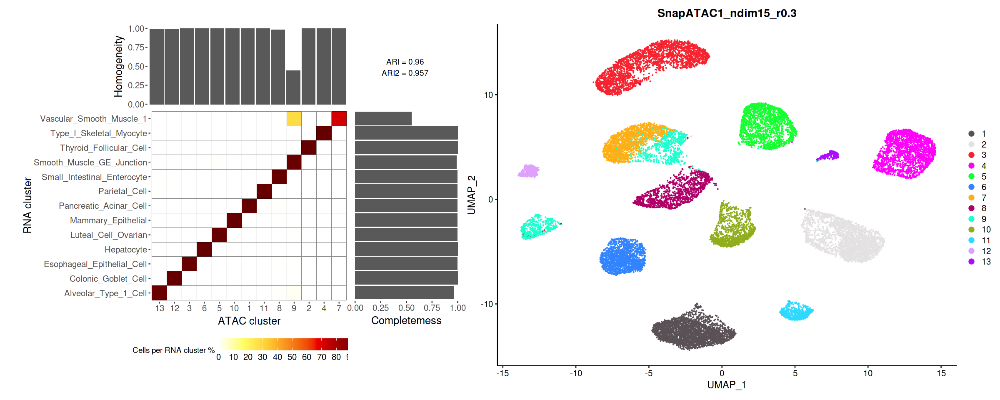

In [49]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [46]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         15 ARI    0.881 SnapATA… SnapAT… default    5000 default    15    0.35
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


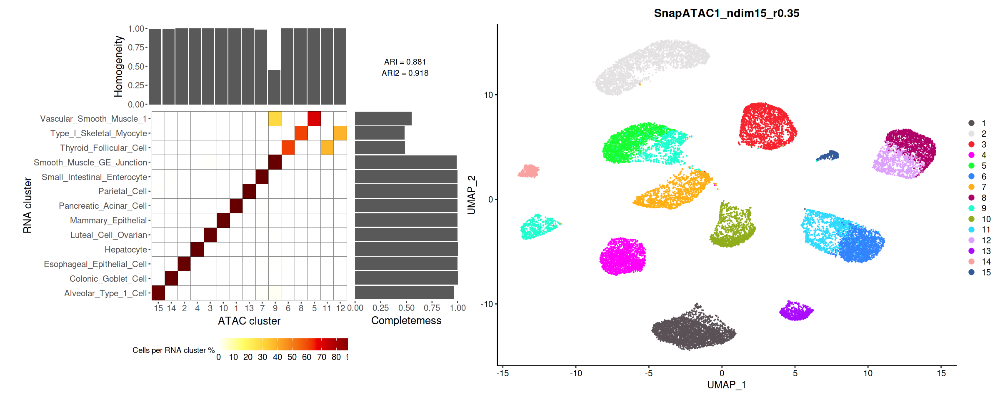

In [47]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

The SnapATAC1 failed to seperate two types of smooth muscle cells in clustering, but the UMAP seperates them two. When increasing n_cluster, it cannot seperate them.

## SnapATAC2

In [50]:
i <- 7
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_jaccard"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         12 ARI    0.969 SnapATA… SnapAT… default     500 jaccard    15    0.05
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


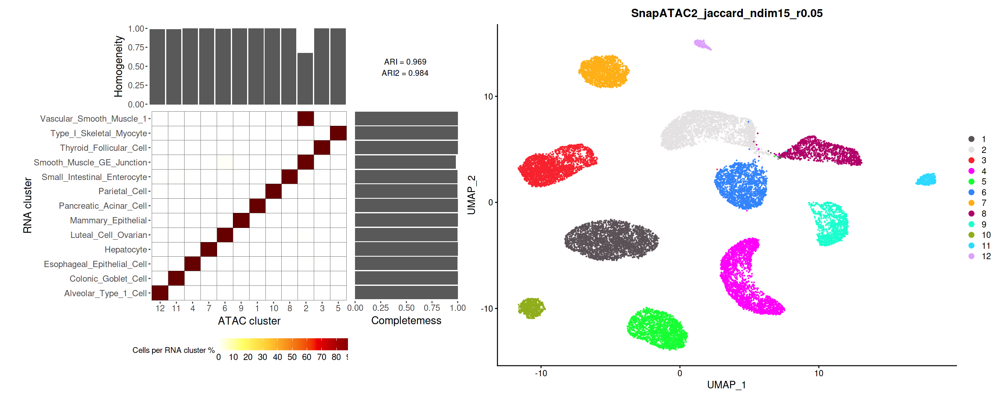

In [51]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [52]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC2_jaccard") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
12,ARI,0.9687631,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.05,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.05_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.05.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,1
13,ARI,0.9530541,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.25,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.25_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.25.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,0
14,ARI,0.9317735,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.35,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.35_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.35.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,1
17,ARI,0.8211187,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.45,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.45_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.45.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,4
18,ARI,0.7953580,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.50,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.5_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.5.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,5
19,ARI,0.7731619,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.55,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.55_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.55.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,6
15,ARI,0.9110824,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.40,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.4_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.4.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,2
20,ARI,0.7687478,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.60,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.6_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.6.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,7
22,ARI,0.6905291,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.80,candidate1/evaluation/SnapATAC2/default/500/jaccard/15/r0.8_evaluation.RDS,candidate1/clustering/SnapATAC2/default/500/jaccard/15/r0.8.tsv,candidate1/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,9


In [53]:
i <- 2
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_jaccard"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.953 SnapATA… SnapAT… default     500 jaccard    15    0.25
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


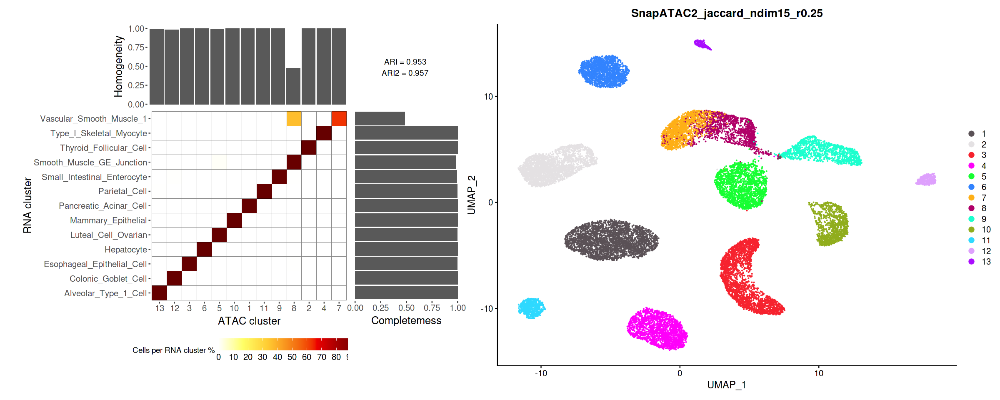

In [54]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

The SnapATAC2_jaccard also failed to seperate two types of smooth muscle cells in clustering, and the UMAP also fails to seperate them two. When increasing n_cluster, it cannot be improved. Smooth muscle GE junction is a very small class. Does this has something to do with it?

In [12]:
i <- 8
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_cosine"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.977 SnapATA… SnapAT… default     500 cosine     15    0.25
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


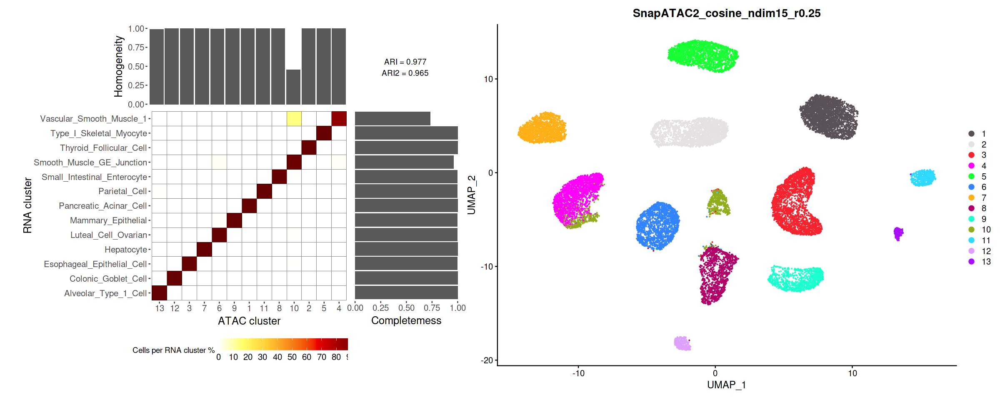

In [13]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

The SnapATAC_cosine seperate these two classes well both in clustering and in UMAP.

In [62]:
# options(repr.plot.width=8, repr.plot.height=8)

fig.path <- "figures/best_ARI/"
dir.create("figures/")
dir.create("figures/best_ARI/")

for (i in 1:dim(df_best)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)

    at <- paste0("resolution = ", df_method$resolution[i])
    bt <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=10,height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,at, pos=4)
    text(1,3,bt, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”
Warning message in dir.create("figures/best_ARI/"):
“'figures/best_ARI' already exists”


In [ ]:
df_method <- df_optimal_k

In [ ]:
fig.path <- "figures/optimal_k/"
dir.create("figures/")
dir.create("figures/optimal_k/")

options(repr.plot.width=8, repr.plot.height=8)

for (i in 1:dim(df_method)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)
    a <- paste0("resolution = ", df_method$resolution[i])
    b <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8,height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,a, pos=4)
    text(1,3,b, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”


[1] "Signac_all_cell_peaks"
[1] "Signac_by_cluster_peaks"
[1] "ArchR_peaks"
[1] "ArchR_tiles"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


# Chen_2019

In [6]:
j <- 4
n <- 15

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [ ]:
df_tmp <- df_metrics_selected
df_tmp$dataset <- dataset
df_metrics_all <- rbind(df_metrics_all, df_tmp)

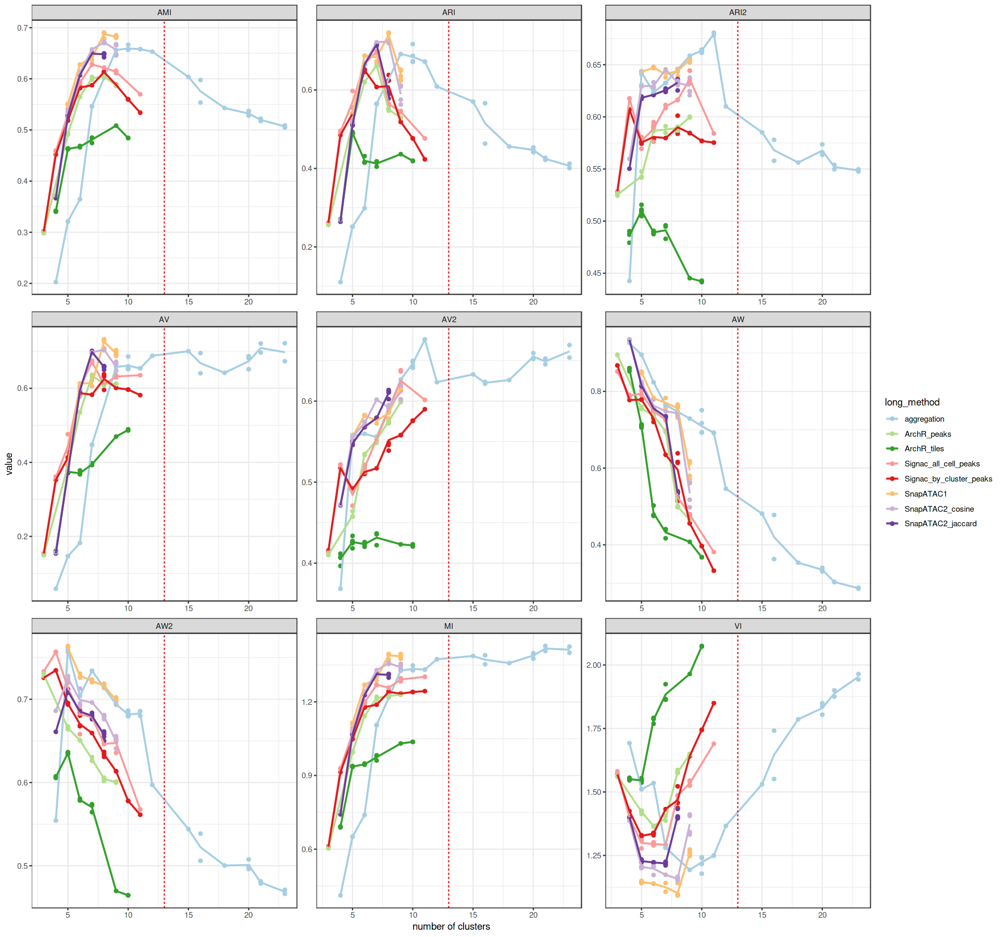

In [ ]:
options(repr.plot.width=16, repr.plot.height=15)

# line plot (fix ndim=50)
p2 <-
df_metrics_external %>% #filter(n_clusters <= 30) %>% #filter(grepl(n,ndim)) %>%
  group_by(long_method, metric, n_clusters) %>%
  mutate(mean_value = mean(value)) %>%
  ggplot(aes(x=n_clusters, y=value, color=long_method)) + 
  geom_point(size=1.5) +
  geom_line(size=0.8, aes(x=n_clusters, y=mean_value, color=long_method)) + 
  facet_wrap(~metric, scales = "free") + 
  xlab("number of clusters") +
  ylab("value") +
  geom_vline(xintercept=k_optimal, color = "red", linetype = "dashed") +
  theme_bw() +
  # geom_errorbar(aes(ymin = min_value, ymax = max_value), width = 0.2, linetype = "dashed") +
  scale_colour_manual(values = brewer.pal(10, "Paired")[c(1,3:6,7,9:10)])
p2

In [7]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]

df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)

df_optimal_k <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(n_clusters_d == min(n_clusters_d)) %>% filter(value == max(value)) %>%
  ungroup()


In [ ]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


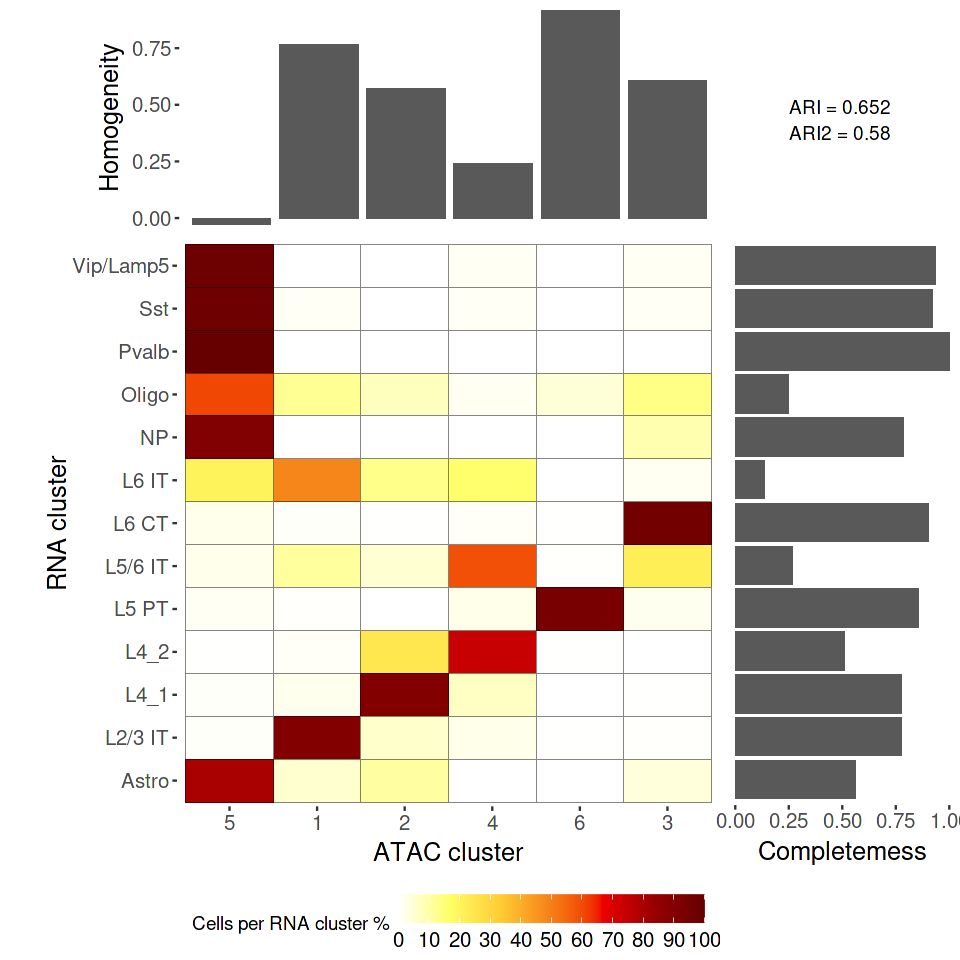

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
cross_table_plot(ground_truth, clusterings, a=1.3, b=2.1, c=2)

## Signac

In [12]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          6 ARI    0.652 Signac Signac_b… by_clu…       0 default    15     0.4
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


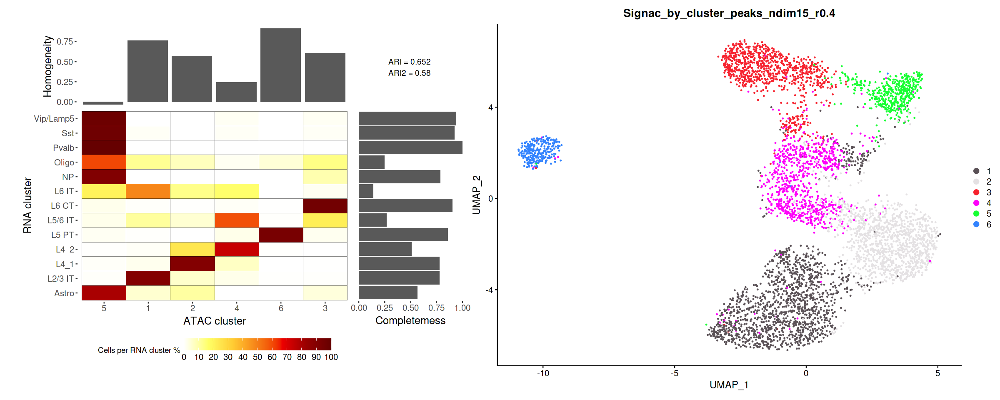

In [14]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

Signac_by_cluster_peaks and Signac_all_cell_peaks do not seperate between Astro+NP+Ologo+Pvalb+Sst+Vip/Lamp5, likely because they're extremely rare classes.

In [15]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "Signac_all_cell_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
3,ARI,0.2604969,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.075,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.075_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.075.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,10
4,ARI,0.4962476,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.125,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.125_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.125.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,9
5,ARI,0.5974448,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.200,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.2_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.2.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,8
6,ARI,0.6685549,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.450,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.45_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.45.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,7
7,ARI,0.6987351,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.550,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.55_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.55.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,6
8,ARI,0.5653754,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.600,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.6_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.6.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,5
9,ARI,0.5466016,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.700,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.7_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.7.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,4
11,ARI,0.4765757,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.900,Chen_2019/evaluation/Signac/all_cell_peaks/0/default/15/r0.9_evaluation.RDS,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/r0.9.tsv,Chen_2019/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,2


In [16]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          7 ARI    0.699 Signac Signac_a… all_ce…       0 default    15    0.55
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


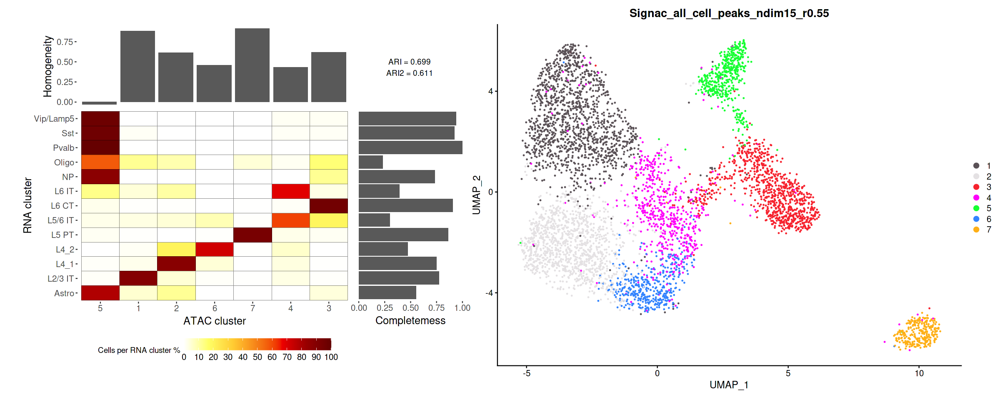

In [18]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [19]:
i <- 8
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.477 Signac Signac_a… all_ce…       0 default    15     0.9
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


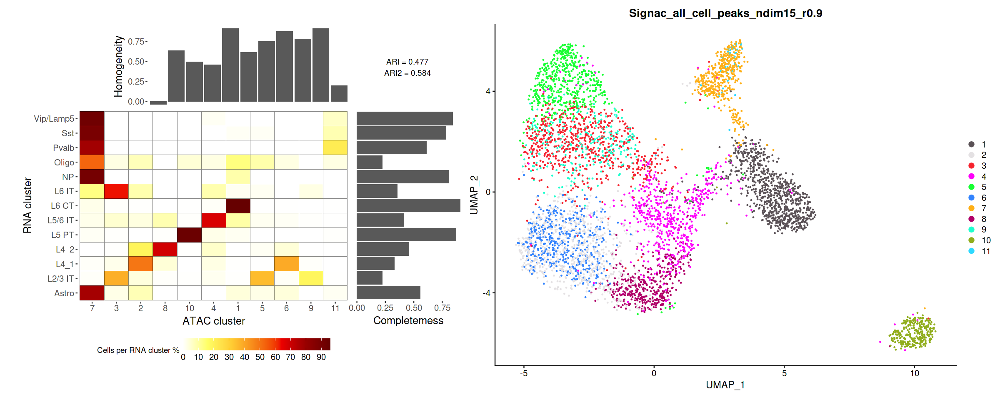

In [20]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## ArchR

In [21]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          5 ARI    0.493 ArchR  ArchR_ti… tiles       500 default    15    0.35
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


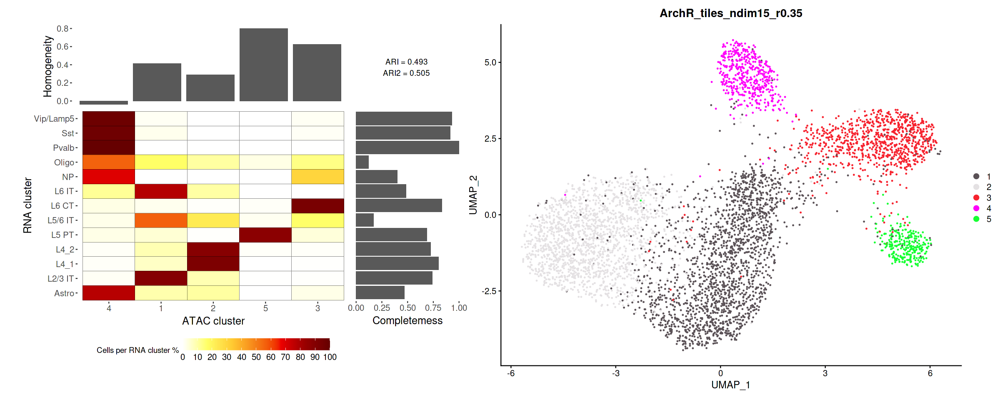

In [22]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [23]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
3,ARI,0.2570384,ArchR,ArchR_peaks,peaks,500,default,15,0.100,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.1_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.1.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,10
5,ARI,0.5157331,ArchR,ArchR_peaks,peaks,500,default,15,0.225,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.225_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.225.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,8
5,ARI,0.5157331,ArchR,ArchR_peaks,peaks,500,default,15,0.250,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.25_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.25.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,8
6,ARI,0.6205915,ArchR,ArchR_peaks,peaks,500,default,15,0.300,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,7
7,ARI,0.6656933,ArchR,ArchR_peaks,peaks,500,default,15,0.450,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.45_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.45.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,6
8,ARI,0.5513748,ArchR,ArchR_peaks,peaks,500,default,15,0.650,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.65_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.65.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,5
9,ARI,0.5299539,ArchR,ArchR_peaks,peaks,500,default,15,0.800,Chen_2019/evaluation/ArchR/peaks/500/default/15/r0.8_evaluation.RDS,Chen_2019/clustering/ArchR/peaks/500/default/15/r0.8.tsv,Chen_2019/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,4


In [24]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          7 ARI    0.666 ArchR  ArchR_pe… peaks       500 default    15    0.45
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


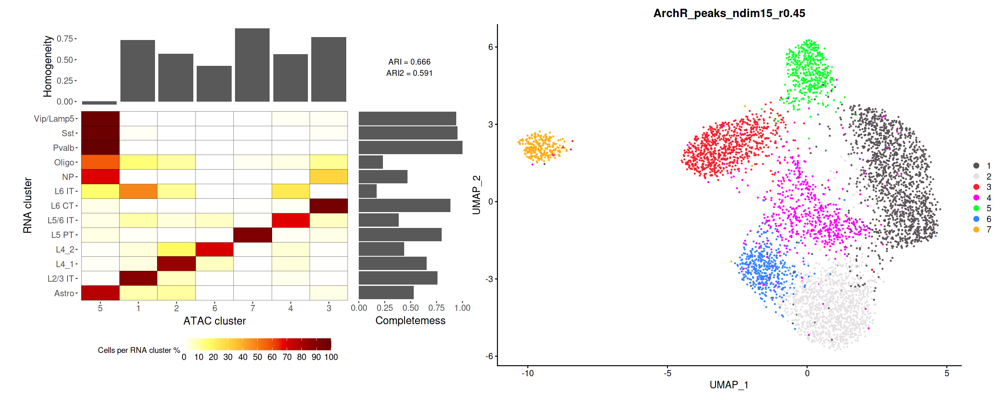

In [25]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

For ArchR: in addition, the L6IT + L2/3IT (+L5/L6IT) are not seperated.

## Aggregation

In [27]:
i <- 6
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.717 aggrega… aggreg… default     500 default    15   0.125
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


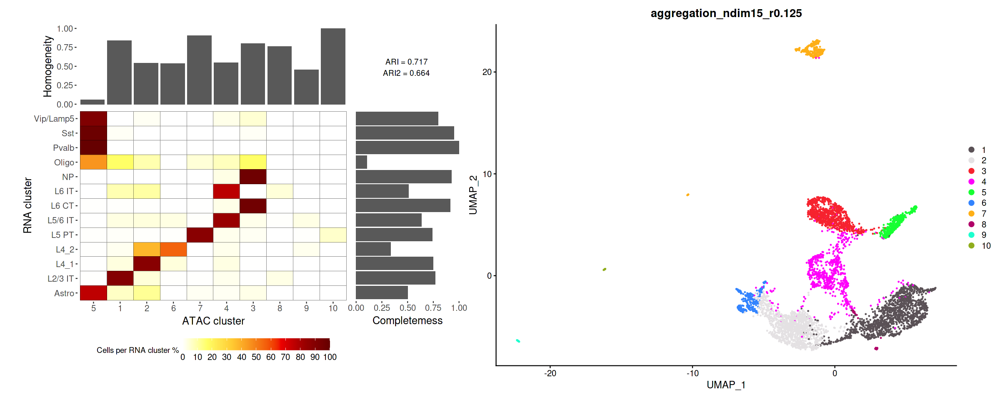

In [28]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In addition, mix NP and L6CT together.

Aggregation method "create" some outlier clusters. (Or it might due to the smaller dispersion in the major classes)

## SnapATAC1

In [30]:
i <- 5
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1          8 ARI    0.746 SnapATA… SnapAT… default    5000 default    15    0.45
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


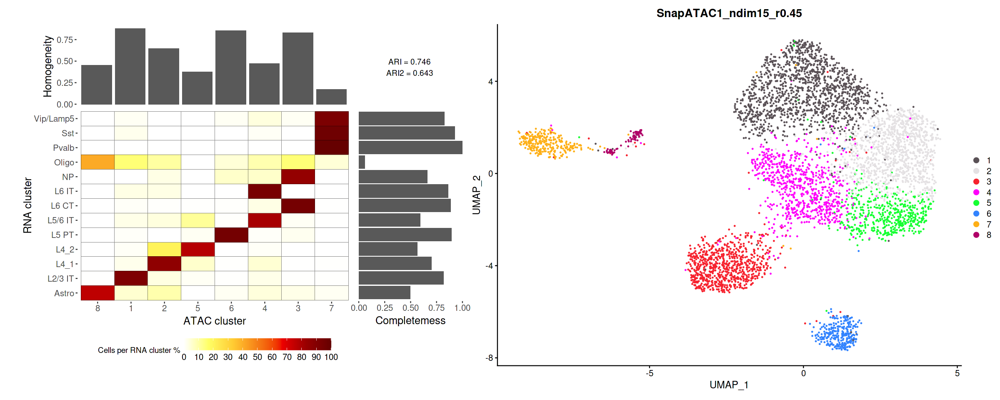

In [32]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

SnapATAC1 managed to seperate Astro with Vip, Sst and Pvalb.

## SnapATAC2

In [33]:
i <- 7
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_jaccard"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1          7 ARI    0.718 SnapATA… SnapAT… default     500 jaccard    15    0.55
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


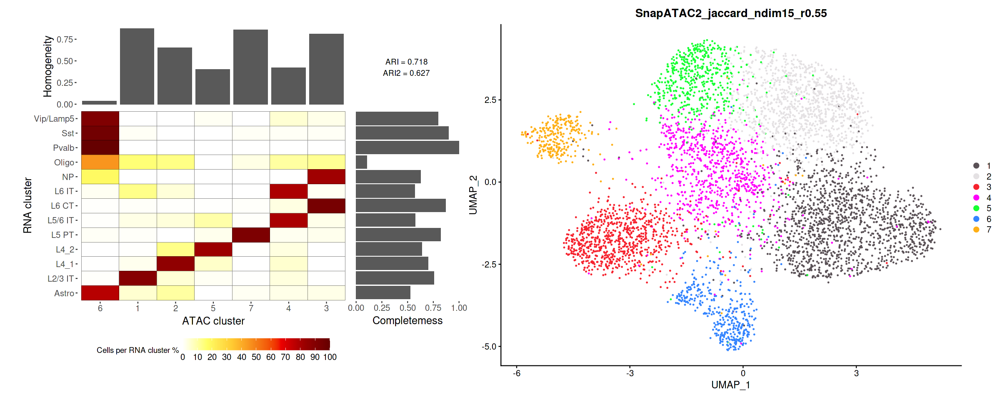

In [35]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [ ]:
# options(repr.plot.width=8, repr.plot.height=8)

fig.path <- "figures/best_ARI/"
dir.create("figures/")
dir.create("figures/best_ARI/")

df_method <- df_best

for (i in 1:dim(df_best)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)

    at <- paste0("resolution = ", df_method$resolution[i])
    bt <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8,height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,at, pos=4)
    text(1,3,bt, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=2.1, c=2))
    dev.off()
}

[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


In [ ]:
df_method <- df_optimal_k

fig.path <- "figures/optimal_k/"
dir.create("figures/")
dir.create("figures/optimal_k/")

options(repr.plot.width=8, repr.plot.height=8)

for (i in 1:dim(df_method)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)
    a <- paste0("resolution = ", df_method$resolution[i])
    b <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8,height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,a, pos=4)
    text(1,3,b, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=2, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”
Warning message in dir.create("figures/optimal_k/"):
“'figures/optimal_k' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


In [ ]:
i <- 3
df_method <- df_optimal_k
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


In [ ]:
a <- paste0("resolution = ", df_method$resolution[i])
b <- paste0("ndim = ", df_method$ndim[i])


pdf(paste0(fig.path, long_method, '.pdf'),width=8,height=8)
plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
    xaxt='n', yaxt='n', xlab='', ylab='')
text(1,4,a, pos=4)
text(1,3,b, pos=4)
# points(rep(1,4),1:4, pch=15)
print(cross_table_plot(ground_truth, clusterings, a=1.3, b=2.2, c=2))
dev.off()

png 
  2

# Buenrostro_2018

In [6]:
j <- 1
n <- 15

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [ ]:
df_tmp <- df_metrics_selected
df_tmp$dataset <- dataset
df_metrics_all <- rbind(df_metrics_all, df_tmp)

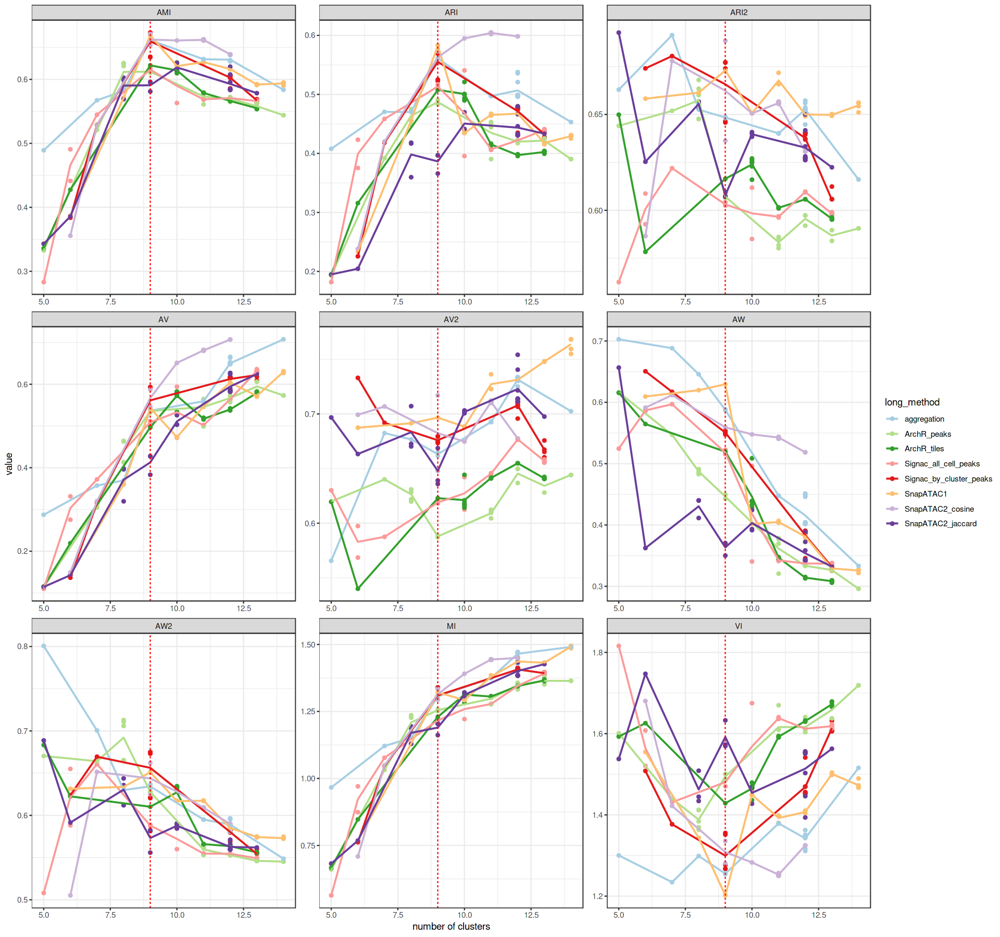

In [ ]:
options(repr.plot.width=16, repr.plot.height=15)

# line plot (fix ndim=50)
p2 <-
df_metrics_external %>% #filter(n_clusters <= 30) %>% #filter(grepl(n,ndim)) %>%
  group_by(long_method, metric, n_clusters) %>%
  mutate(mean_value = mean(value)) %>%
  ggplot(aes(x=n_clusters, y=value, color=long_method)) + 
  geom_point(size=1.5) +
  geom_line(size=0.8, aes(x=n_clusters, y=mean_value, color=long_method)) + 
  facet_wrap(~metric, scales = "free") + 
  xlab("number of clusters") +
  ylab("value") +
  geom_vline(xintercept=k_optimal, color = "red", linetype = "dashed") +
  theme_bw() +
  # geom_errorbar(aes(ymin = min_value, ymax = max_value), width = 0.2, linetype = "dashed") +
  scale_colour_manual(values = brewer.pal(10, "Paired")[c(1,3:6,7,9:10)])
p2

In [7]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]

df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)

df_optimal_k <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(n_clusters_d == min(n_clusters_d)) %>% filter(value == max(value)) %>%
  ungroup()


In [ ]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


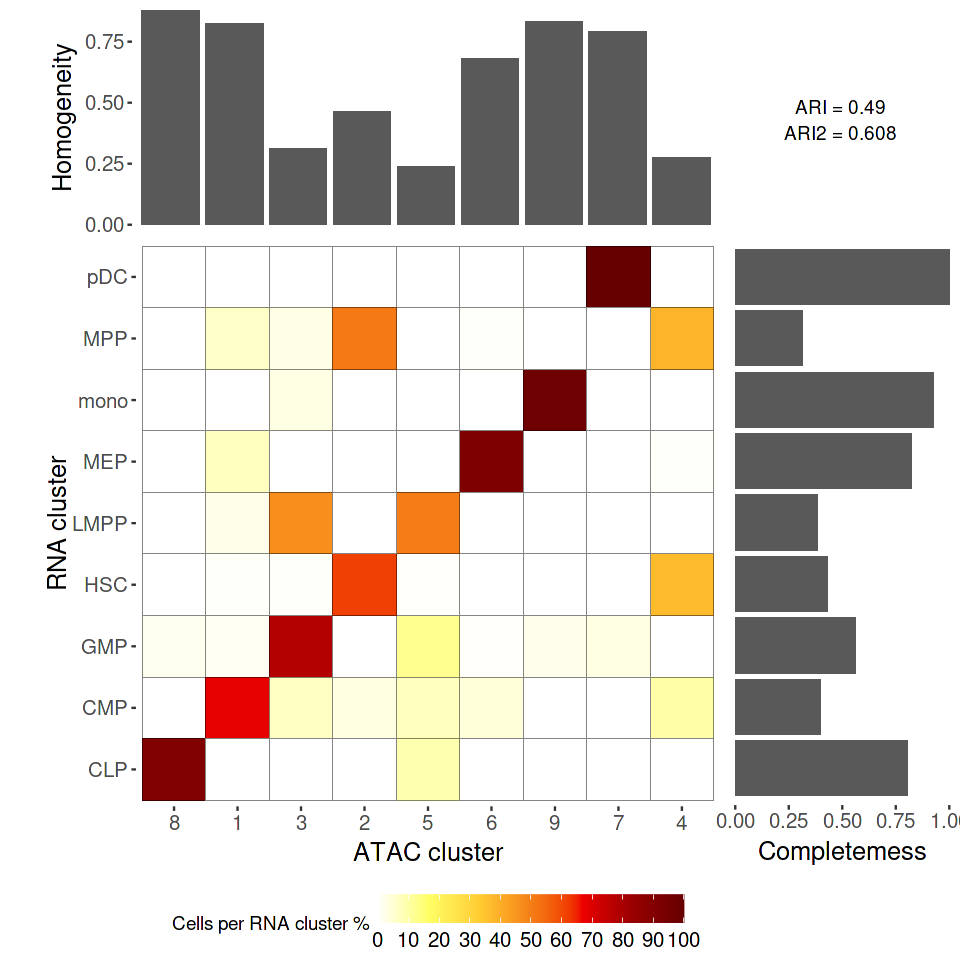

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.1, c=2)

In [8]:
df_best

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
9,ARI,0.5724692,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.200,Buenrostro_2018/evaluation/Signac/by_cluster_peaks/0/default/15/r0.2_evaluation.RDS,Buenrostro_2018/clustering/Signac/by_cluster_peaks/0/default/15/r0.2.tsv,Buenrostro_2018/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
10,ARI,0.5406593,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.300,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.3_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.3.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
9,ARI,0.4904948,ArchR,ArchR_peaks,peaks,500,default,15,0.300,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
10,ARI,0.5210552,ArchR,ArchR_tiles,tiles,500,default,15,0.175,Buenrostro_2018/evaluation/ArchR/tiles/500/default/15/r0.175_evaluation.RDS,Buenrostro_2018/clustering/ArchR/tiles/500/default/15/r0.175.tsv,Buenrostro_2018/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
9,ARI,0.5829816,SnapATAC1,SnapATAC1,default,5000,default,15,0.150,Buenrostro_2018/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,Buenrostro_2018/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS
9,ARI,0.5612418,aggregation,aggregation,default,500,default,15,0.200,Buenrostro_2018/evaluation/aggregation/default/500/default/15/r0.2_evaluation.RDS,Buenrostro_2018/clustering/aggregation/default/500/default/15/r0.2.tsv,Buenrostro_2018/clustering/aggregation/default/500/default/15/sobj_SNN.RDS
12,ARI,0.4799107,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.500,Buenrostro_2018/evaluation/SnapATAC2/default/500/jaccard/15/r0.5_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/jaccard/15/r0.5.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS
11,ARI,0.6046520,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.350,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.35_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.35.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS


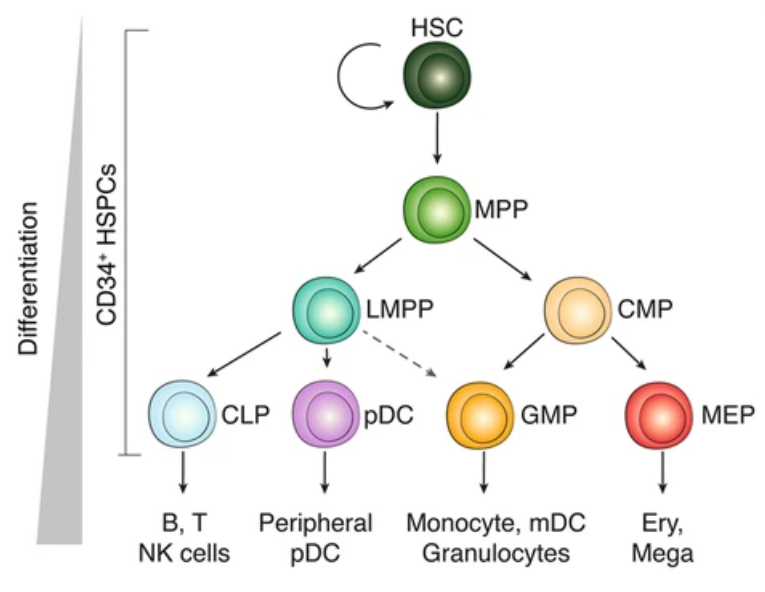

## Signac

In [9]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          9 ARI    0.572 Signac Signac_b… by_clu…       0 default    15     0.2
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


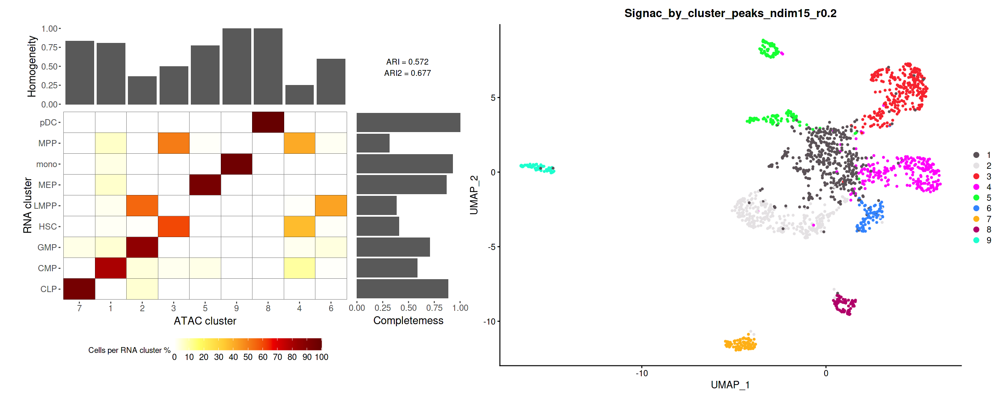

In [13]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [32]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "Signac_all_cell_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
5,ARI,0.1819259,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.050,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.05_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.05.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,4
6,ARI,0.4232417,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.150,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.15_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.15.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,3
7,ARI,0.4584297,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.175,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.175_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.175.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,2
9,ARI,0.5171375,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.200,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.2_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.2.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,0
10,ARI,0.5406593,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.300,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.3_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.3.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,1
11,ARI,0.4077467,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.400,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.4_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.4.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,2
12,ARI,0.4224868,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.550,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.55_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.55.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,3
13,ARI,0.4411415,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.850,Buenrostro_2018/evaluation/Signac/all_cell_peaks/0/default/15/r0.85_evaluation.RDS,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/r0.85.tsv,Buenrostro_2018/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,4


In [33]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.541 Signac Signac_a… all_ce…       0 default    15     0.3
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


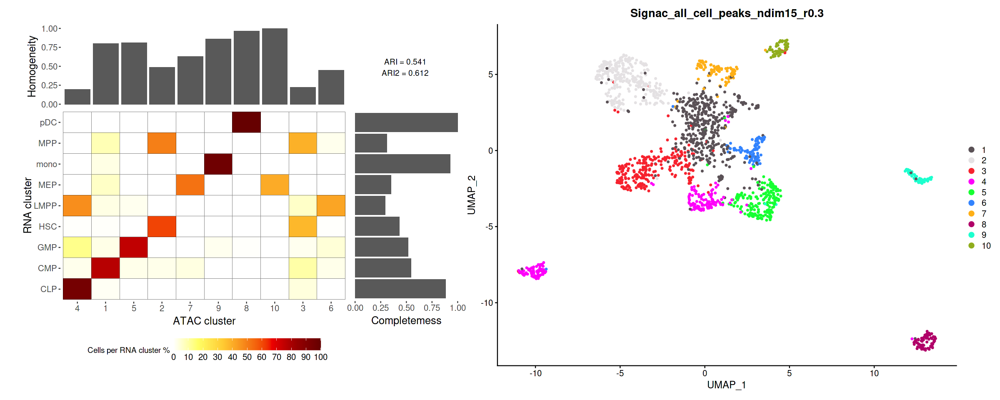

In [34]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## ArchR

In [35]:
i <- 4
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.521 ArchR  ArchR_ti… tiles       500 default    15   0.175
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


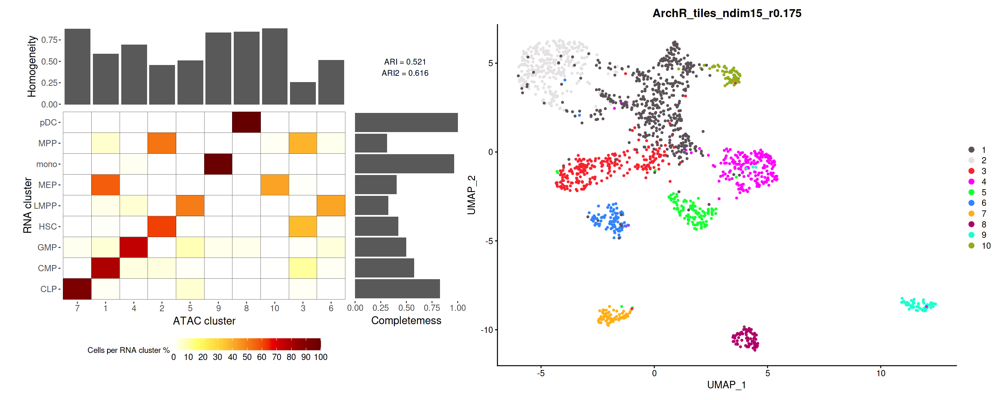

In [36]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [21]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
5,ARI,0.1929565,ArchR,ArchR_peaks,peaks,500,default,15,0.05,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.05.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,4
7,ARI,0.3918890,ArchR,ArchR_peaks,peaks,500,default,15,0.10,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.1_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.1.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
8,ARI,0.4750717,ArchR,ArchR_peaks,peaks,500,default,15,0.20,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.2_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.2.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,1
9,ARI,0.4904948,ArchR,ArchR_peaks,peaks,500,default,15,0.30,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,0
11,ARI,0.4531769,ArchR,ArchR_peaks,peaks,500,default,15,0.40,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.4_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.4.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
12,ARI,0.4212326,ArchR,ArchR_peaks,peaks,500,default,15,0.60,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.6_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.6.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,3
12,ARI,0.4212326,ArchR,ArchR_peaks,peaks,500,default,15,0.70,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.7_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.7.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,3
14,ARI,0.3903974,ArchR,ArchR_peaks,peaks,500,default,15,0.80,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.8_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.8.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,5
13,ARI,0.4254865,ArchR,ArchR_peaks,peaks,500,default,15,0.85,Buenrostro_2018/evaluation/ArchR/peaks/500/default/15/r0.85_evaluation.RDS,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/r0.85.tsv,Buenrostro_2018/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,4


In [22]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          9 ARI    0.490 ArchR  ArchR_pe… peaks       500 default    15     0.3
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


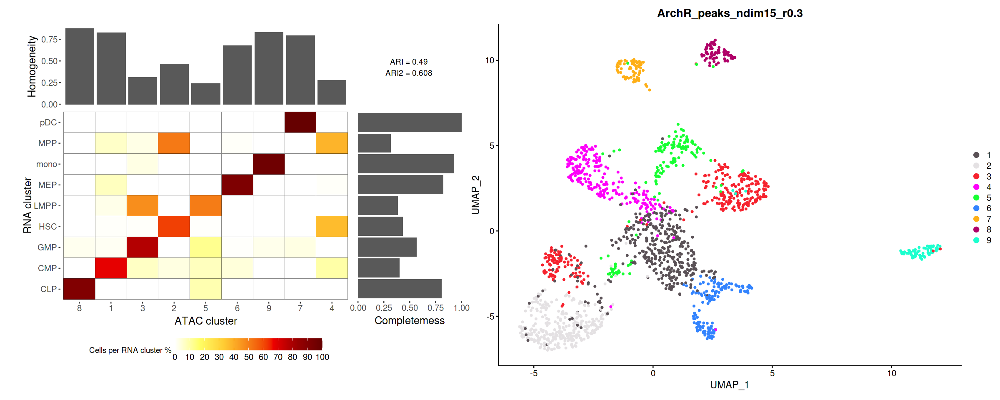

In [24]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## Aggregation

In [8]:
i <- 6
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1          9 ARI    0.561 aggrega… aggreg… default     500 default    15     0.2
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


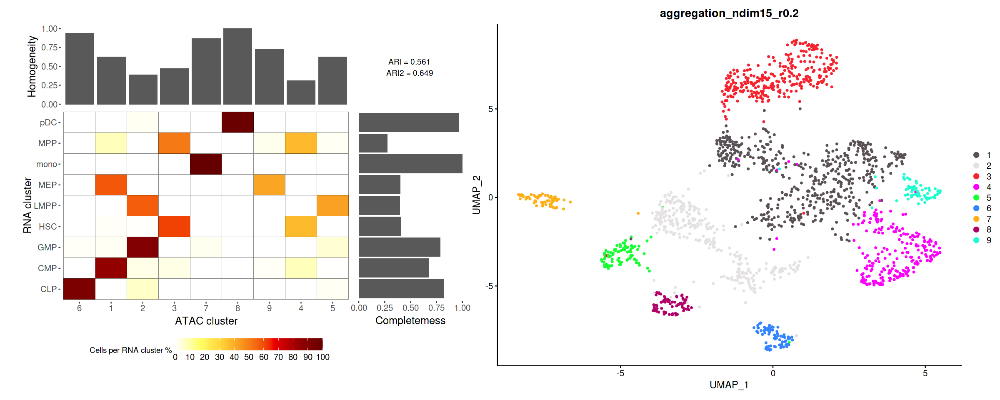

In [9]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## SnapATAC1

In [30]:
i <- 5
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1          9 ARI    0.583 SnapATA… SnapAT… default    5000 default    15    0.15
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


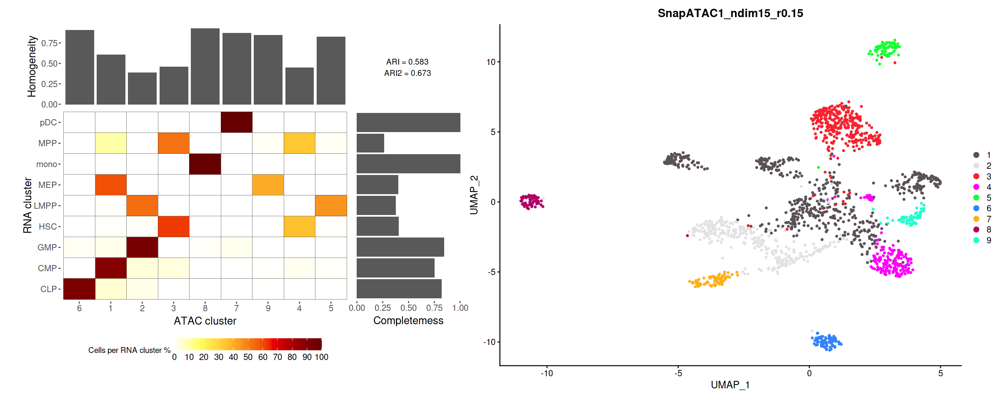

In [31]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [45]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC1") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
11,ARI,0.9646416,SnapATAC1,SnapATAC1,default,5000,default,15,0.05,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.05_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.05.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,2
12,ARI,0.9678846,SnapATAC1,SnapATAC1,default,5000,default,15,0.10,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.1_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.1.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,1
12,ARI,0.9678846,SnapATAC1,SnapATAC1,default,5000,default,15,0.15,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,1
13,ARI,0.9596295,SnapATAC1,SnapATAC1,default,5000,default,15,0.30,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.3_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.3.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,0
15,ARI,0.8808412,SnapATAC1,SnapATAC1,default,5000,default,15,0.35,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.35_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.35.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,2
17,ARI,0.8590008,SnapATAC1,SnapATAC1,default,5000,default,15,0.50,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.5_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.5.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,4
24,ARI,0.6474603,SnapATAC1,SnapATAC1,default,5000,default,15,0.90,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.9_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.9.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,11
16,ARI,0.8650663,SnapATAC1,SnapATAC1,default,5000,default,15,0.40,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.4_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.4.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,3
18,ARI,0.7932277,SnapATAC1,SnapATAC1,default,5000,default,15,0.60,candidate1/evaluation/SnapATAC1/default/5000/default/15/r0.6_evaluation.RDS,candidate1/clustering/SnapATAC1/default/5000/default/15/r0.6.tsv,candidate1/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,5


In [48]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.960 SnapATA… SnapAT… default    5000 default    15     0.3
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


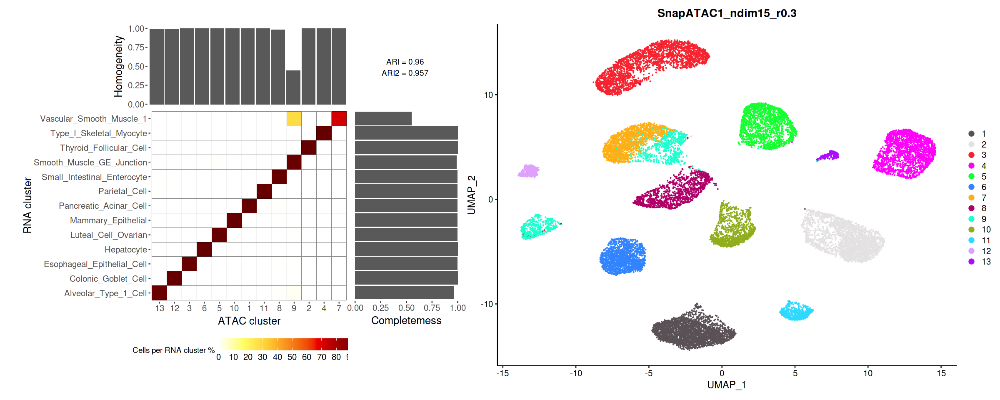

In [49]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [46]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         15 ARI    0.881 SnapATA… SnapAT… default    5000 default    15    0.35
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


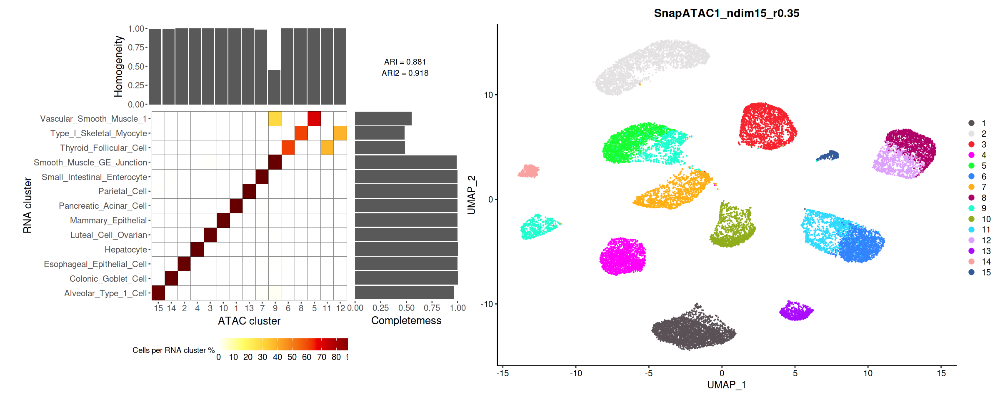

In [47]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=5.6, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## SnapATAC2

In [25]:
i <- 7
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_jaccard"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         12 ARI    0.480 SnapATA… SnapAT… default     500 jaccard    15     0.5
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


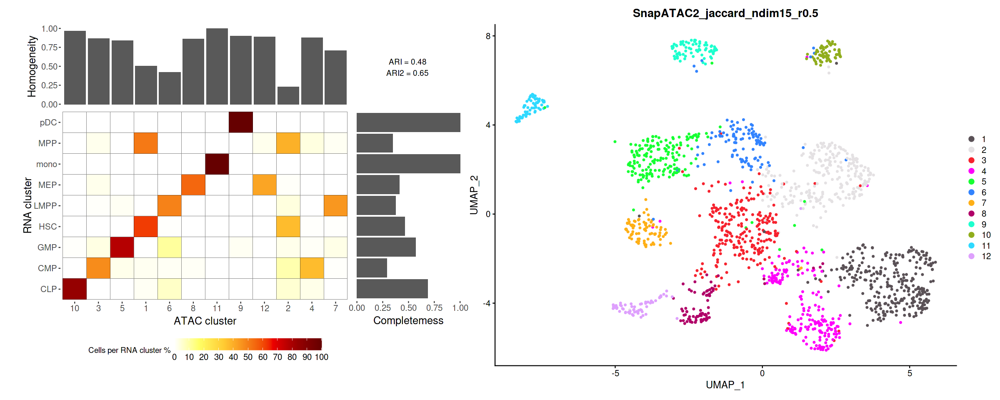

In [26]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [37]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC2_cosine") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
6,ARI,0.2380177,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.05,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.05_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.05.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,3
7,ARI,0.4201036,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.10,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.1_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.1.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,2
9,ARI,0.5731316,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.15,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.15_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.15.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,0
10,ARI,0.5949385,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.20,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.2_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.2.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,1
11,ARI,0.6046520,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.35,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.35_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.35.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,2
11,ARI,0.6046520,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.40,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.4_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.4.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,2
11,ARI,0.6046520,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.45,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.45_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.45.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,2
12,ARI,0.5983230,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.85,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.85_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.85.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,3
12,ARI,0.5983230,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.90,Buenrostro_2018/evaluation/SnapATAC2/default/500/cosine/15/r0.9_evaluation.RDS,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/r0.9.tsv,Buenrostro_2018/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,3


In [38]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_cosine"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.605 SnapATA… SnapAT… default     500 cosine     15    0.35
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


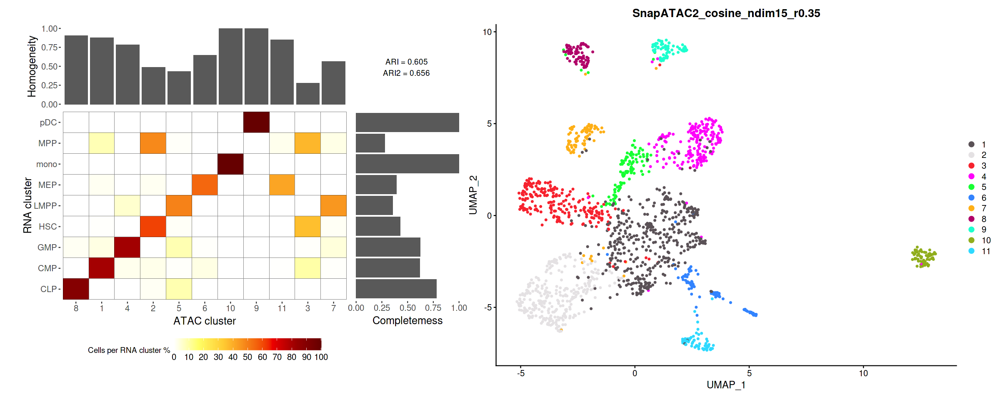

In [39]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

For this dataset, there're intermediate states, and the ground truth is FACS-sorted labels. So it's hard to say if the ground truth is good or not. The most common classes that are joint together by methods are LMPP + GMP/CLP, HSC + MPP, MEP + CMP. Signac_by_cluster_peaks/ArchR_peaks: LMPP+GMP, HSC+MPP; Signac_all_cell_peaks: CLP+LMPP+GMP, HSC+MPP; ArchR_tiles: MEP+CMP, HSC+MPP; Aggregation, SnapATAC1: MEP+CMP, HSC+MPP, LMPP+GMP; SnapATAC2: HSC+MPP. SnapATAC2 seems to be able to seperate LMPP + GMP better than the other methods. SnapATAC2_cosine seems to be able to have higher completeness score than SnapATAC2_jaccard.

How about the Homogeneity score?

In [ ]:
# options(repr.plot.width=8, repr.plot.height=8)

fig.path <- "figures/best_ARI/"
dir.create("figures/")
dir.create("figures/best_ARI/")

df_method <- df_best

for (i in 1:dim(df_best)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)

    at <- paste0("resolution = ", df_method$resolution[i])
    bt <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8,height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,at, pos=4)
    text(1,3,bt, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=1.1, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”
Warning message in dir.create("figures/best_ARI/"):
“'figures/best_ARI' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_peaks"
[1] "ArchR_tiles"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


In [ ]:
df_method <- df_optimal_k

fig.path <- "figures/optimal_k/"
dir.create("figures/")
dir.create("figures/optimal_k/")

options(repr.plot.width=8, repr.plot.height=8)

for (i in 1:dim(df_method)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)
    a <- paste0("resolution = ", df_method$resolution[i])
    b <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8,height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,a, pos=4)
    text(1,3,b, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=1.1, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”
Warning message in dir.create("figures/optimal_k/"):
“'figures/optimal_k' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_peaks"
[1] "ArchR_tiles"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


# PBMC_multiomics

In [16]:
j <- 5
n <- 15

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [17]:
df_tmp <- df_metrics_selected
df_tmp$dataset <- dataset
df_metrics_all <- rbind(df_metrics_all, df_tmp)

ERROR: Error in rbind(df_metrics_all, df_tmp): object 'df_metrics_all' not found


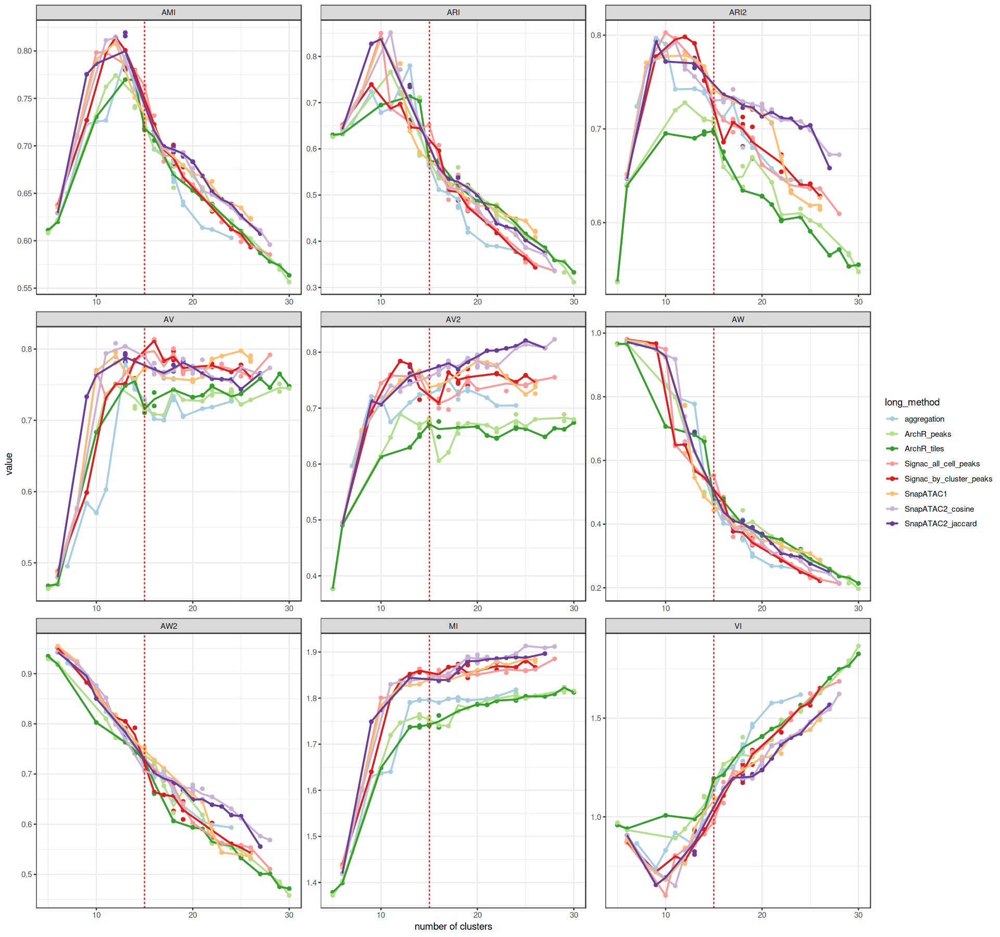

In [ ]:
options(repr.plot.width=16, repr.plot.height=15)

# line plot (fix ndim=50)
p2 <-
df_metrics_external %>% #filter(n_clusters <= 30) %>% #filter(grepl(n,ndim)) %>%
  group_by(long_method, metric, n_clusters) %>%
  mutate(mean_value = mean(value)) %>%
  ggplot(aes(x=n_clusters, y=value, color=long_method)) + 
  geom_point(size=1.5) +
  geom_line(size=0.8, aes(x=n_clusters, y=mean_value, color=long_method)) + 
  facet_wrap(~metric, scales = "free") + 
  xlab("number of clusters") +
  ylab("value") +
  geom_vline(xintercept=k_optimal, color = "red", linetype = "dashed") +
  theme_bw() +
  # geom_errorbar(aes(ymin = min_value, ymax = max_value), width = 0.2, linetype = "dashed") +
  scale_colour_manual(values = brewer.pal(10, "Paired")[c(1,3:6,7,9:10)])
p2

In [18]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]

df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)

df_optimal_k <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(n_clusters_d == min(n_clusters_d)) %>% filter(value == max(value)) %>%
  ungroup()


In [ ]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


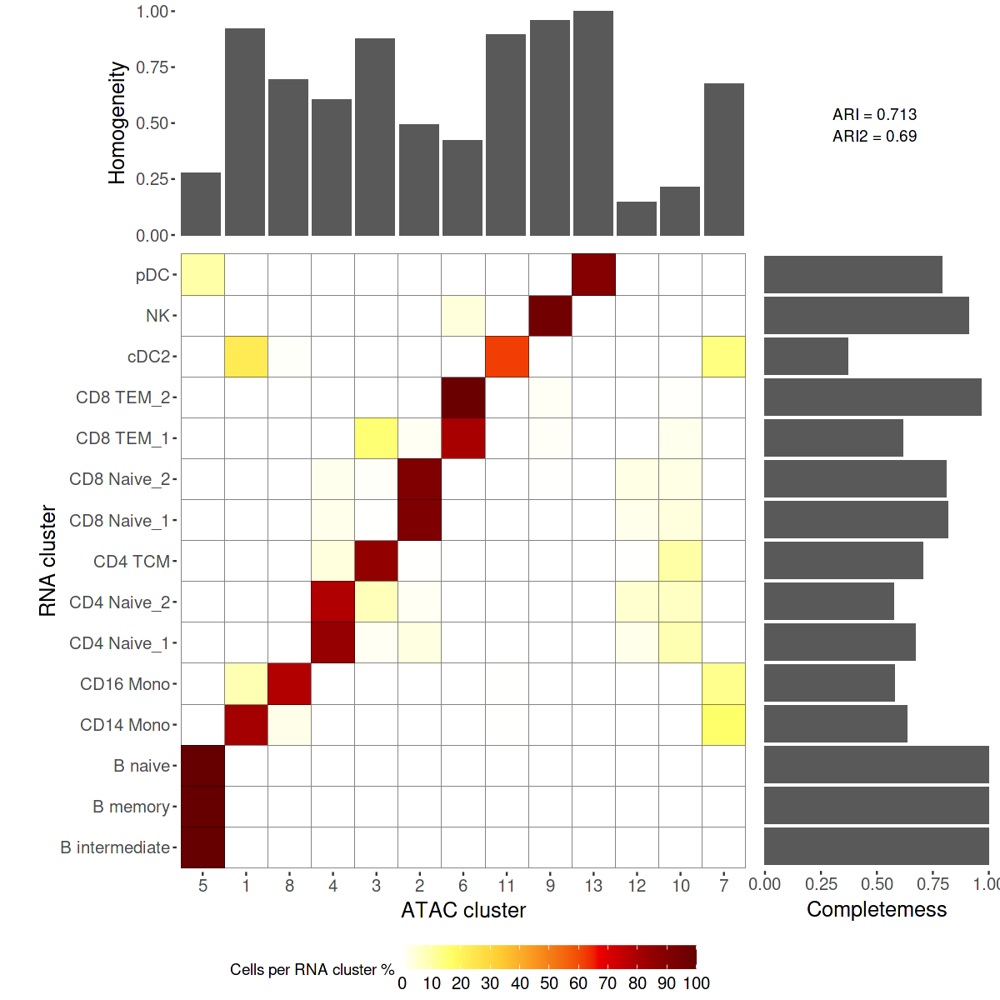

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=10, repr.plot.height=10)
cross_table_plot(ground_truth, clusterings, a=1.5, b=2.75, c=2)

## Signac

In [38]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1          9 ARI    0.739 Signac Signac_b… by_clu…       0 default    15     0.1
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


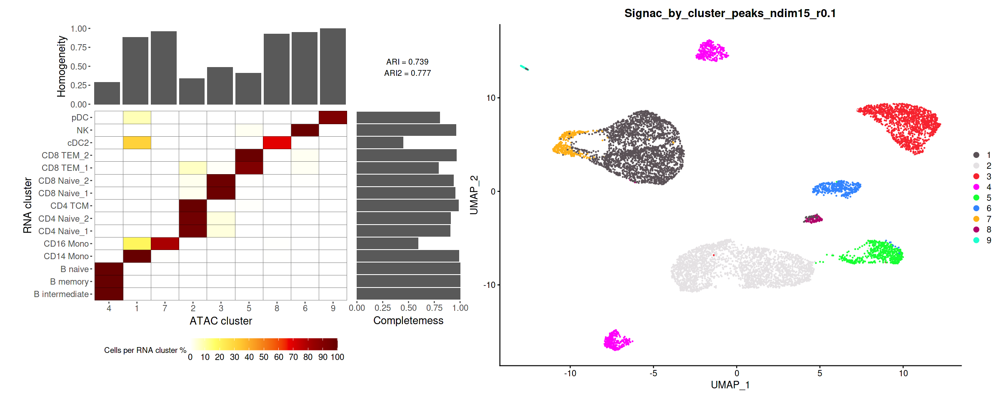

In [42]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [43]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "Signac_all_cell_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
6,ARI,0.6522822,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.05,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.05_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.05.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,9
8,ARI,0.7231811,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.10,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.1_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.1.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,7
10,ARI,0.8503559,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.15,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.15_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.15.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,5
11,ARI,0.6897680,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.40,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.4_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.4.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,4
14,ARI,0.6421766,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.45,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.45_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.45.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,1
15,ARI,0.6521989,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.50,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.5_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.5.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,0
16,ARI,0.6080519,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.55,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.55_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.55.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,1
17,ARI,0.5381400,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.60,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.6_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.6.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,2
18,ARI,0.5436073,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.75,PBMC_multiomics/evaluation/Signac/all_cell_peaks/0/default/15/r0.75_evaluation.RDS,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/r0.75.tsv,PBMC_multiomics/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,3


In [44]:
i <- 3
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.850 Signac Signac_a… all_ce…       0 default    15    0.15
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


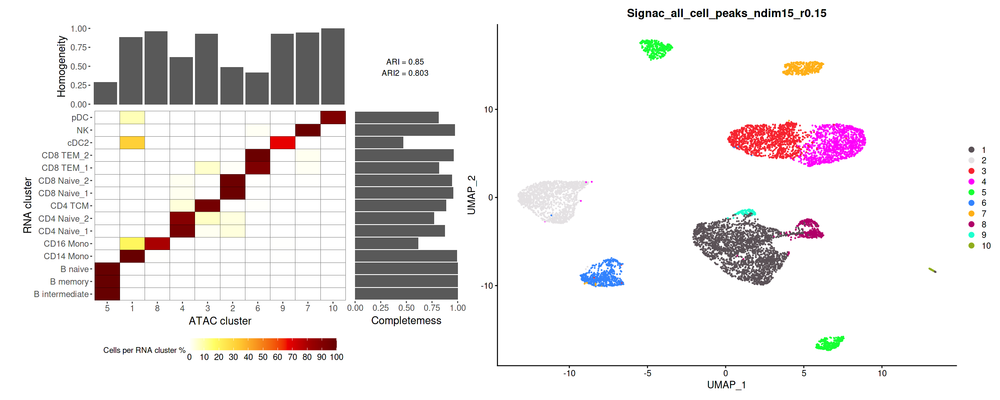

In [46]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

Compared to Signac_by_cluster_peaks, Signac_all_cell_peaks seperate out CD4 TCM, which improves the result.

Compare to other methods, Signac didn't randomly seperate major clusters.

## ArchR

In [47]:
i <- 4
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.767 ArchR  ArchR_pe… peaks       500 default    15    0.15
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


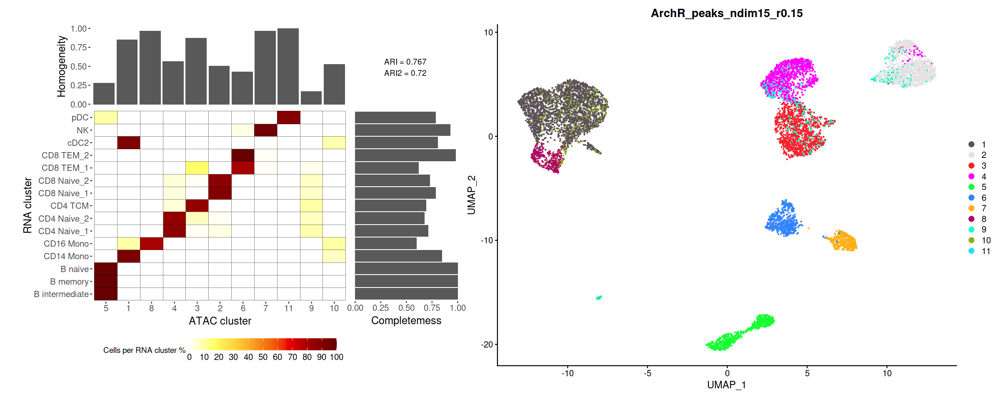

In [49]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [19]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.713 ArchR  ArchR_ti… tiles       500 default    15     0.2
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


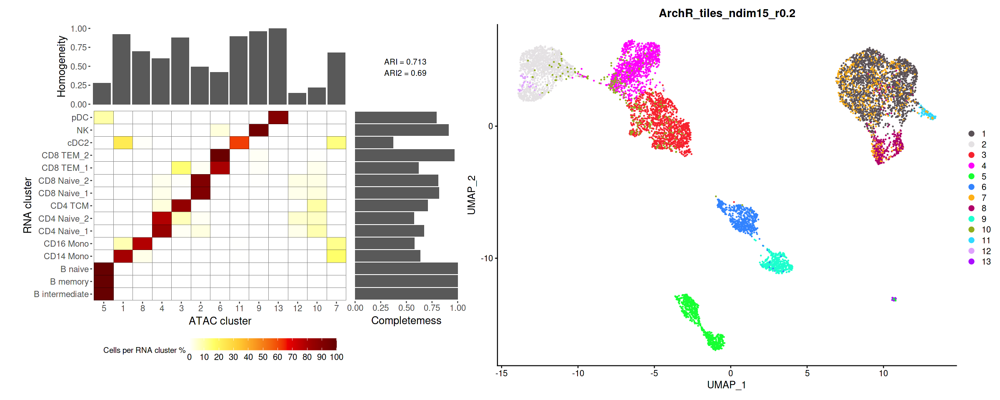

In [20]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

ArchR_peaks failed to seperate cDC2 from CD14 mono. And it created inexisting clusters.

In [50]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_tiles") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
5,ARI,0.6303536,ArchR,ArchR_tiles,tiles,500,default,15,0.05,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.05_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.05.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,10
6,ARI,0.6325091,ArchR,ArchR_tiles,tiles,500,default,15,0.10,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.1.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,9
10,ARI,0.6948465,ArchR,ArchR_tiles,tiles,500,default,15,0.15,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.15_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.15.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,5
13,ARI,0.7131746,ArchR,ArchR_tiles,tiles,500,default,15,0.20,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.2_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.2.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
14,ARI,0.7058788,ArchR,ArchR_tiles,tiles,500,default,15,0.30,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.3_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.3.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,1
15,ARI,0.5772748,ArchR,ArchR_tiles,tiles,500,default,15,0.35,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.35_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.35.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,0
16,ARI,0.5758227,ArchR,ArchR_tiles,tiles,500,default,15,0.45,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.45_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.45.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,1
18,ARI,0.5190304,ArchR,ArchR_tiles,tiles,500,default,15,0.60,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.6_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.6.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,3
20,ARI,0.4866690,ArchR,ArchR_tiles,tiles,500,default,15,0.65,PBMC_multiomics/evaluation/ArchR/tiles/500/default/15/r0.65_evaluation.RDS,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/r0.65.tsv,PBMC_multiomics/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,5


In [51]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.713 ArchR  ArchR_ti… tiles       500 default    15     0.2
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


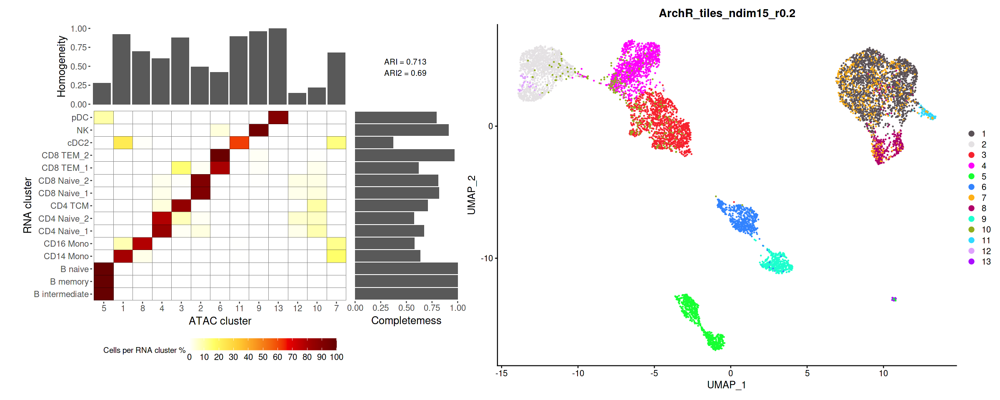

In [52]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [53]:
i <- 3
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.695 ArchR  ArchR_ti… tiles       500 default    15    0.15
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


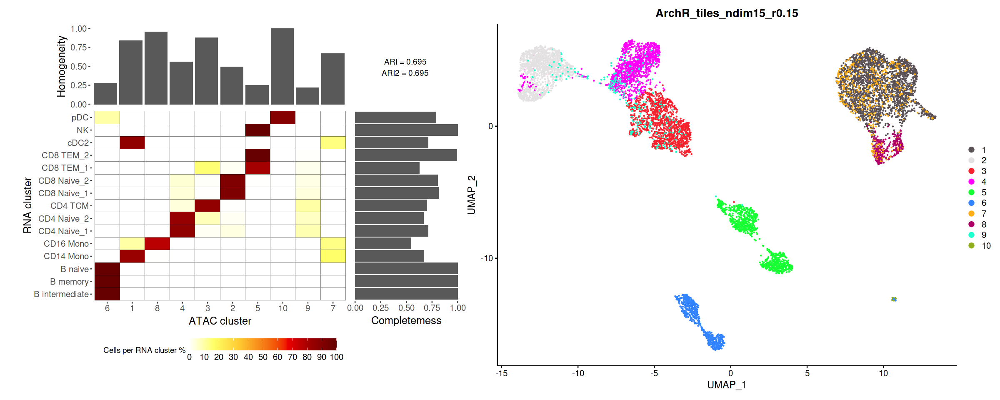

In [54]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

Overall mearly all methods tend to over-cluster some classes, and didn't seperate some other classes (which might due to the RNA annotation is not accurate)

## Aggregation

In [55]:
i <- 6
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.780 aggrega… aggreg… default     500 default    15    0.35
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


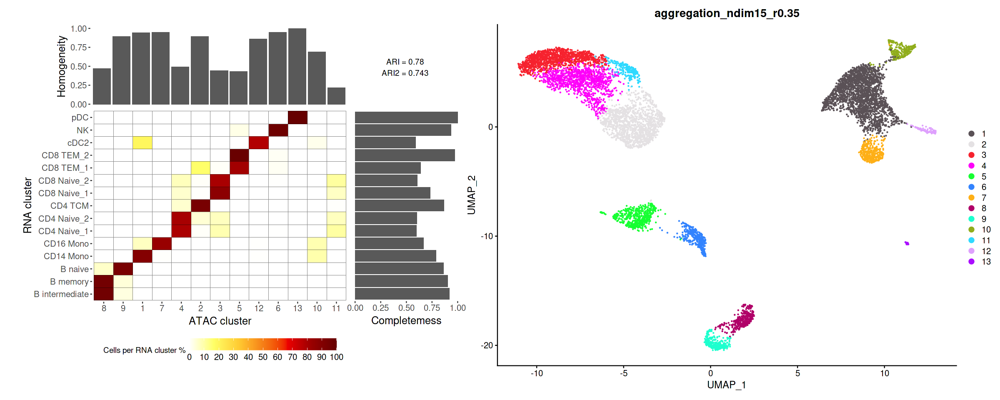

In [56]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

### ndim=100

In [37]:
j <- 5
n <- 100

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [38]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]


[1] "aggregation"
# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.719 aggrega… aggreg… default     500 default   100    0.45
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


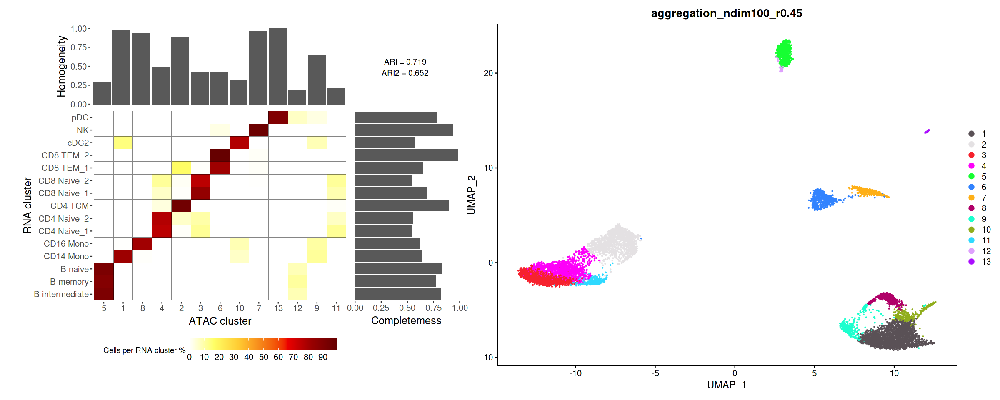

In [39]:
i <- 6
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [40]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "aggregation") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
7,ARI,0.6360393,aggregation,aggregation,default,500,default,100,0.05,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.05_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.05.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
9,ARI,0.6555336,aggregation,aggregation,default,500,default,100,0.10,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.1_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.1.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
10,ARI,0.6614235,aggregation,aggregation,default,500,default,100,0.15,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.15_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.15.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
11,ARI,0.6777039,aggregation,aggregation,default,500,default,100,0.25,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.25_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.25.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
13,ARI,0.7189340,aggregation,aggregation,default,500,default,100,0.45,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.45_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.45.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
14,ARI,0.6225110,aggregation,aggregation,default,500,default,100,0.60,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.6_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.6.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
15,ARI,0.5770794,aggregation,aggregation,default,500,default,100,0.65,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.65_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.65.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
16,ARI,0.5550613,aggregation,aggregation,default,500,default,100,0.70,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.7_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.7.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
17,ARI,0.5235998,aggregation,aggregation,default,500,default,100,0.75,PBMC_multiomics/evaluation/aggregation/default/500/default/100/r0.75_evaluation.RDS,PBMC_multiomics/clustering/aggregation/default/500/default/100/r0.75.tsv,PBMC_multiomics/clustering/aggregation/default/500/default/100/sobj_SNN.RDS


In [41]:
i <- 7
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         15 ARI    0.577 aggrega… aggreg… default     500 default   100    0.65
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


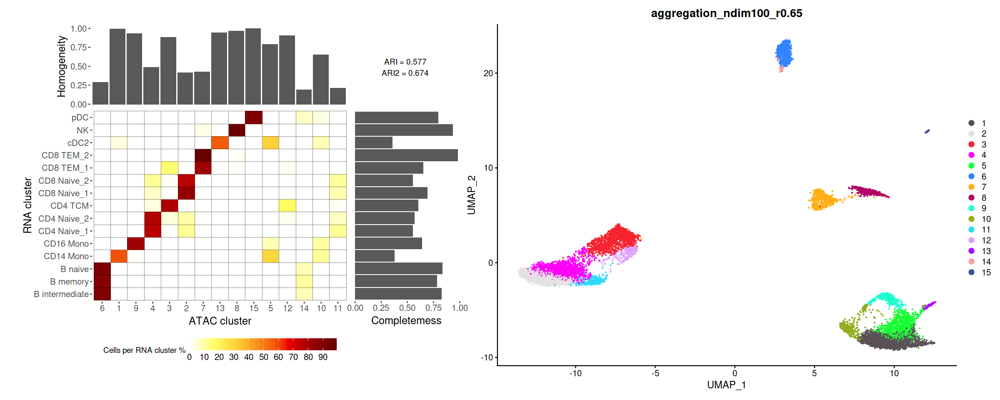

In [42]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

Higher ndim -> less separated subtypes -> increasing n_cluster cannot separate B cell subtypes.

## SnapATAC1

In [57]:
i <- 5
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.839 SnapATA… SnapAT… default    5000 default    15    0.15
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


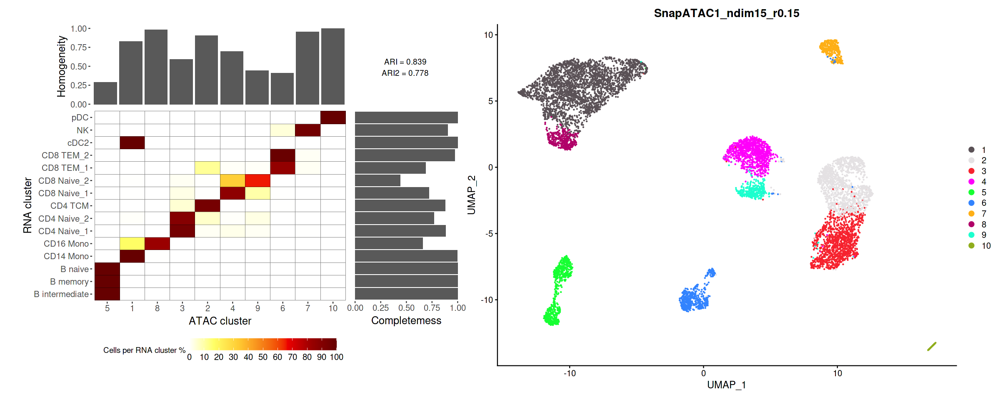

In [58]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

No random segregation.

In [32]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC1") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
6,ARI,0.6486729,SnapATAC1,SnapATAC1,default,5000,default,15,0.05,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.05_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.05.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,9
8,ARI,0.7223250,SnapATAC1,SnapATAC1,default,5000,default,15,0.10,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.1_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.1.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,7
10,ARI,0.8390983,SnapATAC1,SnapATAC1,default,5000,default,15,0.15,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,5
12,ARI,0.7846150,SnapATAC1,SnapATAC1,default,5000,default,15,0.25,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.25_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.25.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,3
13,ARI,0.6383699,SnapATAC1,SnapATAC1,default,5000,default,15,0.35,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.35_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.35.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,2
14,ARI,0.5929152,SnapATAC1,SnapATAC1,default,5000,default,15,0.40,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.4_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.4.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,1
15,ARI,0.5951553,SnapATAC1,SnapATAC1,default,5000,default,15,0.45,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.45_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.45.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,0
16,ARI,0.5595926,SnapATAC1,SnapATAC1,default,5000,default,15,0.60,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.6_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.6.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,1
17,ARI,0.5231711,SnapATAC1,SnapATAC1,default,5000,default,15,0.65,PBMC_multiomics/evaluation/SnapATAC1/default/5000/default/15/r0.65_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/r0.65.tsv,PBMC_multiomics/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,2


In [33]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         12 ARI    0.785 SnapATA… SnapAT… default    5000 default    15    0.25
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


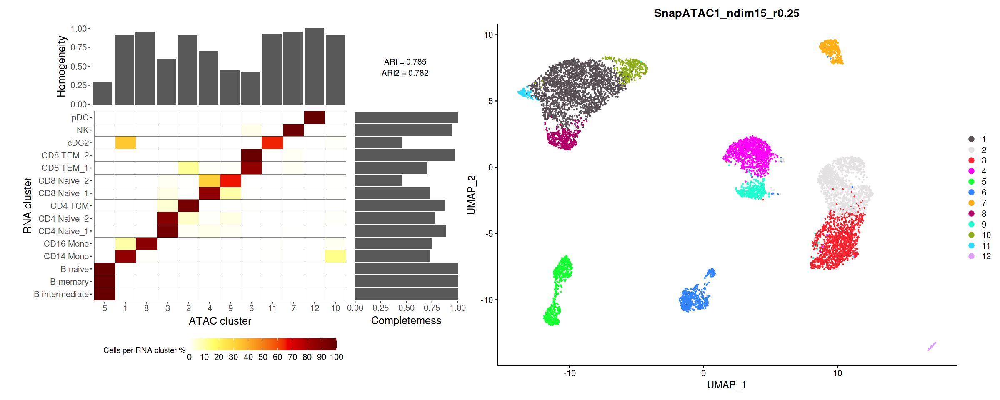

In [34]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [35]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.638 SnapATA… SnapAT… default    5000 default    15    0.35
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


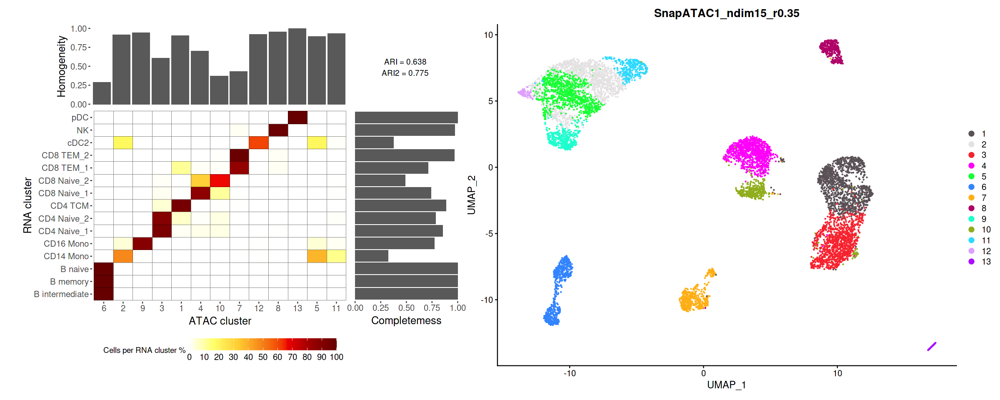

In [36]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

## SnapATAC2

In [59]:
i <- 7
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_jaccard"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         10 ARI    0.838 SnapATA… SnapAT… default     500 jaccard    15    0.15
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


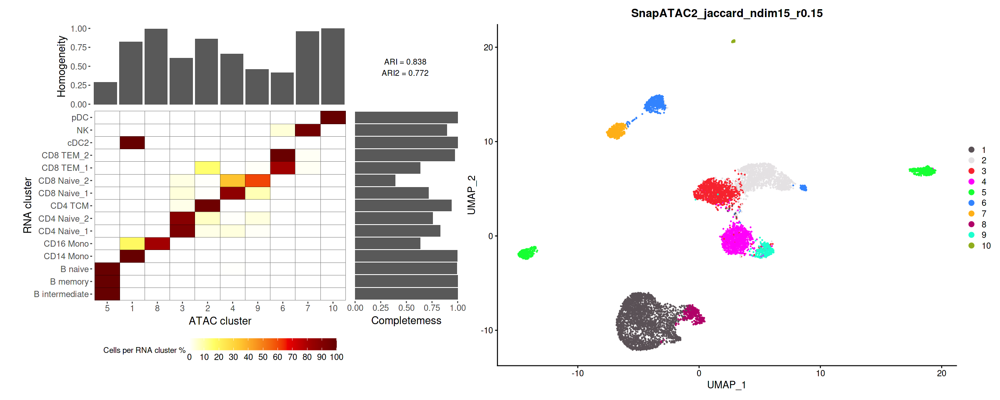

In [60]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [26]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC2_jaccard") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
6,ARI,0.6424502,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.05,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.05_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.05.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,9
9,ARI,0.8273779,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.10,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.1_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.1.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,6
10,ARI,0.8376470,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.15,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.15_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.15.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,5
13,ARI,0.7381266,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.20,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.2_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.2.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,2
16,ARI,0.5592176,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.40,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.4_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.4.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,1
17,ARI,0.5349927,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.50,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.5_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.5.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,2
18,ARI,0.5377801,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.60,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.6_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.6.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,3
19,ARI,0.5202203,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.65,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.65_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.65.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,4
19,ARI,0.5202203,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.70,PBMC_multiomics/evaluation/SnapATAC2/default/500/jaccard/15/r0.7_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/r0.7.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS,4


In [29]:
i <- 4
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_jaccard"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.738 SnapATA… SnapAT… default     500 jaccard    15     0.2
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


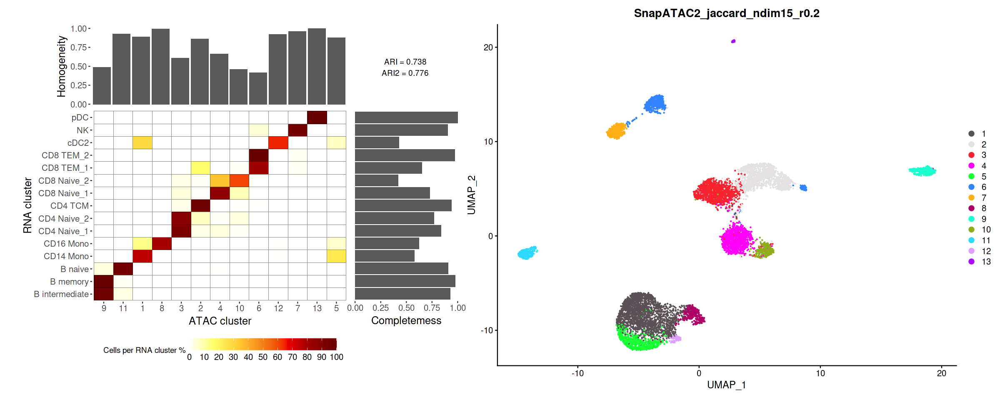

In [30]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [21]:
i <- 8
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_cosine"


# A tibble: 1 × 13
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.851 SnapATA… SnapAT… default     500 cosine     15    0.15
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


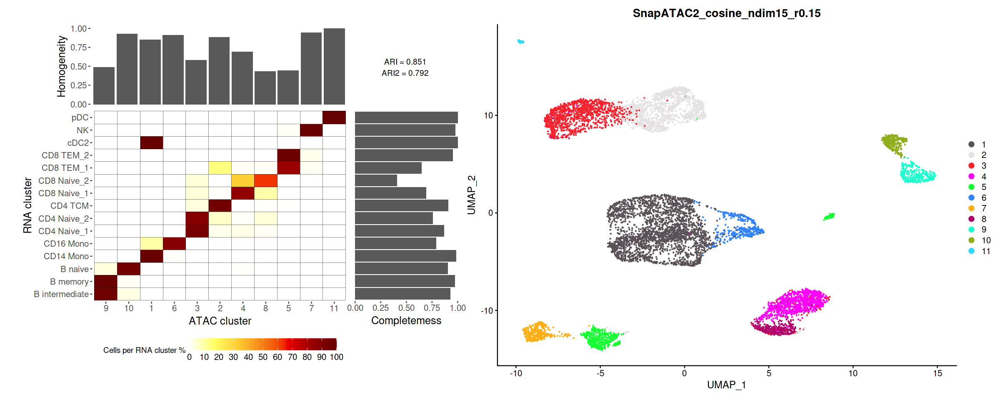

In [22]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=2.7, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [31]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "SnapATAC2_cosine") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
6,ARI,0.6424648,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.05,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.05_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.05.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,9
8,ARI,0.7187719,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.10,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.1_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.1.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,7
11,ARI,0.8514935,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.15,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.15_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.15.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,4
12,ARI,0.7716238,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.25,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.25_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.25.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,3
13,ARI,0.7056204,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.30,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.3_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.3.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,2
15,ARI,0.6127192,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.35,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.35_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.35.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,0
16,ARI,0.5625610,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.45,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.45_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.45.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,1
17,ARI,0.5166864,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.55,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.55_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.55.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,2
18,ARI,0.5137564,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.65,PBMC_multiomics/evaluation/SnapATAC2/default/500/cosine/15/r0.65_evaluation.RDS,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/r0.65.tsv,PBMC_multiomics/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS,3


In [24]:
i <- 5
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC2_cosine"


# A tibble: 1 × 14
  n_clusters metric value method   long_…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>    <chr>   <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.706 SnapATA… SnapAT… default     500 cosine     15     0.3
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


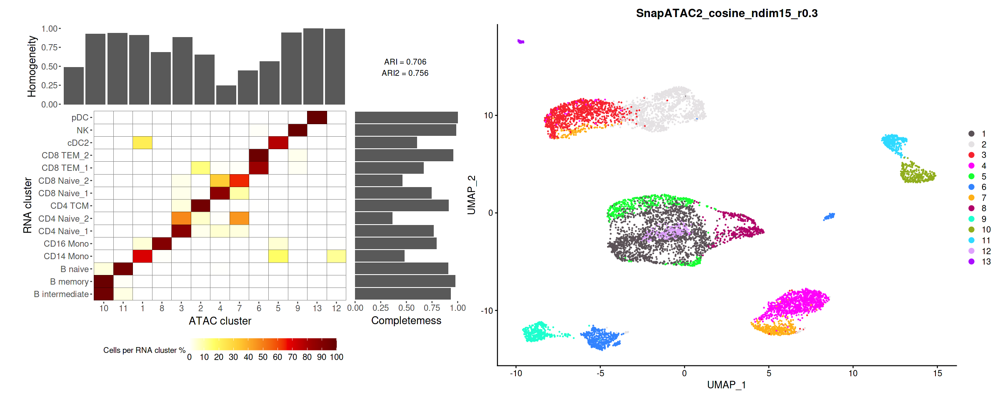

In [25]:
options(repr.plot.width=20, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.5, b=1.2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

In [ ]:
# options(repr.plot.width=8, repr.plot.height=8)

fig.path <- "figures/best_ARI/"
dir.create("figures/")
dir.create("figures/best_ARI/")

df_method <- df_best

for (i in 1:dim(df_best)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)

    at <- paste0("resolution = ", df_method$resolution[i])
    bt <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=10,height=10)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,at, pos=4)
    text(1,3,bt, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.5, b=2.75, c=2))
    dev.off()
}

[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


In [ ]:
df_method <- df_optimal_k

fig.path <- "figures/optimal_k/"
dir.create("figures/")
dir.create("figures/optimal_k/")

options(repr.plot.width=8, repr.plot.height=8)

for (i in 1:dim(df_method)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)
    a <- paste0("resolution = ", df_method$resolution[i])
    b <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=10, height=10)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,a, pos=4)
    text(1,3,b, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.5, b=2.75, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


# Cell_line_mixing

### ndim=15

In [6]:
# For this dataset, the ArchR performs better when n==100 than when n==15. Check both
j <- 3
n <- 15

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [ ]:
df_tmp <- df_metrics_selected
df_tmp$dataset <- dataset
df_metrics_all <- rbind(df_metrics_all, df_tmp)

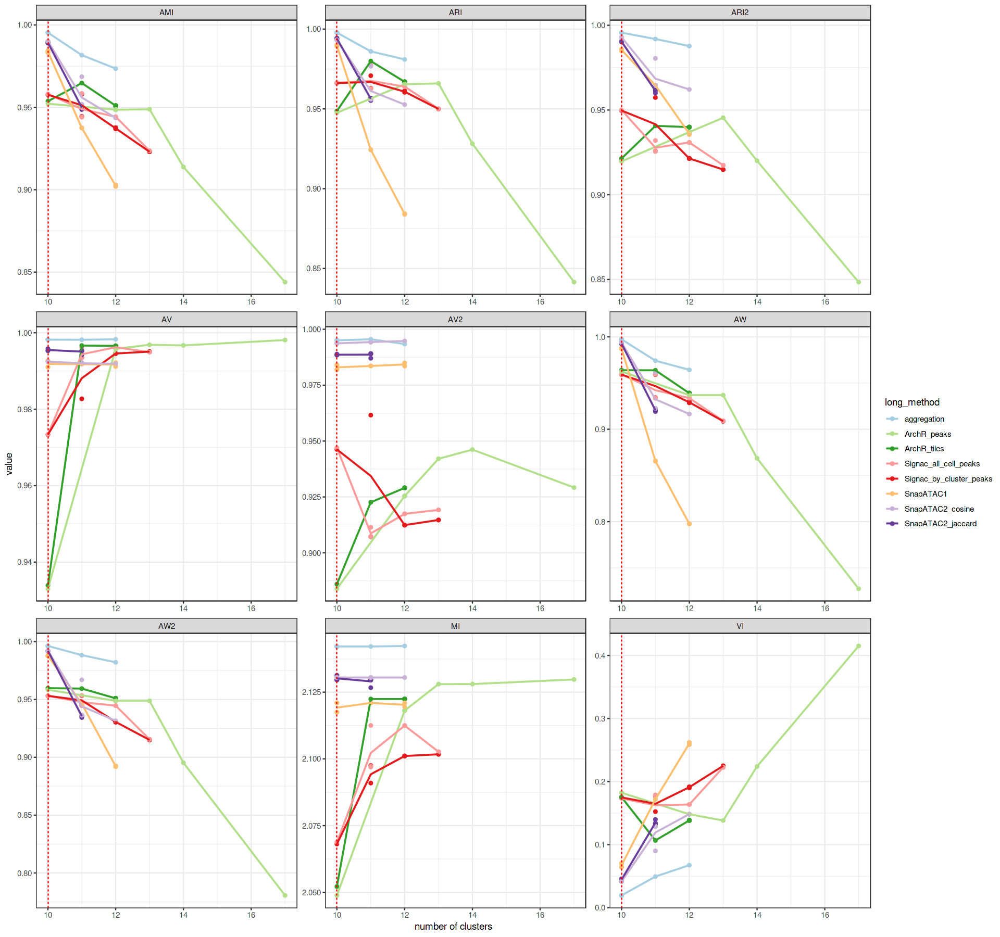

In [ ]:
options(repr.plot.width=16, repr.plot.height=15)

# line plot (fix ndim=50)
p2 <-
df_metrics_external %>% #filter(n_clusters <= 30) %>% #filter(grepl(n,ndim)) %>%
  group_by(long_method, metric, n_clusters) %>%
  mutate(mean_value = mean(value)) %>%
  ggplot(aes(x=n_clusters, y=value, color=long_method)) + 
  geom_point(size=1.5) +
  geom_line(size=0.8, aes(x=n_clusters, y=mean_value, color=long_method)) + 
  facet_wrap(~metric, scales = "free") + 
  xlab("number of clusters") +
  ylab("value") +
  geom_vline(xintercept=k_optimal, color = "red", linetype = "dashed") +
  theme_bw() +
  # geom_errorbar(aes(ymin = min_value, ymax = max_value), width = 0.2, linetype = "dashed") +
  scale_colour_manual(values = brewer.pal(10, "Paired")[c(1,3:6,7,9:10)])
p2

In [7]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]

df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)

df_optimal_k <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(n_clusters_d == min(n_clusters_d)) %>% filter(value == max(value)) %>%
  ungroup()


In [ ]:
df_optimal_k

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9661907,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.05,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/r0.05.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS,0
10,ARI,0.9663607,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.05,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/r0.05.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS,0
10,ARI,0.9486797,ArchR,ArchR_tiles,tiles,500,default,15,0.05,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,0
10,ARI,0.9475770,ArchR,ArchR_peaks,peaks,500,default,15,0.05,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,0
10,ARI,0.9899449,SnapATAC1,SnapATAC1,default,5000,default,15,0.15,Cell_line_mixing/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,0
10,ARI,0.9899449,SnapATAC1,SnapATAC1,default,5000,default,15,0.20,Cell_line_mixing/evaluation/SnapATAC1/default/5000/default/15/r0.2_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/r0.2.tsv,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS,0
10,ARI,0.9977881,aggregation,aggregation,default,500,default,15,0.05,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS,0
10,ARI,0.9977881,aggregation,aggregation,default,500,default,15,0.10,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS,0
10,ARI,0.9977881,aggregation,aggregation,default,500,default,15,0.15,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.15.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS,0


In [ ]:
df_best

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9799582,ArchR,ArchR_tiles,tiles,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
13,ARI,0.9659596,ArchR,ArchR_peaks,peaks,500,default,15,0.30,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
10,ARI,0.9899449,SnapATAC1,SnapATAC1,default,5000,default,15,0.15,Cell_line_mixing/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS
10,ARI,0.9977881,aggregation,aggregation,default,500,default,15,0.05,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS
10,ARI,0.9944054,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.10,Cell_line_mixing/evaluation/SnapATAC2/default/500/jaccard/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC2/default/500/jaccard/15/r0.1.tsv,Cell_line_mixing/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS
10,ARI,0.9931769,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.05,Cell_line_mixing/evaluation/SnapATAC2/default/500/cosine/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC2/default/500/cosine/15/r0.05.tsv,Cell_line_mixing/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS


#### ArchR

Why differ so much between n=15 and n=100?

In [44]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.980 ArchR  ArchR_ti… tiles       500 default    15     0.1
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


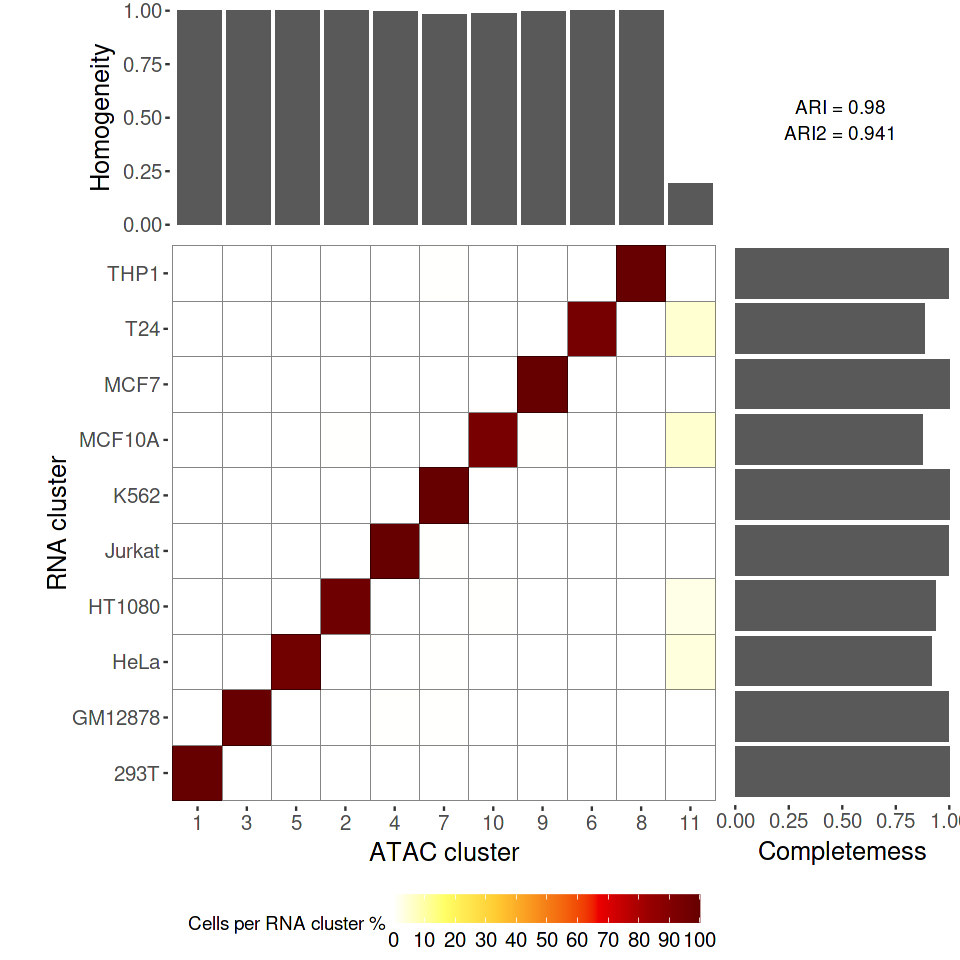

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
print(df_method[i,])
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

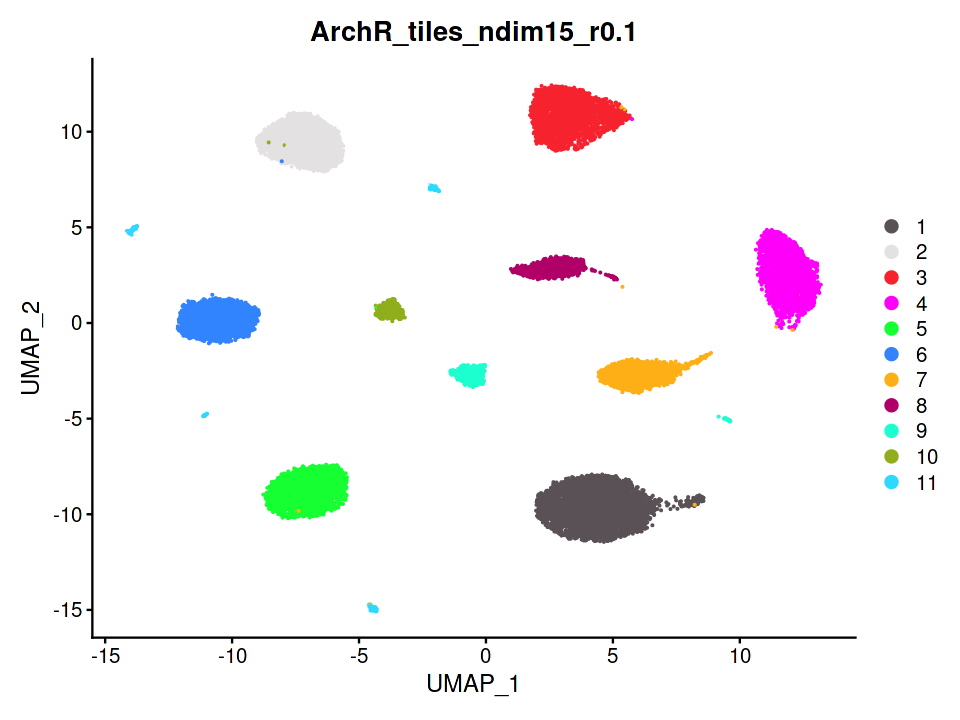

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

In [ ]:
i <- 4
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         13 ARI    0.966 ArchR  ArchR_pe… peaks       500 default    15     0.3
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


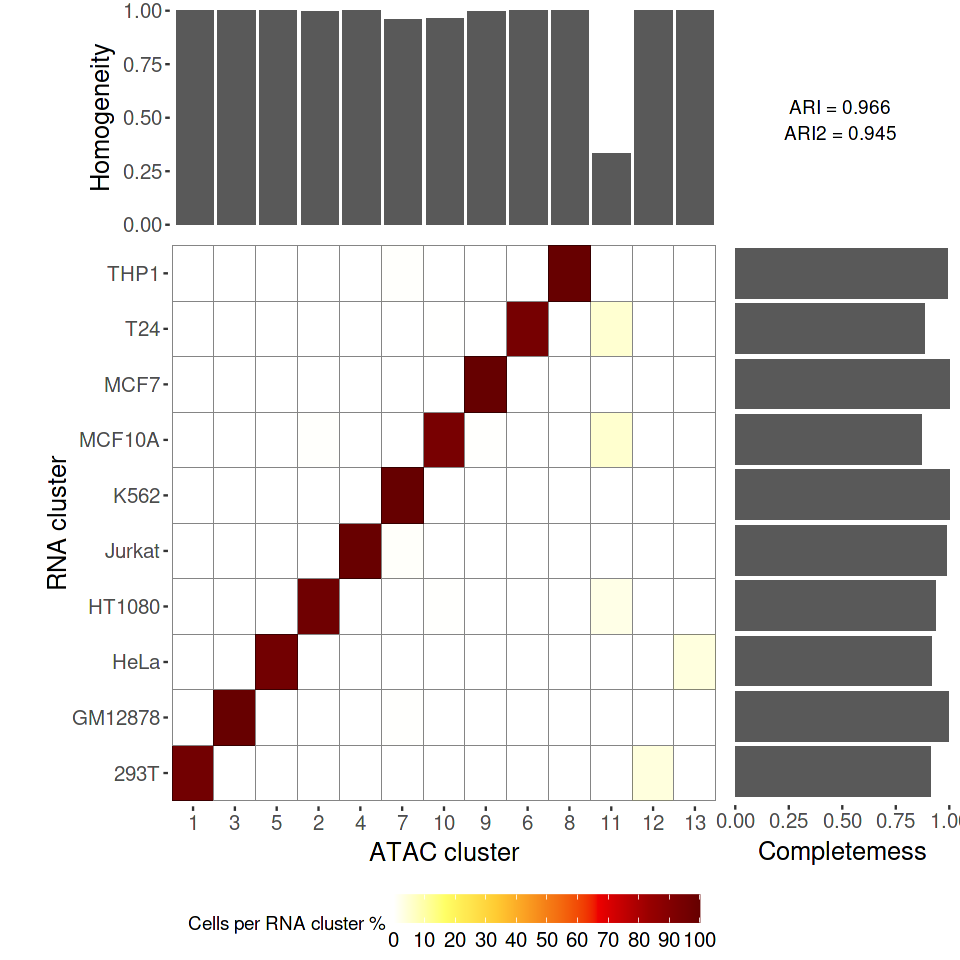

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
print(df_method[i,])
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

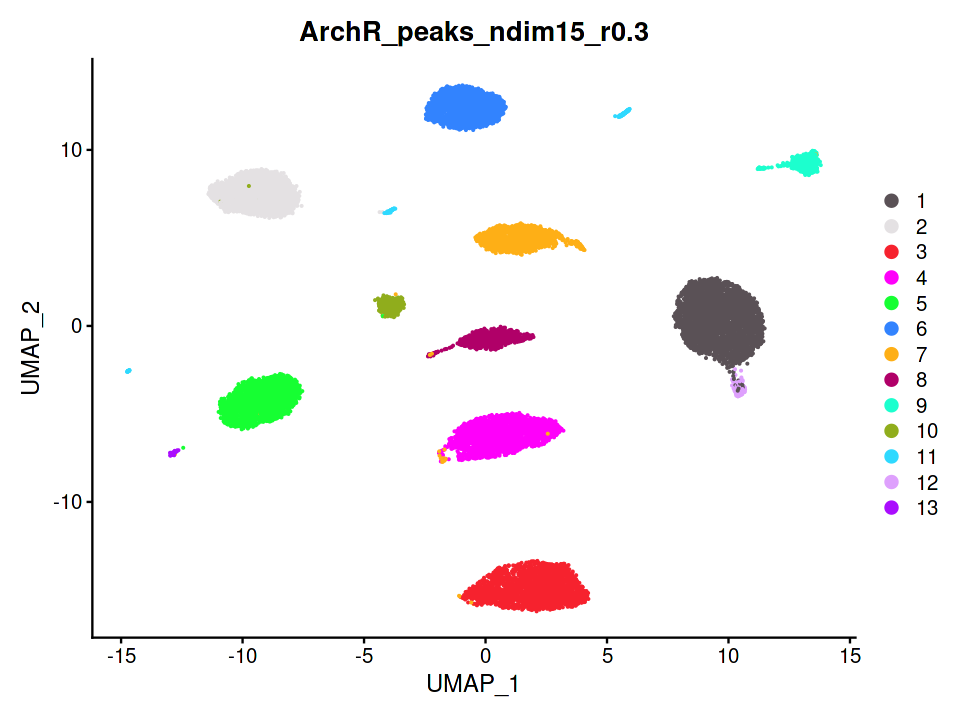

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

The best solutions of ArchR_tiles and ArchR_peaks. Compared to the best solution of ndim=100, they only failed in clustering the outlier clusters to their original class.

Why the performance decrease so much when increase resolution?

In [47]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_peaks") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9475770,ArchR,ArchR_peaks,peaks,500,default,15,0.05,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,0
12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.15,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.15.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.20,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.2_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.2.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.25,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.25_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.25.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
13,ARI,0.9659596,ArchR,ArchR_peaks,peaks,500,default,15,0.30,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,3
14,ARI,0.9282239,ArchR,ArchR_peaks,peaks,500,default,15,0.35,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.35_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.35.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,4
17,ARI,0.8414551,ArchR,ArchR_peaks,peaks,500,default,15,0.40,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.4_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.4.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,7


In [48]:
i <- 7
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         14 ARI    0.928 ArchR  ArchR_pe… peaks       500 default    15    0.35
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


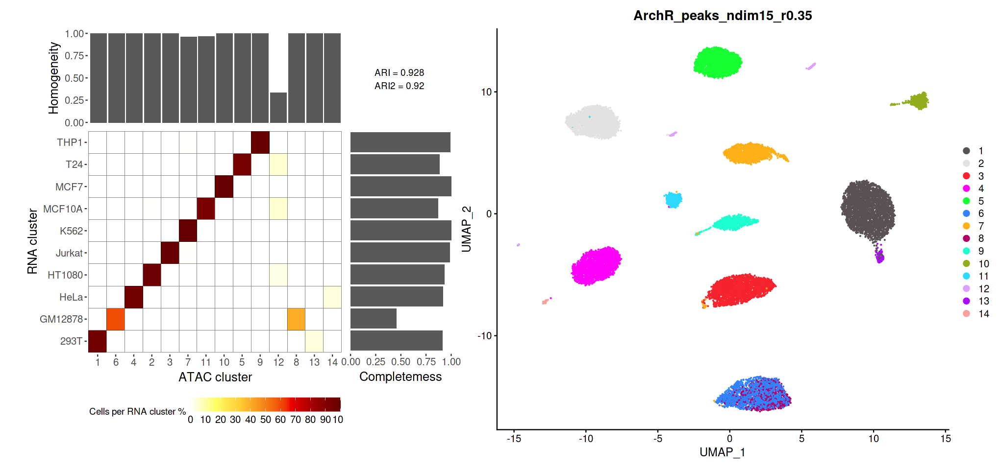

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=17, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

When increase resolution, the ArchR method tends to over-cluster cells randomly.

How about peaks vs tiles?

In [49]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "ArchR_tiles") %>%
  group_by(long_method, n_clusters) %>%
  filter(value == max(value)) %>%
  ungroup()

df_tmp

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
10,ARI,0.9486797,ArchR,ArchR_tiles,tiles,500,default,15,0.05,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,0
11,ARI,0.9799582,ArchR,ArchR_tiles,tiles,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,1
12,ARI,0.9670012,ArchR,ArchR_tiles,tiles,500,default,15,0.15,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.15.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9670012,ArchR,ArchR_tiles,tiles,500,default,15,0.20,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.2_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.2.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9670012,ArchR,ArchR_tiles,tiles,500,default,15,0.25,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.25_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.25.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9670012,ArchR,ArchR_tiles,tiles,500,default,15,0.30,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.3_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.3.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2
12,ARI,0.9670012,ArchR,ArchR_tiles,tiles,500,default,15,0.35,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.35_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.35.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS,2


In [50]:
i <- 7
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


# A tibble: 1 × 14
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         12 ARI    0.967 ArchR  ArchR_ti… tiles       500 default    15    0.35
# … with 4 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, n_clusters_d <dbl>, and abbreviated variable names
#   ¹​long_method, ²​feature_type, ³​tile_size, ⁴​distance, ⁵​resolution


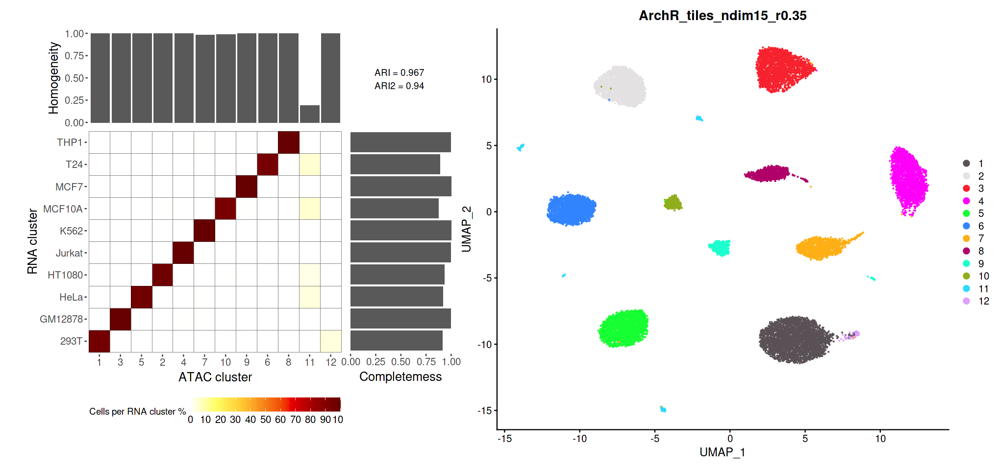

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=17, repr.plot.height=8)
print(df_method[i,])
p1 <- cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

p1 + p2

The same for ArchR_tiles. Using tiles seems to be less prone to over-clustering (not sure).

Check the graph density, data sparsity

In [10]:
library(igraph)


Attaching package: ‘igraph’


The following object is masked from ‘package:class’:

    knn


The following object is masked from ‘package:tidyr’:

    crossing


The following objects are masked from ‘package:dplyr’:

    as_data_frame, groups, union


The following objects are masked from ‘package:stats’:

    decompose, spectrum


The following object is masked from ‘package:base’:

    union




In [11]:
names(sobj1@graphs)

[1] "nn_ndim15"  "snn_ndim15"

In [53]:
g1 <- sobj1@graphs[['snn_ndim15']]
attributes(g1)$class <- "dgCMatrix"
g1 <- igraph::graph_from_adjacency_matrix(adjmatrix = g1, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

#### Signac: why the performance is lower than all the other methods

In [21]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.971 Signac Signac_b… by_clu…       0 default    15     0.1
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


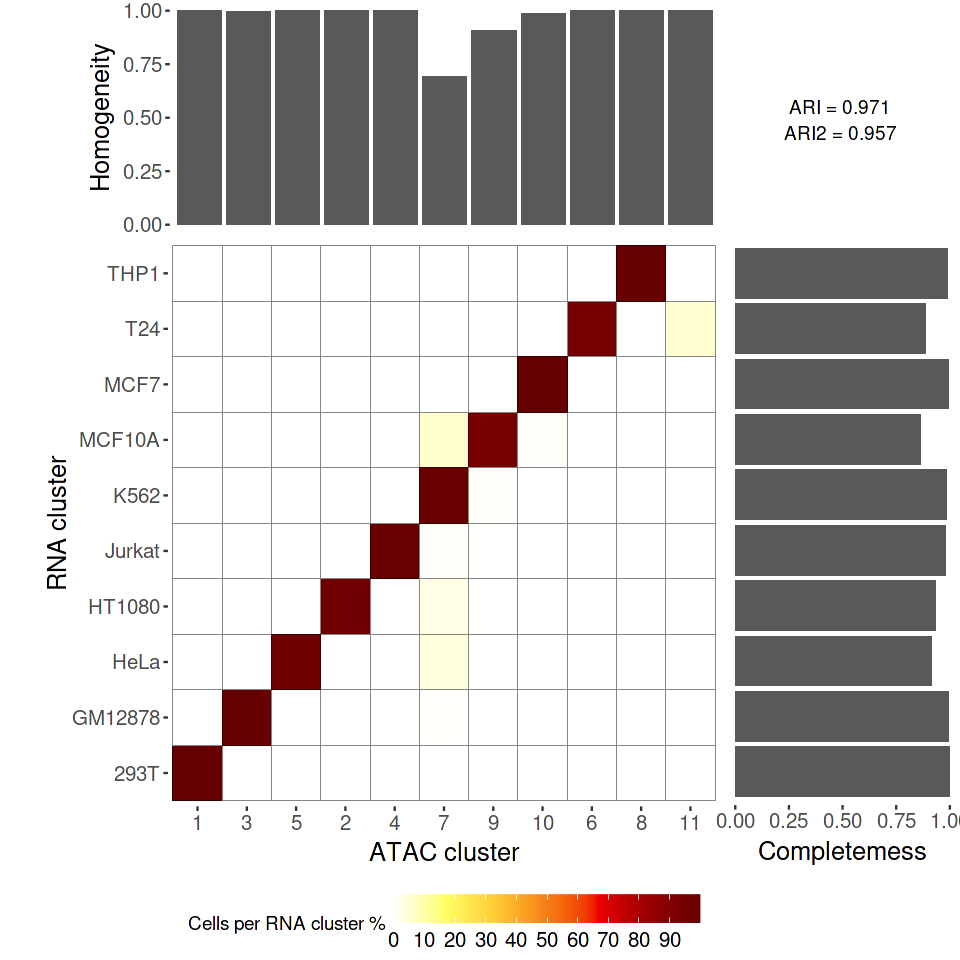

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
print(df_method[i,])
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

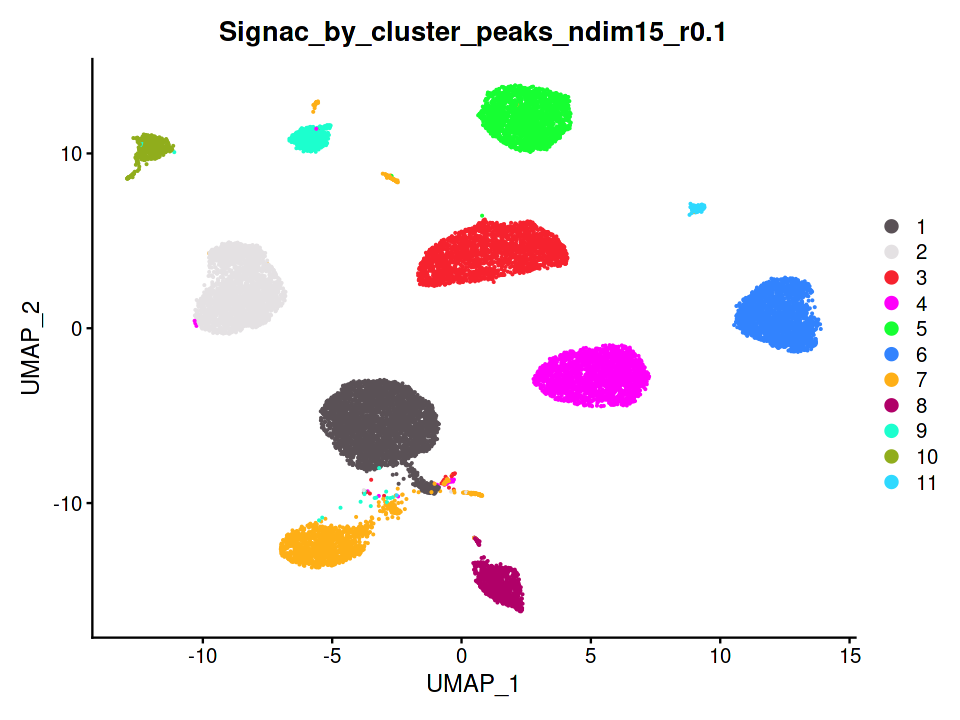

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

In [54]:
i <- 2
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_all_cell_peaks"


# A tibble: 1 × 13
  n_clusters metric value method long_me…¹ featu…² tile_…³ dista…⁴  ndim resol…⁵
       <int> <chr>  <dbl> <chr>  <chr>     <chr>     <int> <chr>   <int>   <dbl>
1         11 ARI    0.977 Signac Signac_a… all_ce…       0 default    15     0.1
# … with 3 more variables: rds_file <chr>, clustering_file <chr>,
#   snn_file <chr>, and abbreviated variable names ¹​long_method, ²​feature_type,
#   ³​tile_size, ⁴​distance, ⁵​resolution


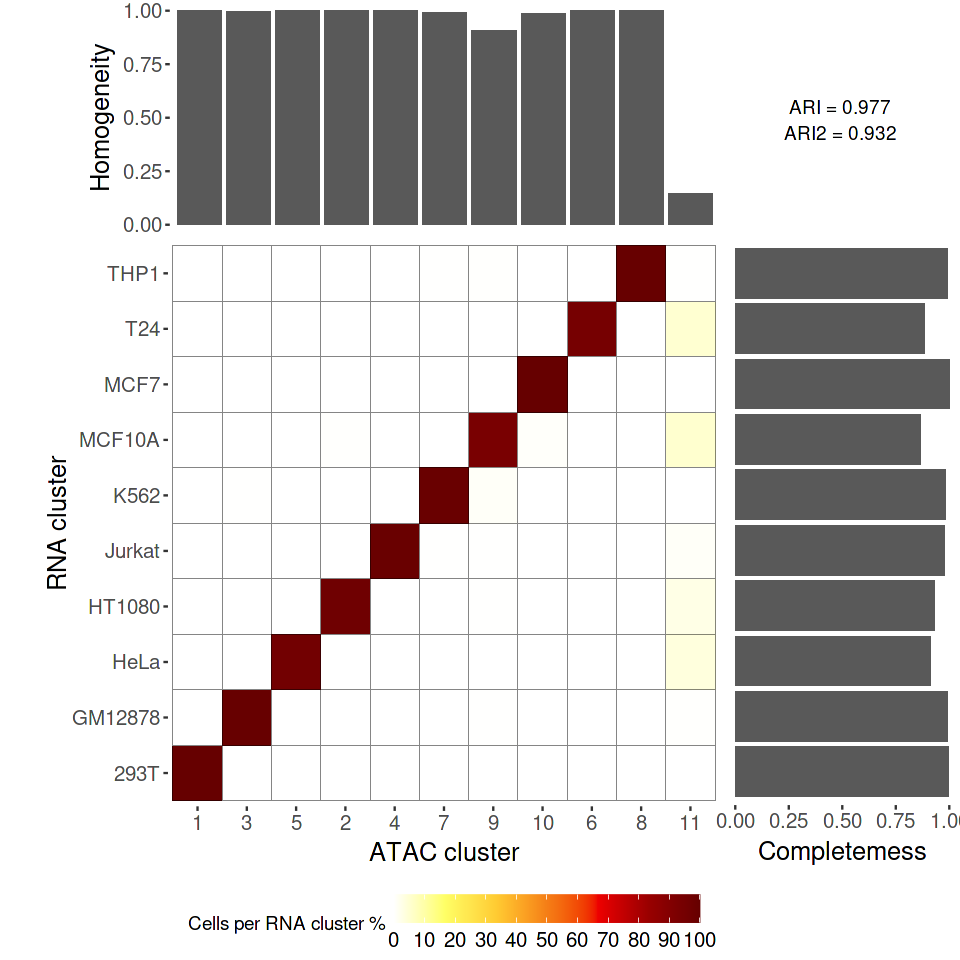

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
print(df_method[i,])
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

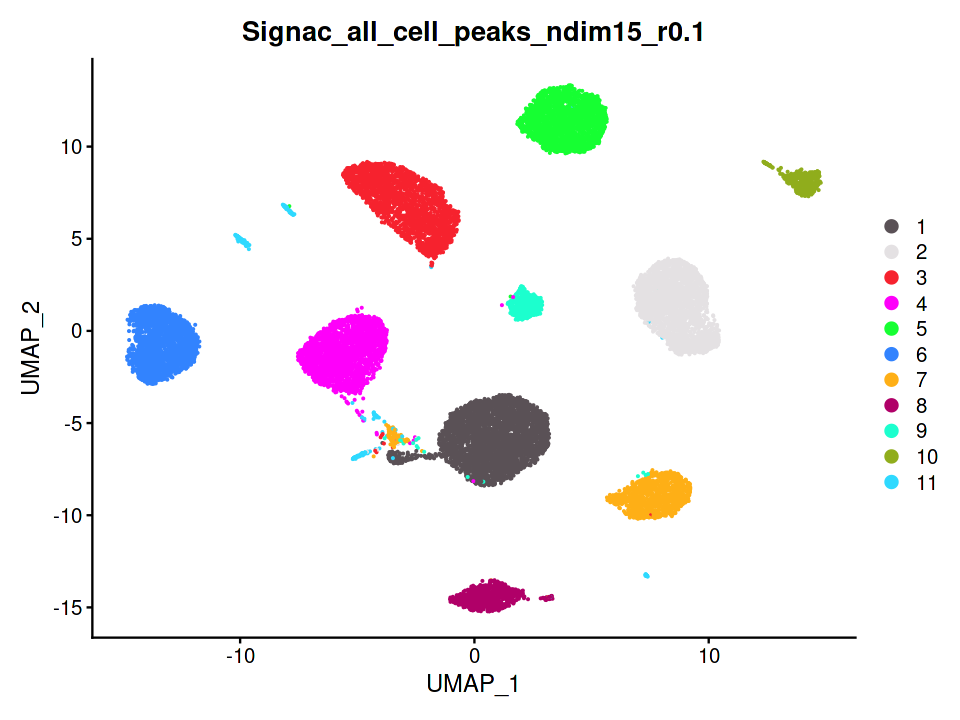

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

Because Signac also failed in resolve outlier clusters to its original class, and when n_cluster=k_optimal, the outlier clusters are grouped into a major cluster.
The "obvious lower" performance is a selection bias. When looking at the solution when n_cluster is larger, it performs well.

In [56]:
g2 <- sobj1@graphs[['snn_ndim15']]
attributes(g2)$class <- "dgCMatrix"
g2 <- igraph::graph_from_adjacency_matrix(adjmatrix = g2, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

#### Aggregation: why the performance changes as the n_cluster increase

In [57]:
df_tmp <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  filter(long_method == "aggregation" & (n_clusters == 11 | n_clusters == 12)) 

In [58]:
df_tmp

,n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
,<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
2159,11,ARI,0.9860419,aggregation,aggregation,default,500,default,15,0.35,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.35_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.35.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS,1
2172,12,ARI,0.9810046,aggregation,aggregation,default,500,default,15,0.40,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.4_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.4.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS,2


In [59]:
i <- 1
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


     n_clusters metric     value      method long_method feature_type tile_size
2159         11    ARI 0.9860419 aggregation aggregation      default       500
     distance ndim resolution
2159  default   15       0.35
                                                                                rds_file
2159 Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.35_evaluation.RDS
                                                              clustering_file
2159 Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.35.tsv
                                                                        snn_file
2159 Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS
     n_clusters_d
2159            1


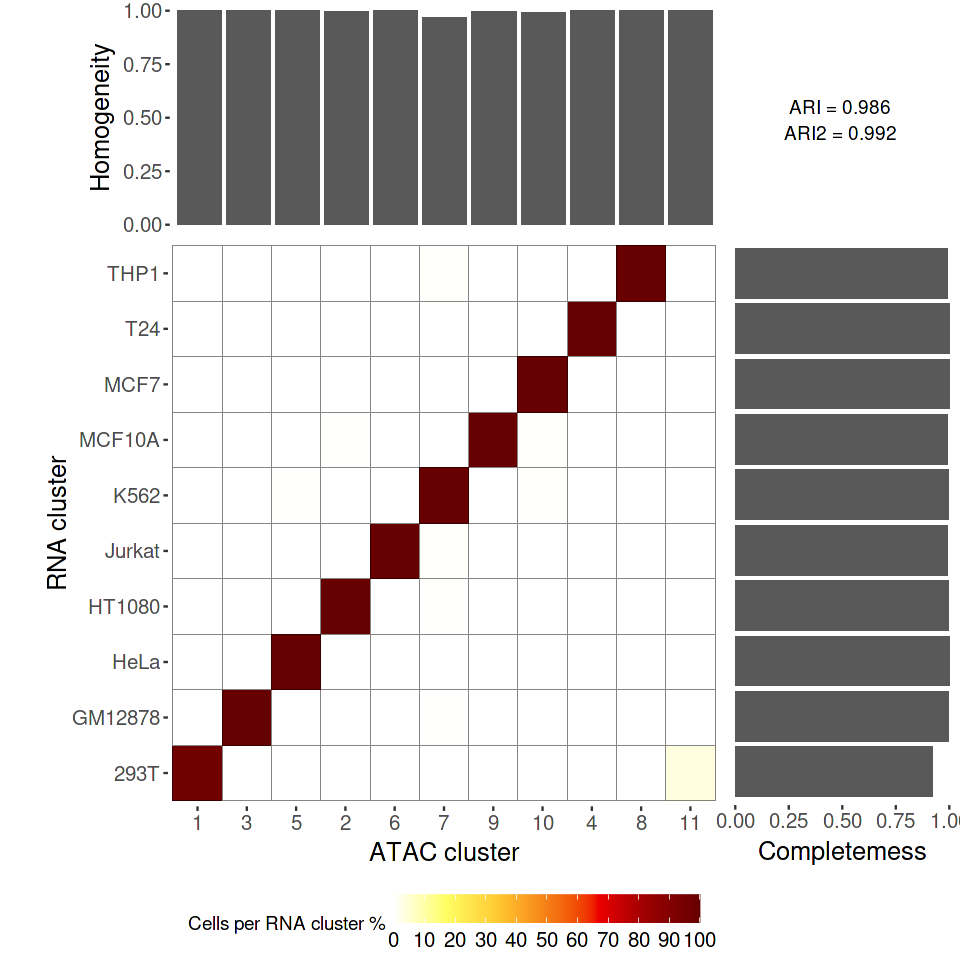

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
print(df_method[i,])
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

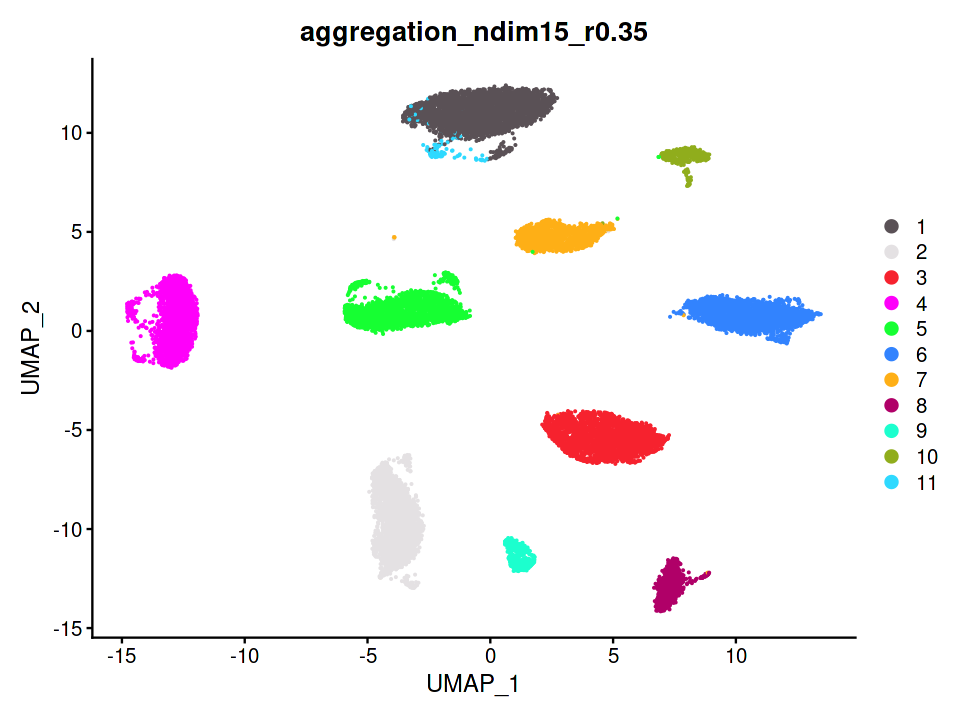

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

In [60]:
g3 <- sobj1@graphs[['snn_ndim15']]
attributes(g3)$class <- "dgCMatrix"
g3 <- igraph::graph_from_adjacency_matrix(adjmatrix = g3, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

In [ ]:
i <- 2
df_method <- df_tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


     n_clusters metric     value      method long_method feature_type tile_size
2172         12    ARI 0.9810046 aggregation aggregation      default       500
     distance ndim resolution
2172  default   15        0.4
                                                                               rds_file
2172 Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.4_evaluation.RDS
                                                             clustering_file
2172 Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.4.tsv
                                                                        snn_file
2172 Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS
     n_clusters_d
2172            2


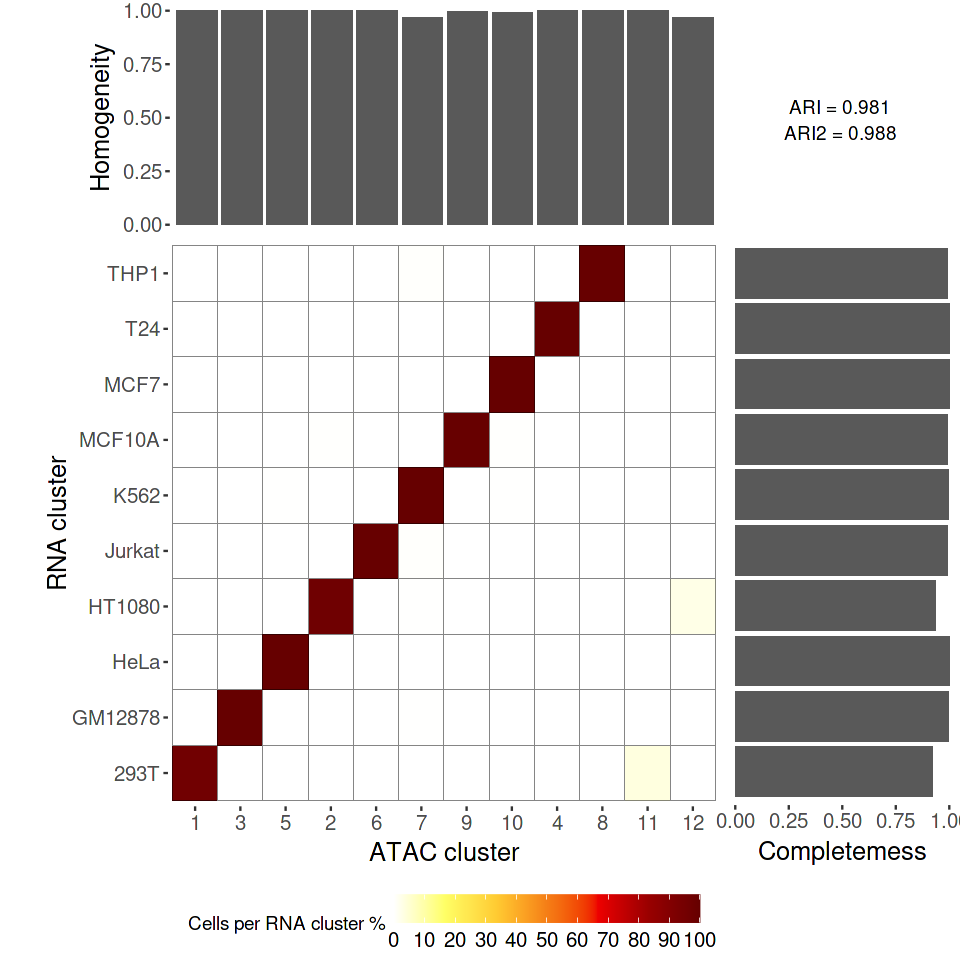

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
print(df_method[i,])
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

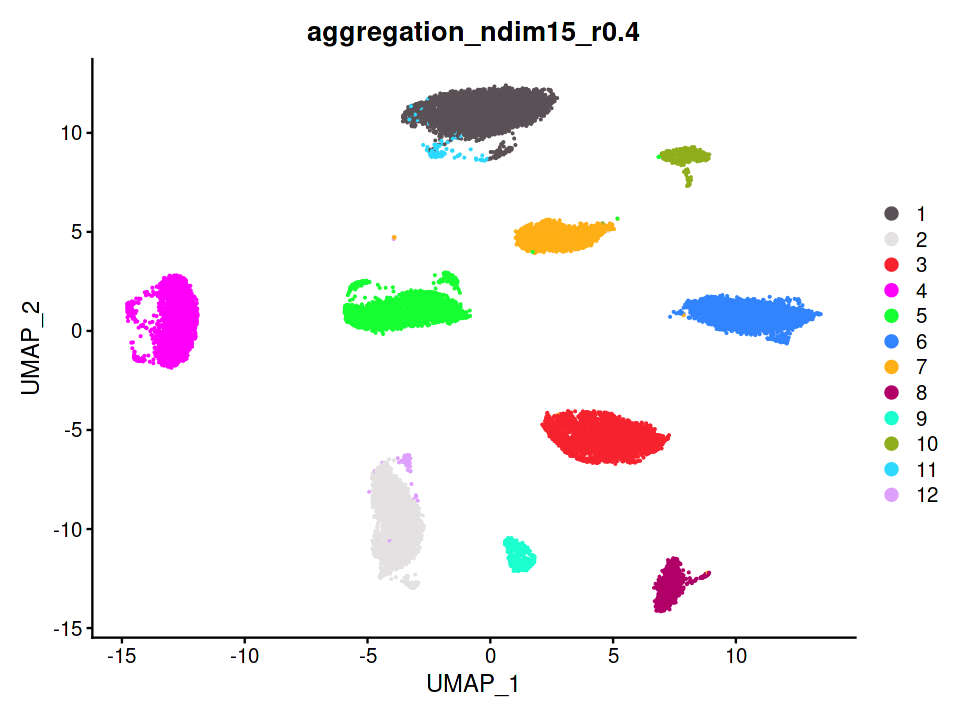

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome")  + ggtitle(paste0(long_method,"_ndim",n, "_r", resolution)) 

When n_cluster increases, it starts to randomly seperate clusters. So n_cluster = k_optimal is the best soluiton.

#### SnapATAC1/2

The performance decrease as the n_clusters increase; The external evaluation performance is very robust across ndim values, but the UMAP and internal evaluation deteriorate as ndim increases.

In [9]:
df_best

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9799582,ArchR,ArchR_tiles,tiles,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
13,ARI,0.9659596,ArchR,ArchR_peaks,peaks,500,default,15,0.30,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
10,ARI,0.9899449,SnapATAC1,SnapATAC1,default,5000,default,15,0.15,Cell_line_mixing/evaluation/SnapATAC1/default/5000/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/r0.15.tsv,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/15/sobj_SNN.RDS
10,ARI,0.9977881,aggregation,aggregation,default,500,default,15,0.05,Cell_line_mixing/evaluation/aggregation/default/500/default/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/15/r0.05.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/15/sobj_SNN.RDS
10,ARI,0.9944054,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,15,0.10,Cell_line_mixing/evaluation/SnapATAC2/default/500/jaccard/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC2/default/500/jaccard/15/r0.1.tsv,Cell_line_mixing/clustering/SnapATAC2/default/500/jaccard/15/sobj_SNN.RDS
10,ARI,0.9931769,SnapATAC2,SnapATAC2_cosine,default,500,cosine,15,0.05,Cell_line_mixing/evaluation/SnapATAC2/default/500/cosine/15/r0.05_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC2/default/500/cosine/15/r0.05.tsv,Cell_line_mixing/clustering/SnapATAC2/default/500/cosine/15/sobj_SNN.RDS


In [10]:
i <- 5
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]
resolution <- df_method$resolution[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "SnapATAC1"


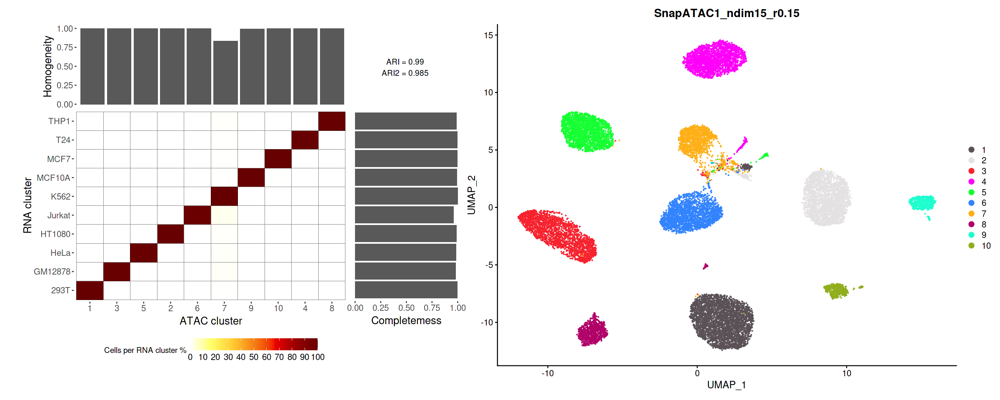

In [13]:
options(repr.plot.width=20, repr.plot.height=8)
p1 <- cross_table_plot(ground_truth, clusterings, a=1.3, b=2, c=2)
p2 <- DimPlot(sobj2, reduction = "umap", label = F, repel=T, 
        group.by = "ground_truth", cols="polychrome") + ggtitle(paste0(long_method, "_ndim", n, "_r", resolution)) 
p1 + p2

In [ ]:
# options(repr.plot.width=8, repr.plot.height=8)

fig.path <- "figures/best_ARI/"
dir.create("figures/")
dir.create("figures/best_ARI/")

df_method <- df_best

for (i in 1:dim(df_best)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)

    at <- paste0("resolution = ", df_method$resolution[i])
    bt <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8, height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,at, pos=4)
    text(1,3,bt, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2))
    dev.off()
}

[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


In [ ]:
df_method <- df_optimal_k

fig.path <- "figures/optimal_k/"
dir.create("figures/")
dir.create("figures/optimal_k/")

options(repr.plot.width=8, repr.plot.height=8)

for (i in 1:dim(df_method)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)
    a <- paste0("resolution = ", df_method$resolution[i])
    b <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8, height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,a, pos=4)
    text(1,3,b, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "SnapATAC1"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"
[1] "SnapATAC2_cosine"
[1] "SnapATAC2_cosine"


Select solutions

In [ ]:
tmp <- df_metrics_external %>%
  filter(long_method == "ArchR_peaks" & ndim == 15 & n_clusters == 12 & metric == "ARI")

In [ ]:
tmp

,n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file,n_clusters_d
,<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<dbl>
1262,12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
1275,12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.15,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.15_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.15.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
1288,12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.20,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.2_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.2.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2
1301,12,ARI,0.9654547,ArchR,ArchR_peaks,peaks,500,default,15,0.25,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.25_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.25.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS,2


In [ ]:
i <- 1
df_method <- tmp
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_peaks"


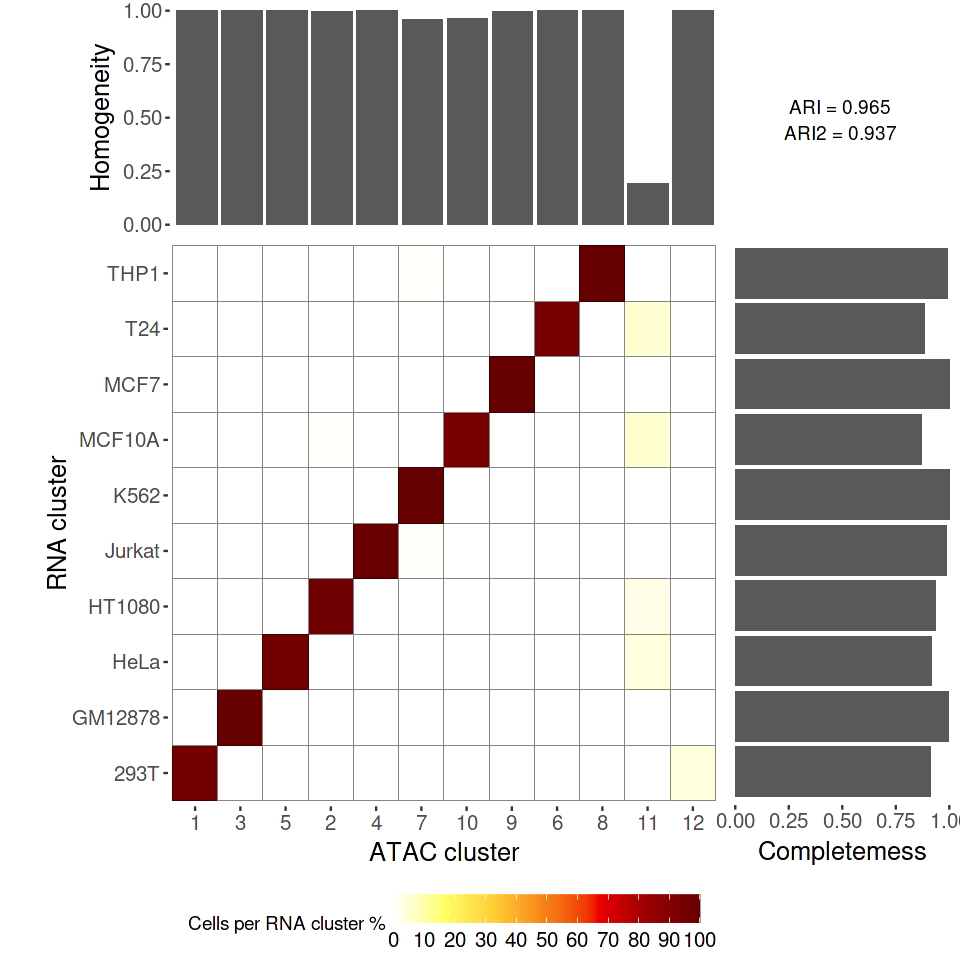

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)

cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

### ndim=100

In [67]:
# For this dataset, the ArchR performs better when n==100 than when n==15. Check both
j <- 3
n <- 100

dataset <- dataset_ls[j]
k_optimal <- k_ls[j]

setwd(paste0("/home/siluo/public/SiyuanLuo/projects/benchmark/outputs/", dataset))
df <- read.table(file="meta_info_for_evaluation.tsv", sep="\t", header=TRUE)
df_metrics <- read.table(file="metrics_value.tsv", sep="\t", header=TRUE)

df_metrics_selected <- df_metrics[!as.logical(df_metrics$metric %in% c("Silhouette_label", "Silhouette", "cLISI_label", "cLISI")),]
df_metrics_external <- df_metrics_selected %>% filter(ndim == n)

In [ ]:
df_tmp <- df_metrics_selected
df_tmp$dataset <- dataset
df_metrics_all <- rbind(df_metrics_all, df_tmp)

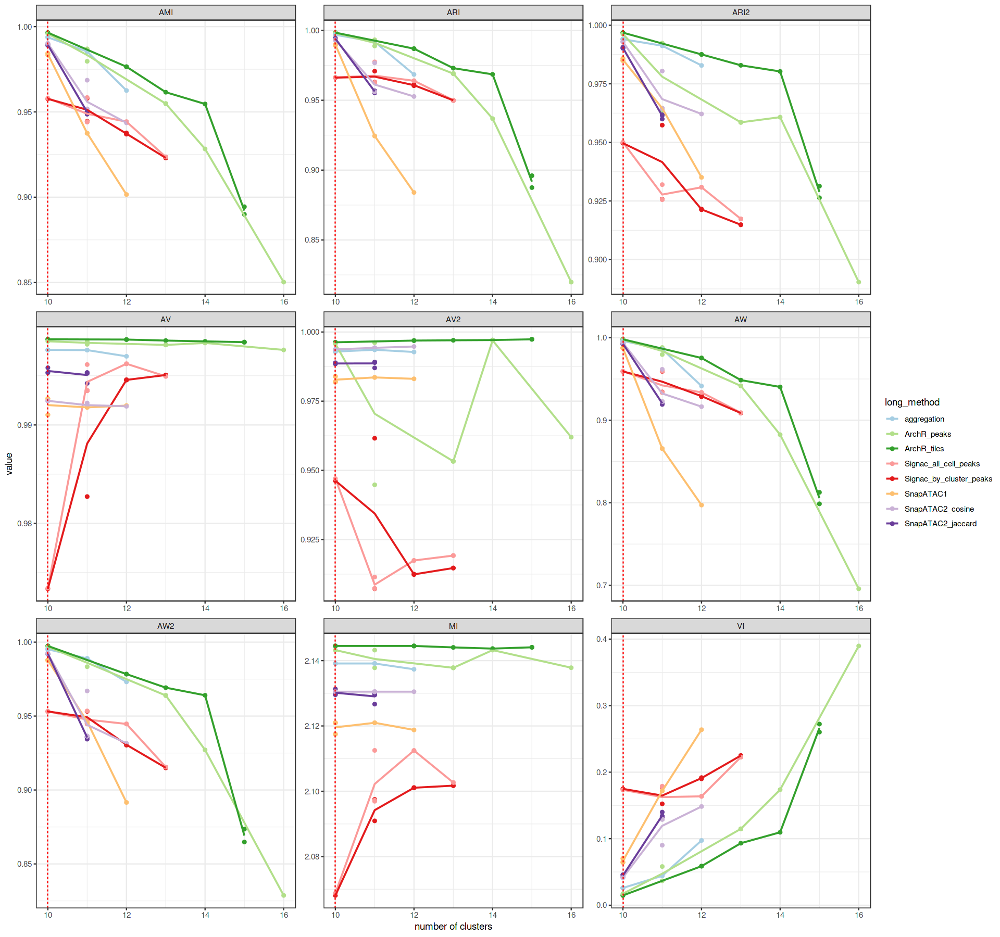

In [ ]:
options(repr.plot.width=16, repr.plot.height=15)

# line plot (fix ndim=50)
p2 <-
df_metrics_external %>% #filter(n_clusters <= 30) %>% #filter(grepl(n,ndim)) %>%
  group_by(long_method, metric, n_clusters) %>%
  mutate(mean_value = mean(value)) %>%
  ggplot(aes(x=n_clusters, y=value, color=long_method)) + 
  geom_point(size=1.5) +
  geom_line(size=0.8, aes(x=n_clusters, y=mean_value, color=long_method)) + 
  facet_wrap(~metric, scales = "free") + 
  xlab("number of clusters") +
  ylab("value") +
  geom_vline(xintercept=k_optimal, color = "red", linetype = "dashed") +
  theme_bw() +
  # geom_errorbar(aes(ymin = min_value, ymax = max_value), width = 0.2, linetype = "dashed") +
  scale_colour_manual(values = brewer.pal(10, "Paired")[c(1,3:6,7,9:10)])
p2

In [68]:
df_best <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(value == max(value)) %>%
  ungroup()

df_best<- df_best[!duplicated(df_best[, c("long_method")]), ]

df_metrics_external$n_clusters_d <- abs(df_metrics_external$n_clusters - k_optimal)

df_optimal_k <- df_metrics_external[df_metrics_external$metric=="ARI",]  %>%
  group_by(long_method) %>%
  filter(n_clusters_d == min(n_clusters_d)) %>% filter(value == max(value)) %>%
  ungroup()


In [72]:
df_best

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,100,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/100/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/100/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,100,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/100/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/100/sobj_SNN.RDS
10,ARI,0.9983950,ArchR,ArchR_tiles,tiles,500,default,100,0.05,Cell_line_mixing/evaluation/ArchR/tiles/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/sobj_SNN.RDS
10,ARI,0.9981178,ArchR,ArchR_peaks,peaks,500,default,100,0.05,Cell_line_mixing/evaluation/ArchR/peaks/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/100/sobj_SNN.RDS
10,ARI,0.9899449,SnapATAC1,SnapATAC1,default,5000,default,100,0.15,Cell_line_mixing/evaluation/SnapATAC1/default/5000/default/100/r0.15_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/100/r0.15.tsv,Cell_line_mixing/clustering/SnapATAC1/default/5000/default/100/sobj_SNN.RDS
10,ARI,0.9968485,aggregation,aggregation,default,500,default,100,0.05,Cell_line_mixing/evaluation/aggregation/default/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/aggregation/default/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/aggregation/default/500/default/100/sobj_SNN.RDS
10,ARI,0.9944054,SnapATAC2,SnapATAC2_jaccard,default,500,jaccard,100,0.10,Cell_line_mixing/evaluation/SnapATAC2/default/500/jaccard/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC2/default/500/jaccard/100/r0.1.tsv,Cell_line_mixing/clustering/SnapATAC2/default/500/jaccard/100/sobj_SNN.RDS
10,ARI,0.9931769,SnapATAC2,SnapATAC2_cosine,default,500,cosine,100,0.05,Cell_line_mixing/evaluation/SnapATAC2/default/500/cosine/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/SnapATAC2/default/500/cosine/100/r0.05.tsv,Cell_line_mixing/clustering/SnapATAC2/default/500/cosine/100/sobj_SNN.RDS


In [69]:
i <- 3
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "ArchR_tiles"


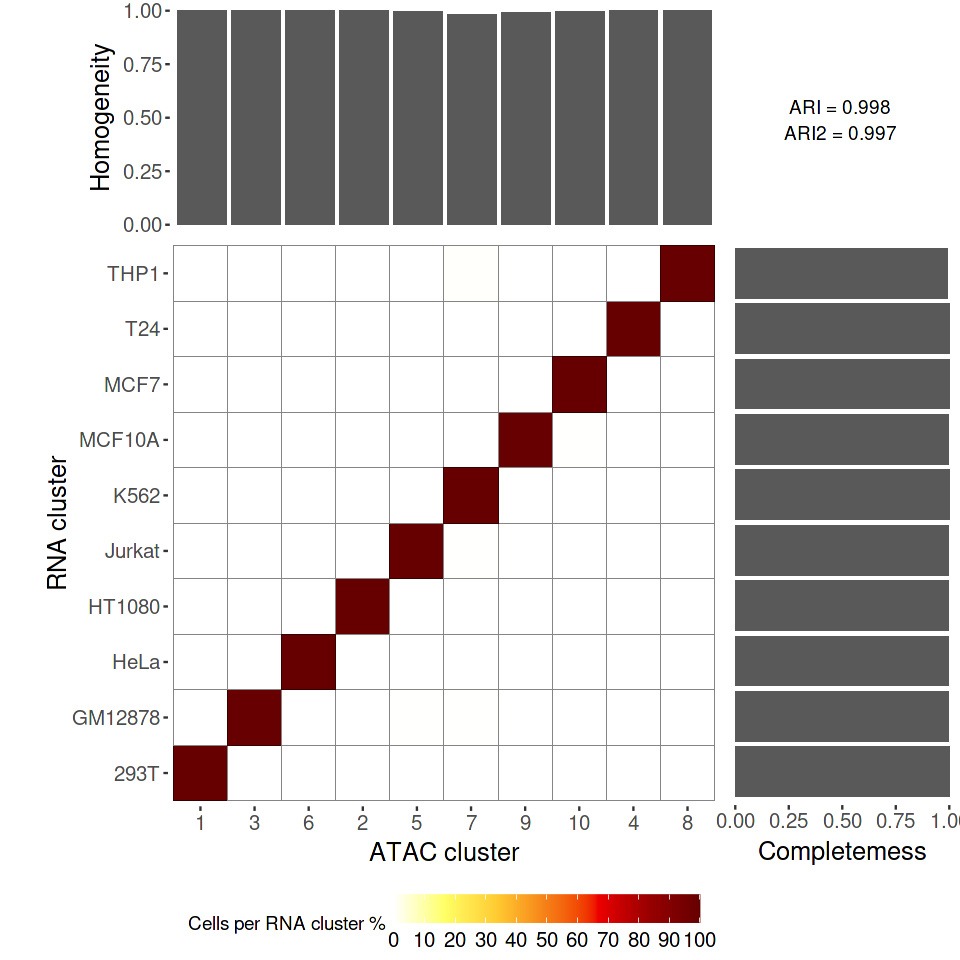

In [ ]:
# check if the value of a,b,c is appropriate
options(repr.plot.width=8, repr.plot.height=8)
cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2)

In [71]:
# archr, ndim=100
g4 <- sobj1@graphs[['snn_ndim100']]
attributes(g4)$class <- "dgCMatrix"
g4 <- igraph::graph_from_adjacency_matrix(adjmatrix = g4, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

In [73]:
i <- 1
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "Signac_by_cluster_peaks"


In [74]:
# signac, ndim=100
g5 <- sobj1@graphs[['snn_ndim100']]
attributes(g5)$class <- "dgCMatrix"
g5 <- igraph::graph_from_adjacency_matrix(adjmatrix = g5, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

In [75]:
i <- 6
df_method <- df_best
method <- df_method$method[i]
feature_type <- df_method$feature_type[i]
tile_size <- df_method$tile_size[i]
distance <- df_method$distance[i]
long_method <- df_method$long_method[i]

sobj_file <- df_method$snn_file[i]
clustering_file <- df_method$clustering_file[i]

sobj1 <- readRDS(sobj_file)
sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

ground_truth <- sobj1$ground_truth
clusterings <- sobj2$ground_truth

print(long_method)

[1] "aggregation"


In [76]:
# agg, ndim=100
g6 <- sobj1@graphs[['snn_ndim100']]
attributes(g6)$class <- "dgCMatrix"
g6 <- igraph::graph_from_adjacency_matrix(adjmatrix = g6, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

In [ ]:
# options(repr.plot.width=8, repr.plot.height=8)

fig.path <- "figures/best_ARI/"
dir.create("figures/")
dir.create("figures/best_ARI/")

df_method <- df_best

for (i in 1:dim(df_best)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)

    at <- paste0("resolution = ", df_method$resolution[i])
    bt <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8, height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,at, pos=4)
    text(1,3,bt, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"


In [ ]:
df_method <- df_optimal_k

fig.path <- "figures/optimal_k/"
dir.create("figures/")
dir.create("figures/optimal_k/")

options(repr.plot.width=8, repr.plot.height=8)

for (i in 1:dim(df_method)[1]){
    method <- df_method$method[i]
    feature_type <- df_method$feature_type[i]
    tile_size <- df_method$tile_size[i]
    distance <- df_method$distance[i]
    long_method <- df_method$long_method[i]

    sobj_file <- df_method$snn_file[i]
    clustering_file <- df_method$clustering_file[i]

    sobj1 <- readRDS(sobj_file)
    sobj2 <- add_labels(sobj1, clustering_file, "barcode", "clusterings")

    ground_truth <- sobj1$ground_truth
    clusterings <- sobj2$ground_truth

    print(long_method)
    a <- paste0("resolution = ", df_method$resolution[i])
    b <- paste0("ndim = ", df_method$ndim[i])

    
    pdf(paste0(fig.path, long_method, '.pdf'),width=8, height=8)
    plot(NA, xlim=c(0,5), ylim=c(0,5), bty='n',
     xaxt='n', yaxt='n', xlab='', ylab='')
    text(1,4,a, pos=4)
    text(1,3,b, pos=4)
    # points(rep(1,4),1:4, pch=15)
    print(cross_table_plot(ground_truth, clusterings, a=1.3, b=1.9, c=2))
    dev.off()
}

Warning message in dir.create("figures/"):
“'figures' already exists”


[1] "Signac_by_cluster_peaks"
[1] "Signac_all_cell_peaks"
[1] "ArchR_tiles"
[1] "ArchR_tiles"
[1] "ArchR_peaks"
[1] "SnapATAC1"
[1] "SnapATAC1"
[1] "SnapATAC1"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "aggregation"
[1] "SnapATAC2_jaccard"
[1] "SnapATAC2_cosine"
[1] "SnapATAC2_cosine"
[1] "SnapATAC2_cosine"


### Check the difference between snn graphs

In [98]:
df_tmp <- df_metrics_selected[df_metrics_selected$metric=="ARI",]  %>%
  group_by(long_method, ndim) %>%
  filter(value == max(value)) %>%
  filter(ndim == 100 | ndim == 15) %>%
  ungroup()

df_tmp
df_method <- df_tmp
dim(df_tmp)

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,100,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/100/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/100/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,100,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/100/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/100/sobj_SNN.RDS
11,ARI,0.9799582,ArchR,ArchR_tiles,tiles,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
10,ARI,0.9983950,ArchR,ArchR_tiles,tiles,500,default,100,0.05,Cell_line_mixing/evaluation/ArchR/tiles/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/sobj_SNN.RDS
10,ARI,0.9983950,ArchR,ArchR_tiles,tiles,500,default,100,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/sobj_SNN.RDS
13,ARI,0.9659596,ArchR,ArchR_peaks,peaks,500,default,15,0.30,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
10,ARI,0.9981178,ArchR,ArchR_peaks,peaks,500,default,100,0.05,Cell_line_mixing/evaluation/ArchR/peaks/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/100/sobj_SNN.RDS


[1] 33 13

In [99]:
i <- 33
sobj_file <- df_method$snn_file[i]
sobj1 <- readRDS(sobj_file)

print(sobj_file)

g7 <- sobj1@graphs[['snn_ndim100']]
attributes(g7)$class <- "dgCMatrix"
g7 <- igraph::graph_from_adjacency_matrix(adjmatrix = g7, mode = "undirected", weighted = TRUE, add.colnames = TRUE)

[1] "aggregation"


In [101]:
#agg 
nv <- length(V(g7)) #number of vertices
nv
graph.density(g7)  #density
sum(E(g7)$weight)/(nv*(nv-1)/2) #weighted density

[1] 18538

[1] 0.003787033

[1] 0.0006834733

In [102]:
length(E(g7))

[1] 650686

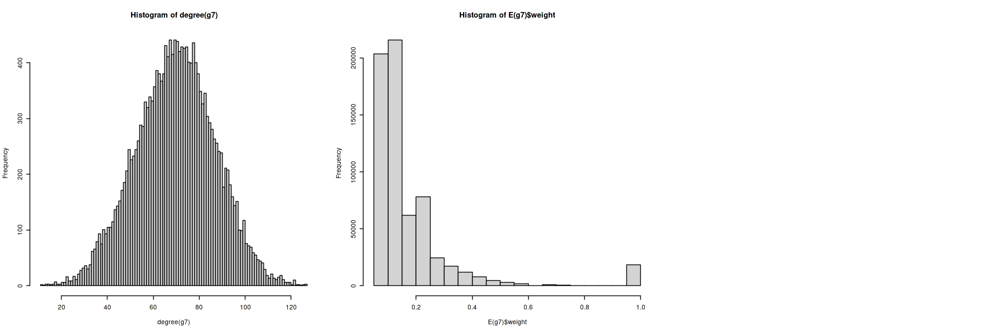

In [103]:
par(mfrow=c(1,3))
hist(degree(g7), breaks=100); hist(E(g7)$weight, breaks=20)

In [77]:
# archr 
nv <- length(V(g1)) #number of vertices
nv
graph.density(g1)  #density
sum(E(g1)$weight)/(nv*(nv-1)/2) #weighted density

# signac
nv <- length(V(g2)) #number of vertices
nv
graph.density(g2)  #density
sum(E(g2)$weight)/(nv*(nv-1)/2) #weighted density

#agg 
nv <- length(V(g3)) #number of vertices
nv
graph.density(g3)  #density
sum(E(g3)$weight)/(nv*(nv-1)/2) #weighted density

# archr 
nv <- length(V(g4)) #number of vertices
nv
graph.density(g4)  #density
sum(E(g4)$weight)/(nv*(nv-1)/2) #weighted density

# signac
nv <- length(V(g5)) #number of vertices
nv
graph.density(g5)  #density
sum(E(g5)$weight)/(nv*(nv-1)/2) #weighted density

#agg 
nv <- length(V(g6)) #number of vertices
nv
graph.density(g6)  #density
sum(E(g6)$weight)/(nv*(nv-1)/2) #weighted density

[1] 18538

[1] 0.003937435

[1] 0.0007185268

[1] 18538

[1] 0.003463025

[1] 0.0007292881

[1] 18538

[1] 0.004035154

[1] 0.0006592114

[1] 18538

[1] 0.003959051

[1] 0.0007237469

[1] 18538

[1] 0.003436252

[1] 0.000733594

[1] 18538

[1] 0.004043698

[1] 0.000689105

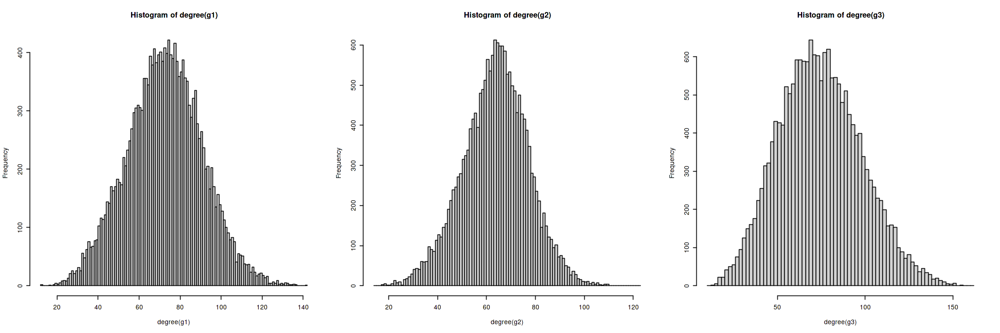

In [62]:
options(repr.plot.width=18, repr.plot.height=6)
par(mfrow=c(1,3))
hist(degree(g1), breaks=100); hist(degree(g2), breaks=100); hist(degree(g3), breaks=100)

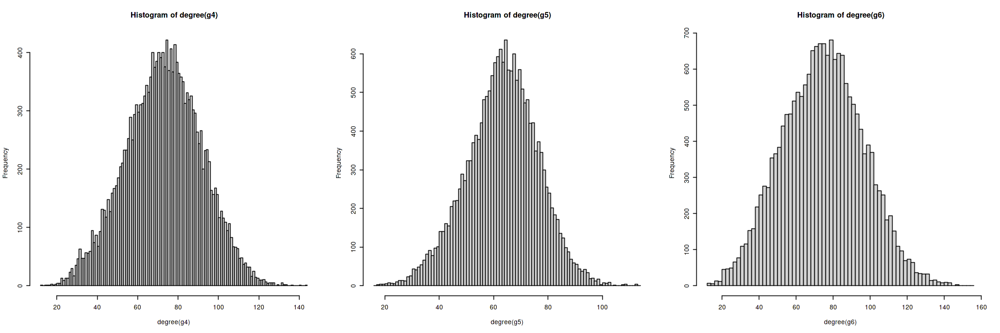

In [78]:
options(repr.plot.width=18, repr.plot.height=6)
par(mfrow=c(1,3))
hist(degree(g4), breaks=100); hist(degree(g5), breaks=100); hist(degree(g6), breaks=100)

In [83]:
(693318-595015)/693318

[1] 0.1417863

In [79]:
length(E(g1))
length(E(g2))
length(E(g3))
length(E(g4))
length(E(g5))
length(E(g6))

[1] 676528

[1] 595015

[1] 693318

[1] 680242

[1] 590415

[1] 694786

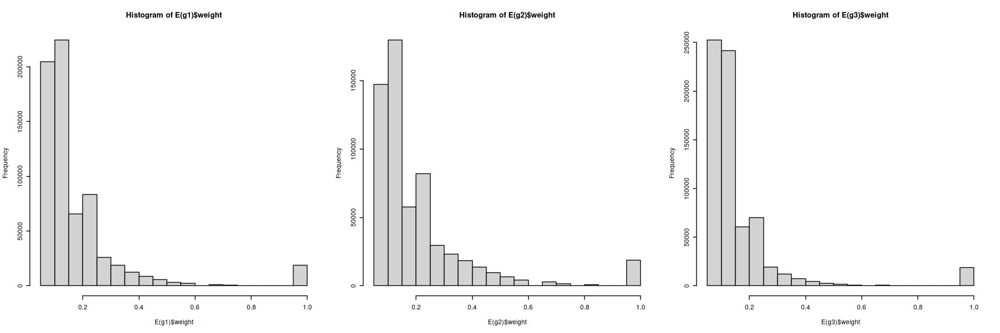

In [63]:
options(repr.plot.width=18, repr.plot.height=6)
par(mfrow=c(1,3))
hist(E(g1)$weight, breaks=20);hist(E(g2)$weight, breaks=20);hist(E(g3)$weight, breaks=20)

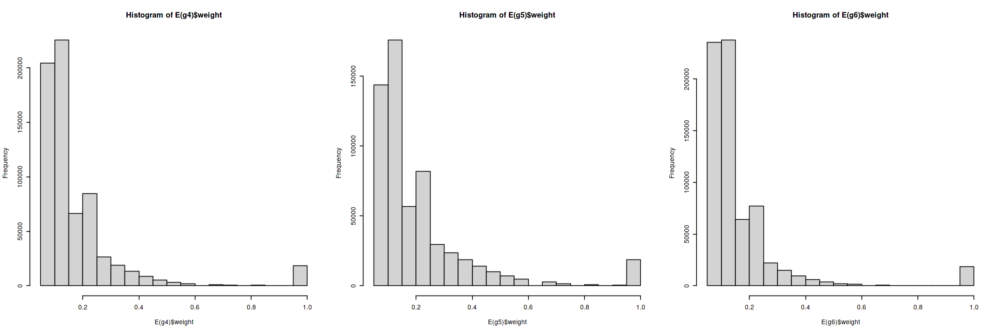

In [80]:
options(repr.plot.width=18, repr.plot.height=6)
par(mfrow=c(1,3))
hist(E(g4)$weight, breaks=20);hist(E(g5)$weight, breaks=20);hist(E(g6)$weight, breaks=20)

Didn't see much difference between methods in terms of their graph structure. Possible reasons:
1. All methods have relatively close performance, so the difference is not profound
2. The performance difference is mainly due to the outlier clusters, e.g. in ArchR's solution, so it is not very profound in the global difference of the graph structure.

### Check the embedding matrix

In [14]:
df_tmp <- df_metrics_selected[df_metrics_selected$metric=="ARI",]  %>%
  group_by(long_method, ndim) %>%
  filter(value == max(value)) %>%
  filter(ndim == 100 | ndim == 15) %>%
  ungroup()

df_tmp
df_method <- df_tmp
dim(df_tmp)

n_clusters,metric,value,method,long_method,feature_type,tile_size,distance,ndim,resolution,rds_file,clustering_file,snn_file
<int>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9708071,Signac,Signac_by_cluster_peaks,by_cluster_peaks,0,default,100,0.10,Cell_line_mixing/evaluation/Signac/by_cluster_peaks/0/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/100/r0.1.tsv,Cell_line_mixing/clustering/Signac/by_cluster_peaks/0/default/100/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,15,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/15/sobj_SNN.RDS
11,ARI,0.9774658,Signac,Signac_all_cell_peaks,all_cell_peaks,0,default,100,0.10,Cell_line_mixing/evaluation/Signac/all_cell_peaks/0/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/100/r0.1.tsv,Cell_line_mixing/clustering/Signac/all_cell_peaks/0/default/100/sobj_SNN.RDS
11,ARI,0.9799582,ArchR,ArchR_tiles,tiles,500,default,15,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/15/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/15/sobj_SNN.RDS
10,ARI,0.9983950,ArchR,ArchR_tiles,tiles,500,default,100,0.05,Cell_line_mixing/evaluation/ArchR/tiles/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/sobj_SNN.RDS
10,ARI,0.9983950,ArchR,ArchR_tiles,tiles,500,default,100,0.10,Cell_line_mixing/evaluation/ArchR/tiles/500/default/100/r0.1_evaluation.RDS,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/r0.1.tsv,Cell_line_mixing/clustering/ArchR/tiles/500/default/100/sobj_SNN.RDS
13,ARI,0.9659596,ArchR,ArchR_peaks,peaks,500,default,15,0.30,Cell_line_mixing/evaluation/ArchR/peaks/500/default/15/r0.3_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/r0.3.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/15/sobj_SNN.RDS
10,ARI,0.9981178,ArchR,ArchR_peaks,peaks,500,default,100,0.05,Cell_line_mixing/evaluation/ArchR/peaks/500/default/100/r0.05_evaluation.RDS,Cell_line_mixing/clustering/ArchR/peaks/500/default/100/r0.05.tsv,Cell_line_mixing/clustering/ArchR/peaks/500/default/100/sobj_SNN.RDS


[1] 33 13

In [15]:
i <- 33
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))

In [16]:
print(lm)

[1] "SnapATAC2_cosine"


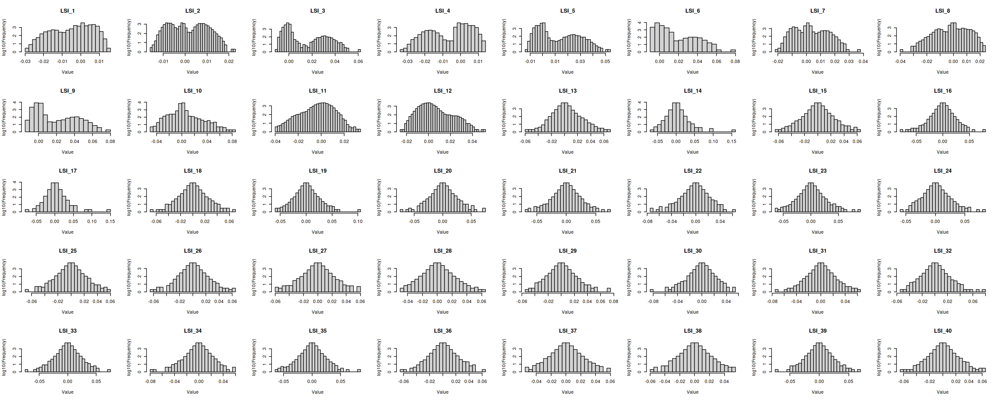

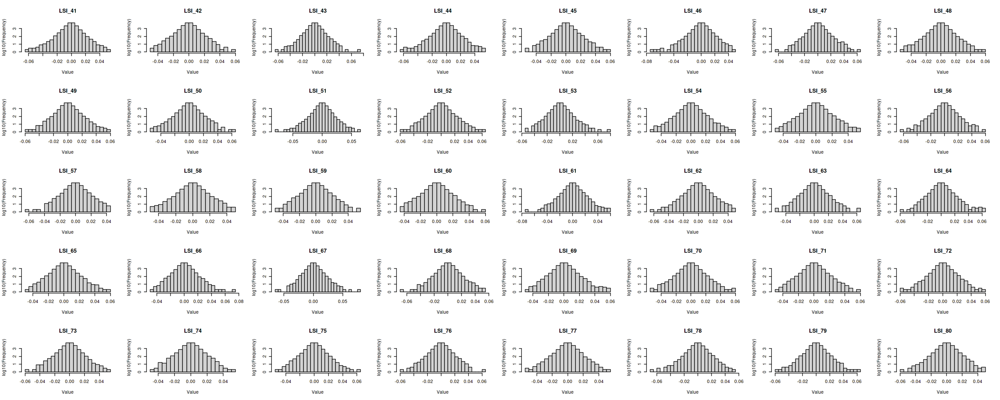

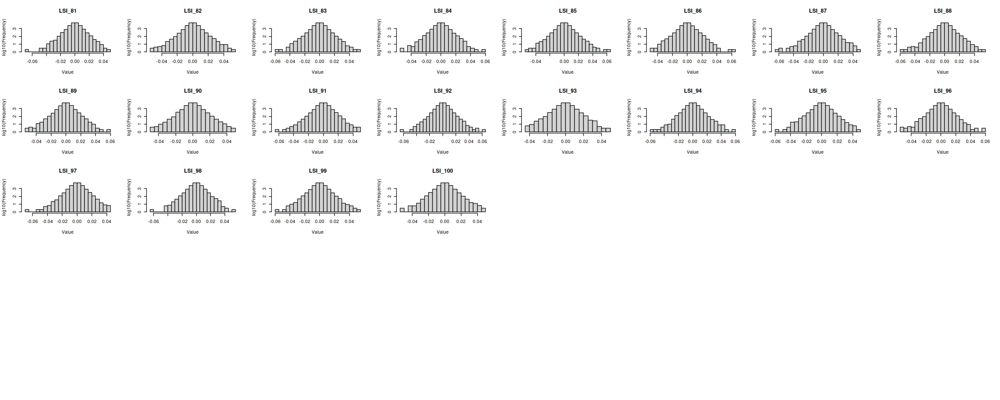

In [20]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    # spa <- h
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

[1] "SnapATAC2_jaccard"


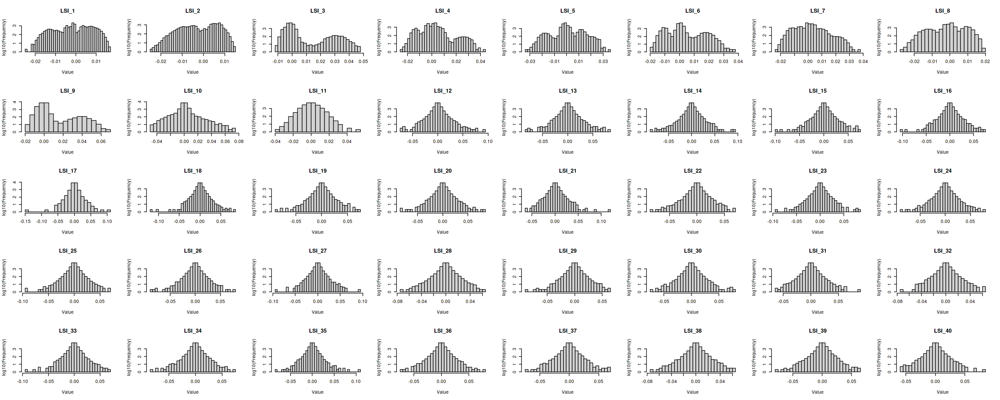

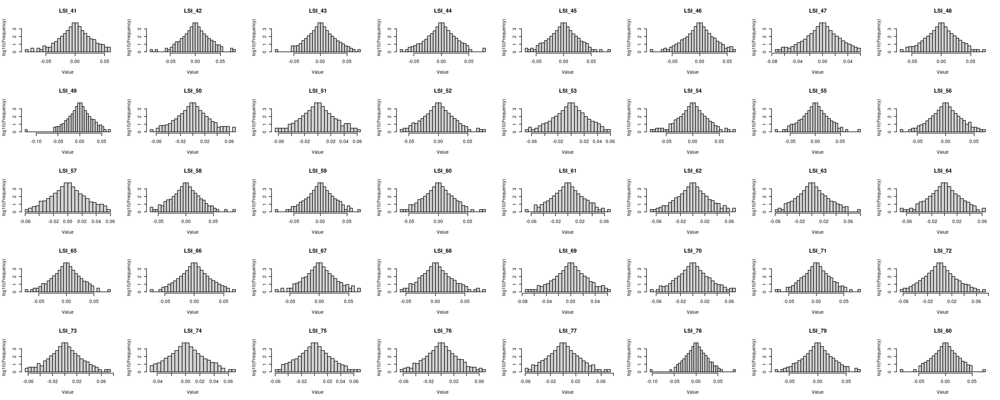

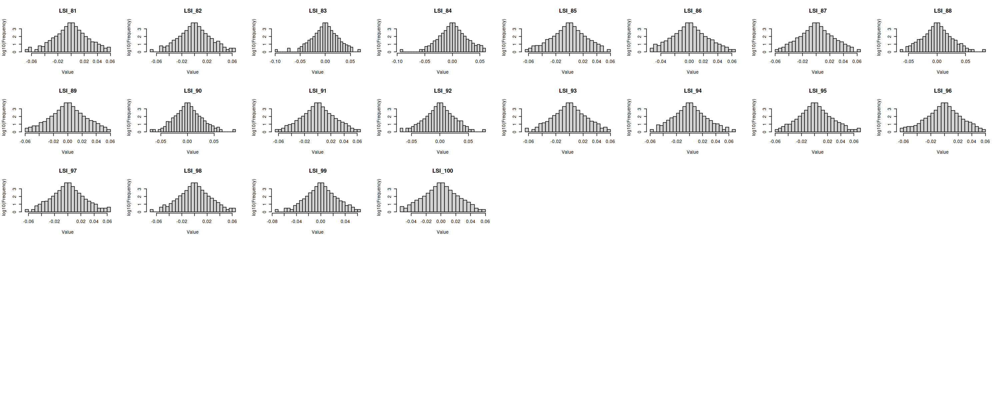

In [22]:
i <- 27
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    # spa <- h
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

In [139]:
i <- 21
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

[1] "aggregation"


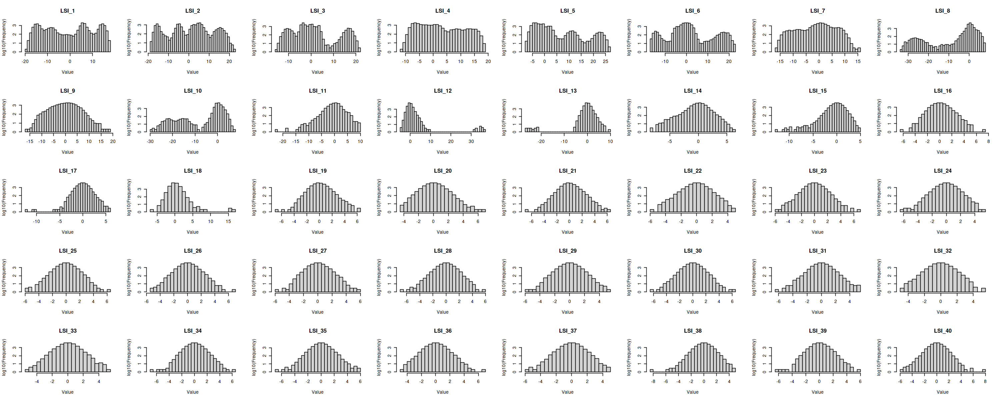

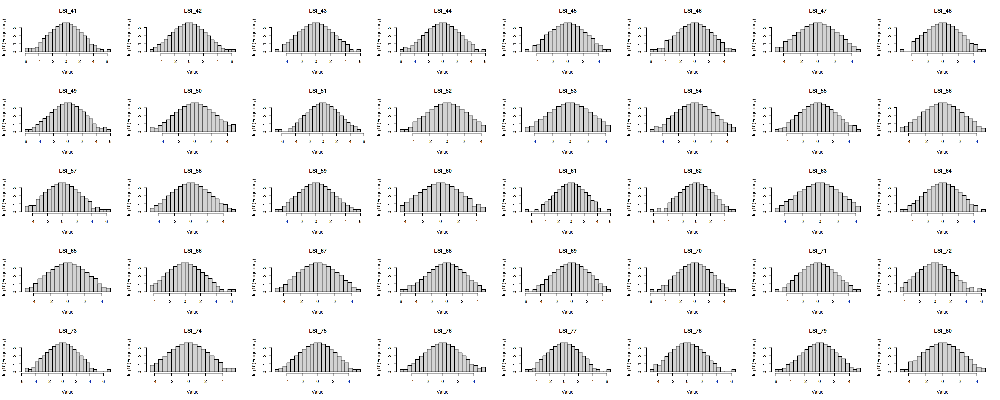

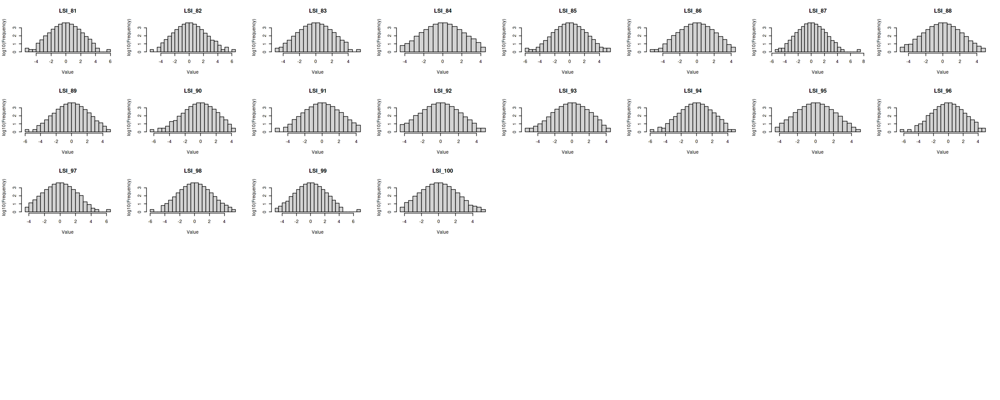

In [140]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

In [141]:
i <- 2
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

[1] "Signac_by_cluster_peaks"


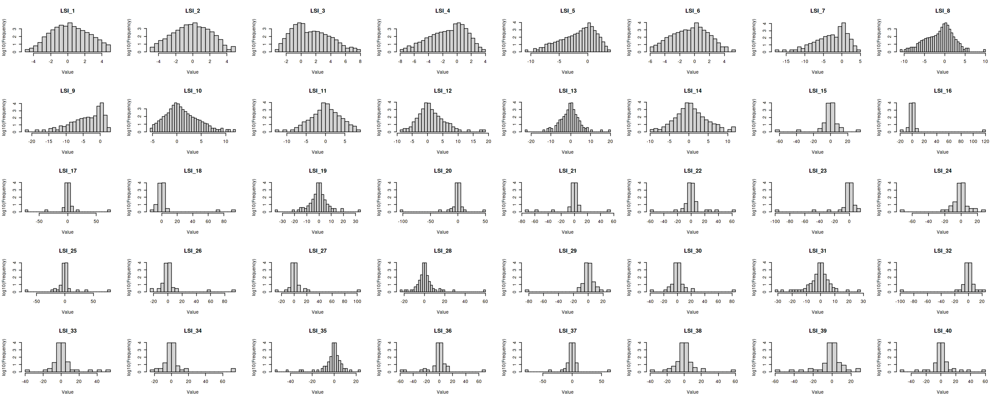

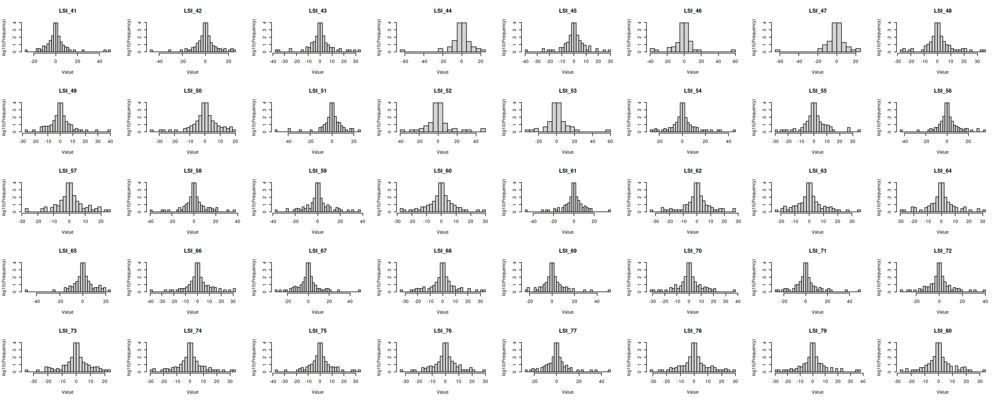

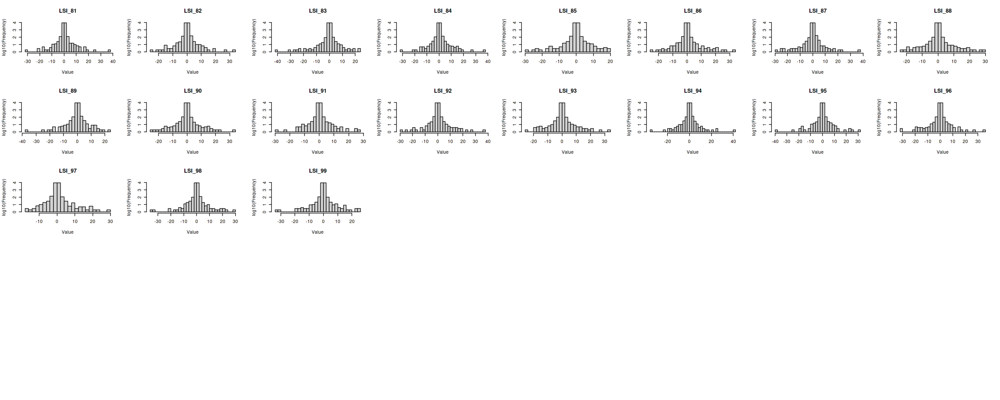

In [142]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

In [27]:
i <- 4
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

[1] "Signac_all_cell_peaks"


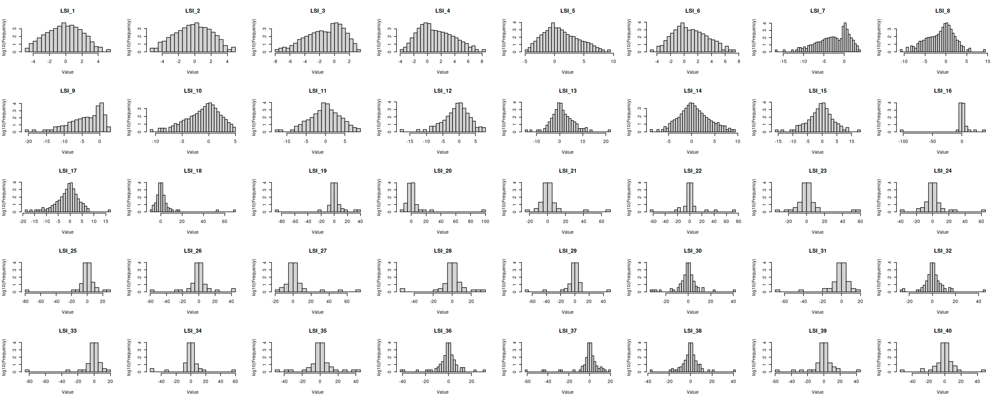

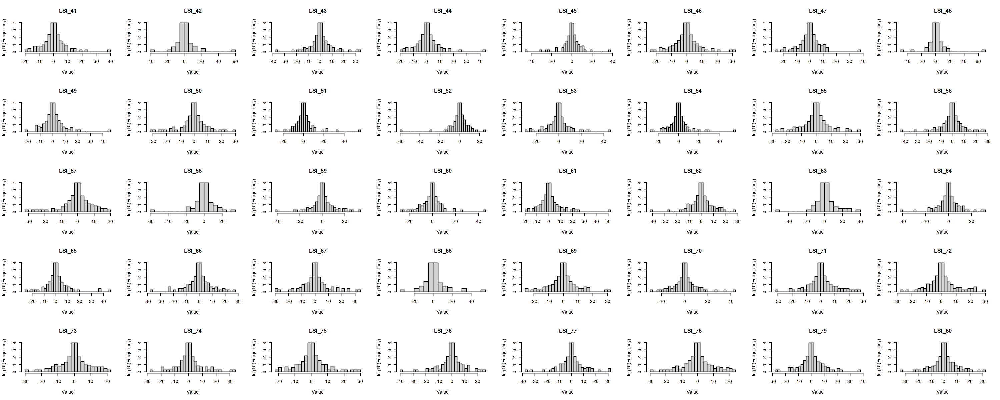

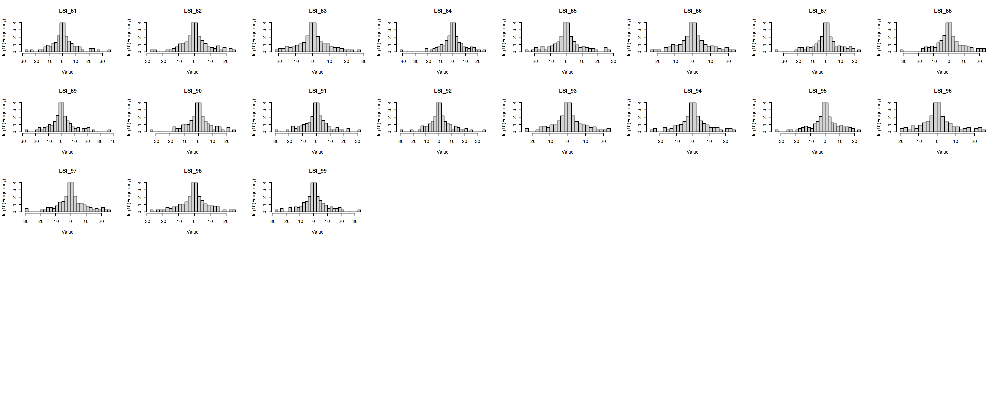

In [28]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

In [143]:
i <- 6
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

[1] "ArchR_tiles"


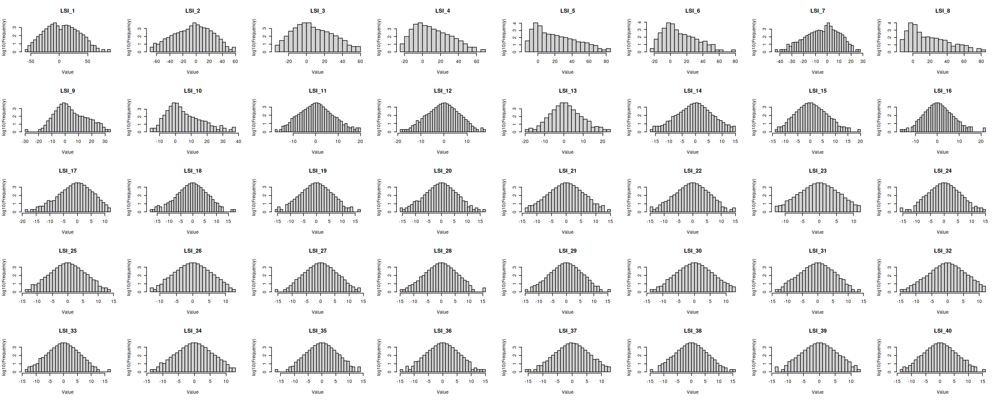

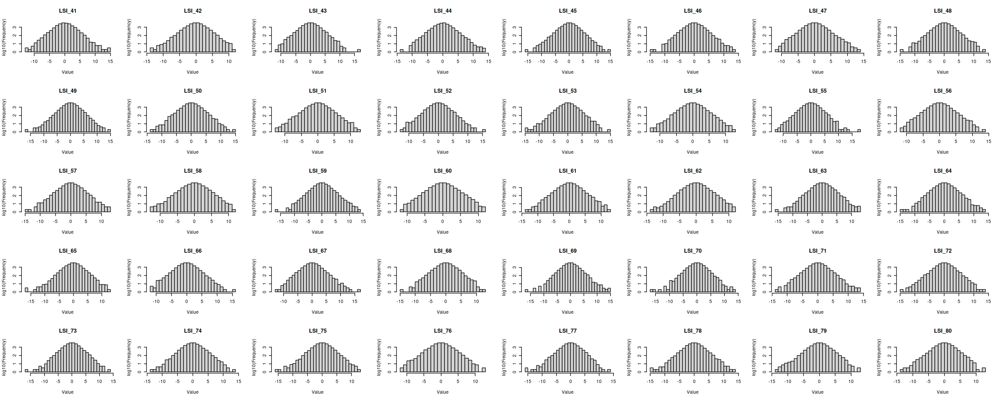

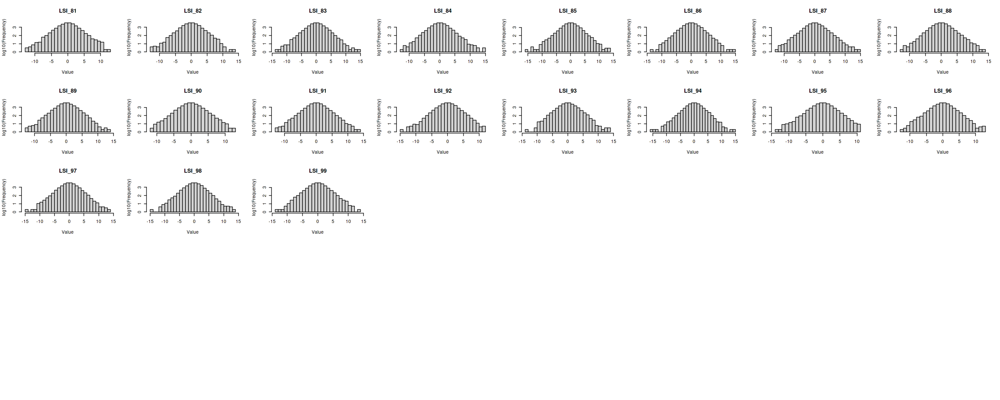

In [144]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

In [25]:
i <- 9
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

[1] "ArchR_peaks"


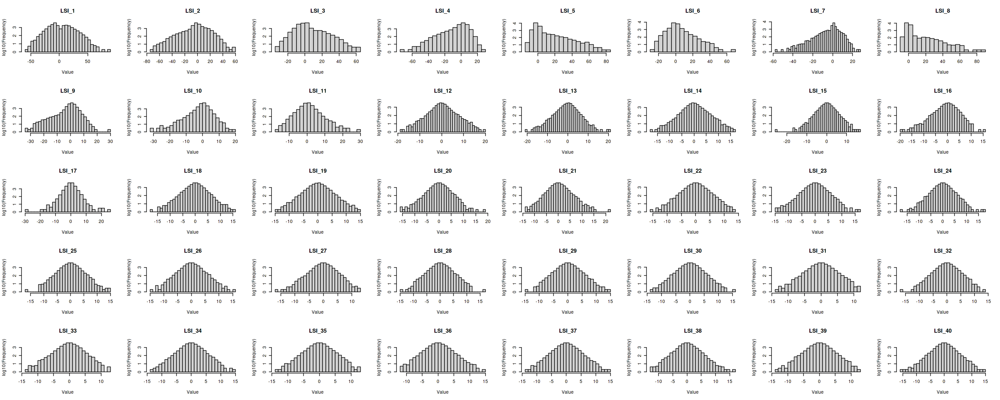

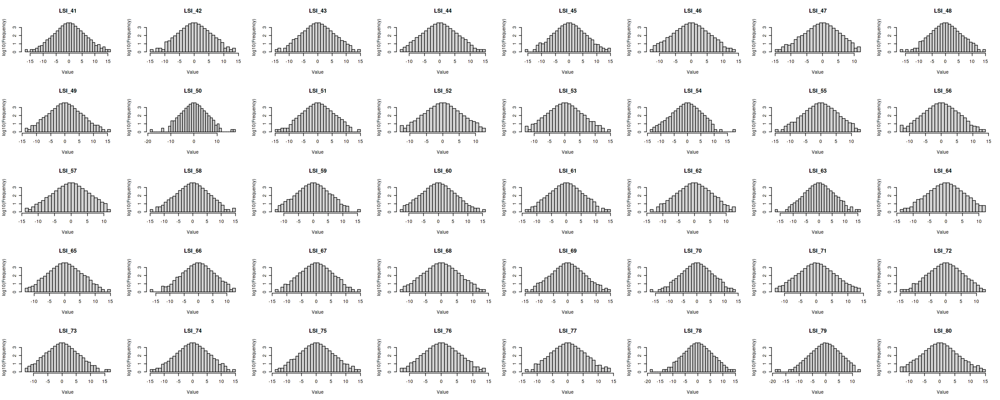

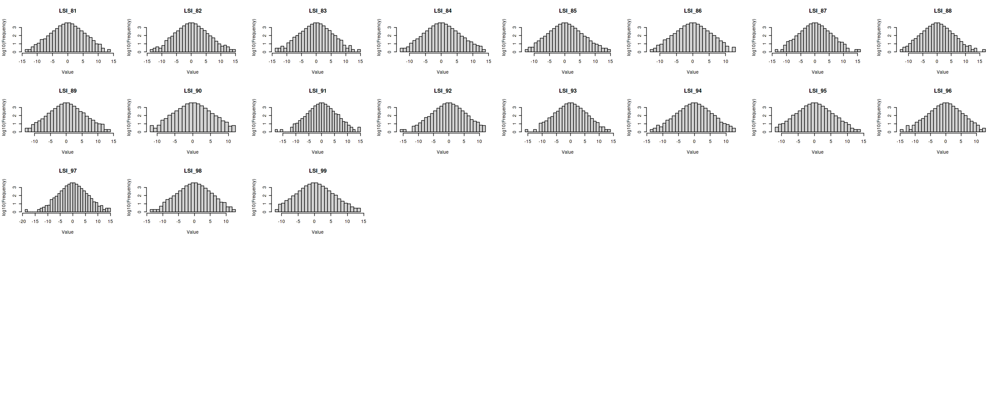

In [26]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = log10(hist.data$counts+1)
    plot(hist.data, ylab='log10(Frequency)', xlab="Value", main = col)
}

In [23]:
i <- 12
lm <- df_method[i,]$long_method
snn_file <- df_method[i,]$snn_file
sobj <- readRDS(snn_file)
x <- as.data.frame(Embeddings(Reductions(sobj, "learned_embedding")))
print(lm)

[1] "SnapATAC1"


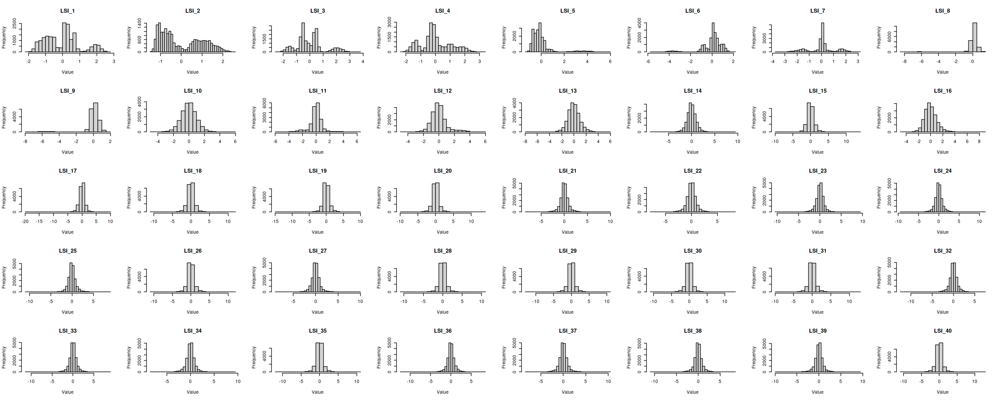

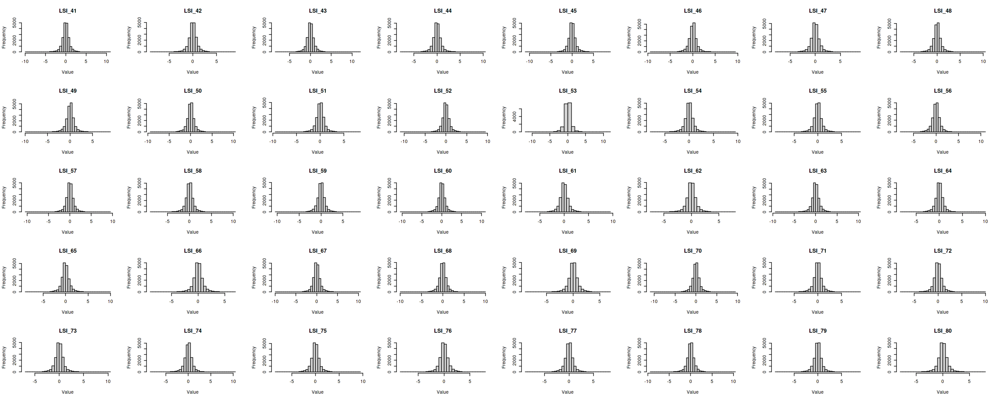

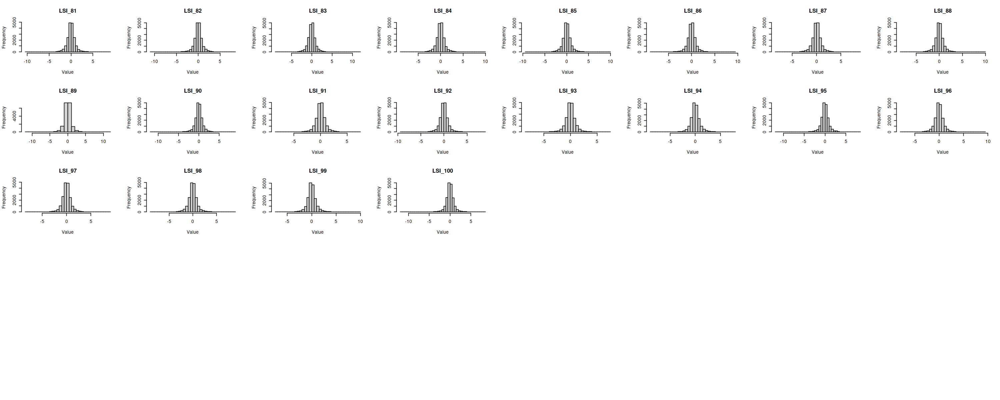

In [24]:
options(repr.plot.width=25, repr.plot.height=10)
# Set up the plotting area to show multiple histograms
par(mfrow = c(5, 8))

# Plot a histogram for each column of the dataframe
for (col in names(x)) {
    hist.data = hist(x[[col]], plot=F, breaks=30)
    hist.data$counts = hist.data$counts
    plot(hist.data, ylab='Frequency', xlab="Value", main = col)
}

ArchR and Aggregation's latent variable distribution: perhaps more Gaussian-like? ?=>? better Silhouette score?